In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
import gc
import os
import scanpy as sc
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np
import anndata

import matplotlib.colors as mcolors
import matplotlib.patches as patches

sys.path.append('TS_DEG_method/')
import DEG_comparison, GTEx_object, TS_object, figure_utils, utils


# Load all data from tissues

In [3]:
TS_data = TS_object.TS_data()
TS_tissue_adata_all = []
for tissue_ in TS_data.tissues:
    print('load TS data for organ : '+tissue_)
    TS_tissue_adata = TS_data.get_tissue_data(tissue_)
    TS_tissue_adata_all.append(TS_tissue_adata)
TS_tissue_adata_all = anndata.concat(TS_tissue_adata_all)
TS_tissue_adata_all.obs['count'] = 1
TS_tissue_adata_all

load TS data for organ : Bladder
load TS data for organ : Blood
load TS data for organ : Bone_Marrow
load TS data for organ : Ear
load TS data for organ : Eye
load TS data for organ : Fat
load TS data for organ : Heart
load TS data for organ : Kidney
load TS data for organ : Large_Intestine
load TS data for organ : Liver
load TS data for organ : Lung
load TS data for organ : Lymph_Node
load TS data for organ : Mammary
load TS data for organ : Muscle
load TS data for organ : Ovary
load TS data for organ : Pancreas
load TS data for organ : Prostate
load TS data for organ : Salivary_Gland
load TS data for organ : Skin
load TS data for organ : Small_Intestine
load TS data for organ : Spleen
load TS data for organ : Stomach
load TS data for organ : Testis
load TS data for organ : Thymus
load TS data for organ : Tongue
load TS data for organ : Trachea
load TS data for organ : Uterus
load TS data for organ : Vasculature


AnnData object with n_obs × n_vars = 1136218 × 61806
    obs: 'donor', 'tissue', 'anatomical_position', 'method', 'cdna_plate', 'library_plate', 'notes', 'cdna_well', 'old_index', 'assay', 'sample_id', 'replicate', '10X_run', '10X_barcode', 'ambient_removal', 'donor_method', 'donor_assay', 'donor_tissue', 'donor_tissue_assay', 'cell_ontology_class', 'cell_ontology_id', 'compartment', 'broad_cell_class', 'free_annotation', 'manually_annotated', 'published_2022', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ercc', 'pct_counts_ercc', '_scvi_batch', '_scvi_labels', 'scvi_leiden_donorassay_full', 'age', 'sex', 'ethnicity', 'scvi_leiden_res05_tissue', 'sample_number', 'count'
    obsm: 'X_pca', 'X_scvi', 'X_tissue_uncorrected_umap', 'X_umap', 'X_umap_tissue_scvi_donorassay'
    layers: 'decontXcounts', 'log_normalized', 'raw_counts', 'scale_data'

In [4]:
np.unique([i+'_'+j for (i,j) in zip(TS_tissue_adata_all.obs['tissue'],TS_tissue_adata_all.obs['cell_ontology_class'])]).shape

(701,)

smartseq excluded

In [5]:
TS_tissue_adata_all = TS_tissue_adata_all[TS_tissue_adata_all.obs['method']!='smartseq'].copy()
np.unique([i+'_'+j for (i,j) in zip(TS_tissue_adata_all.obs['tissue'],TS_tissue_adata_all.obs['cell_ontology_class'])]).shape


(663,)

In [6]:
TS_tissue_adata_all

AnnData object with n_obs × n_vars = 1093048 × 61806
    obs: 'donor', 'tissue', 'anatomical_position', 'method', 'cdna_plate', 'library_plate', 'notes', 'cdna_well', 'old_index', 'assay', 'sample_id', 'replicate', '10X_run', '10X_barcode', 'ambient_removal', 'donor_method', 'donor_assay', 'donor_tissue', 'donor_tissue_assay', 'cell_ontology_class', 'cell_ontology_id', 'compartment', 'broad_cell_class', 'free_annotation', 'manually_annotated', 'published_2022', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ercc', 'pct_counts_ercc', '_scvi_batch', '_scvi_labels', 'scvi_leiden_donorassay_full', 'age', 'sex', 'ethnicity', 'scvi_leiden_res05_tissue', 'sample_number', 'count'
    obsm: 'X_pca', 'X_scvi', 'X_tissue_uncorrected_umap', 'X_umap', 'X_umap_tissue_scvi_donorassay'
    layers: 'decontXcounts', 'log_normalized', 'raw_counts', 'scale_data'

# Applying contamination correction filter  (skip, input data have filtered it)

In [ ]:
TS_adata_all_filtered_obs= []
tissue_num = len(TS_data.tissues)
TSP_list = ['TSP1', 'TSP2', 'TSP3', 'TSP4', 'TSP5', 'TSP6', 'TSP7', 'TSP8', 'TSP9',
       'TSP10', 'TSP11', 'TSP12', 'TSP14', 'TSP15', 'TSP17', 'TSP19', 'TSP20',
       'TSP21', 'TSP25', 'TSP26', 'TSP27', 'TSP28', 'TSP30']

for tsp_ in TSP_list:
    print(tsp_)
    TS_tissue_adata_tsp = TS_tissue_adata_all_obs[TS_tissue_adata_all_obs['donor']==tsp_]
    print('original shape = ')
    print(TS_tissue_adata_tsp.shape)
    
    
    for i in range(0,tissue_num):
        temp_i = TS_tissue_adata_tsp[TS_tissue_adata_tsp['tissue']==TS_data.tissues[i]]
       
        for j in range(i+1,tissue_num):
            temp_j = TS_tissue_adata_tsp[TS_tissue_adata_tsp['tissue']==TS_data.tissues[j]]
            TS_tissue_adata_tsp = TS_tissue_adata_tsp[~TS_tissue_adata_tsp['10X_barcode'].isin(np.intersect1d(temp_i['10X_barcode'],temp_j['10X_barcode']))]
    
    print('tissue filtered shape = '+str(TS_tissue_adata_tsp.shape))

    run_experiments_unique = TS_tissue_adata_tsp['10X_run'].unique()
    run_experiments_unique_num = len(run_experiments_unique)
    for i in range(0,run_experiments_unique_num):
        temp_i = TS_tissue_adata_tsp[TS_tissue_adata_tsp['10X_run']==run_experiments_unique[i]]
       
        for j in range(i+1,run_experiments_unique_num):
            temp_j = TS_tissue_adata_tsp[TS_tissue_adata_tsp['10X_run']==run_experiments_unique[j]]
            TS_tissue_adata_tsp = TS_tissue_adata_tsp[~TS_tissue_adata_tsp['10X_barcode'].isin(np.intersect1d(temp_i['10X_barcode'],temp_j['10X_barcode']))]

            
    print('10x run filtered shape = '+str(TS_tissue_adata_tsp.shape))

    TS_adata_all_filtered_obs.append(TS_tissue_adata_tsp)

In [ ]:
TSP_list = ['TSP1', 'TSP2', 'TSP3', 'TSP4', 'TSP5', 'TSP6', 'TSP7', 'TSP8', 'TSP9',
       'TSP10', 'TSP11', 'TSP12', 'TSP14', 'TSP15', 'TSP17', 'TSP19', 'TSP20',
       'TSP21', 'TSP25', 'TSP26', 'TSP27', 'TSP28', 'TSP30']
for tsp_ in TSP_list:
    print(tsp_)
    barcode_overlap_tsp = pd.DataFrame(np.zeros([28,28]),columns=TS_data.tissues,index = TS_data.tissues)
    TS_tissue_adata_tsp = TS_tissue_adata_all[TS_tissue_adata_all.obs['donor']==tsp_].copy()
    tissue_num = len(TS_data.tissues)
    
    for i in range(0,tissue_num):
        temp_i = TS_tissue_adata_tsp[TS_tissue_adata_tsp.obs['tissue']==TS_data.tissues[i]]
       
        for j in range(i+1,tissue_num):
            temp_j = TS_tissue_adata_tsp[TS_tissue_adata_tsp.obs['tissue']==TS_data.tissues[j]]
            barcode_overlap_tsp.loc[TS_data.tissues[i],TS_data.tissues[j]]=len(np.intersect1d(temp_i.obs['10X_barcode'],
                                                             temp_j.obs['10X_barcode']))
            
    
    for i in range(0,tissue_num):
        for j in range(0,i+1):
            barcode_overlap_tsp.loc[TS_data.tissues[i],TS_data.tissues[j]] = np.NaN
    barcode_overlap_tsp.to_csv('barcode_overlap_tsp_'+str(tsp_)+'.csv')
    plt.figure(dpi=600,figsize=(6,6))
    sns.heatmap(barcode_overlap_tsp.transpose(),xticklabels=True, yticklabels=True)
    plt.title(tsp_)

TSP1
TSP2
TSP3
TSP4
TSP5
TSP6
TSP7
TSP8
TSP9
TSP10
TSP11
TSP12
TSP14
TSP15
TSP17
TSP19
TSP20
TSP21
TSP25
TSP26
TSP27


/tmp/ipykernel_2810234/3713380662.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


TSP28
TSP30


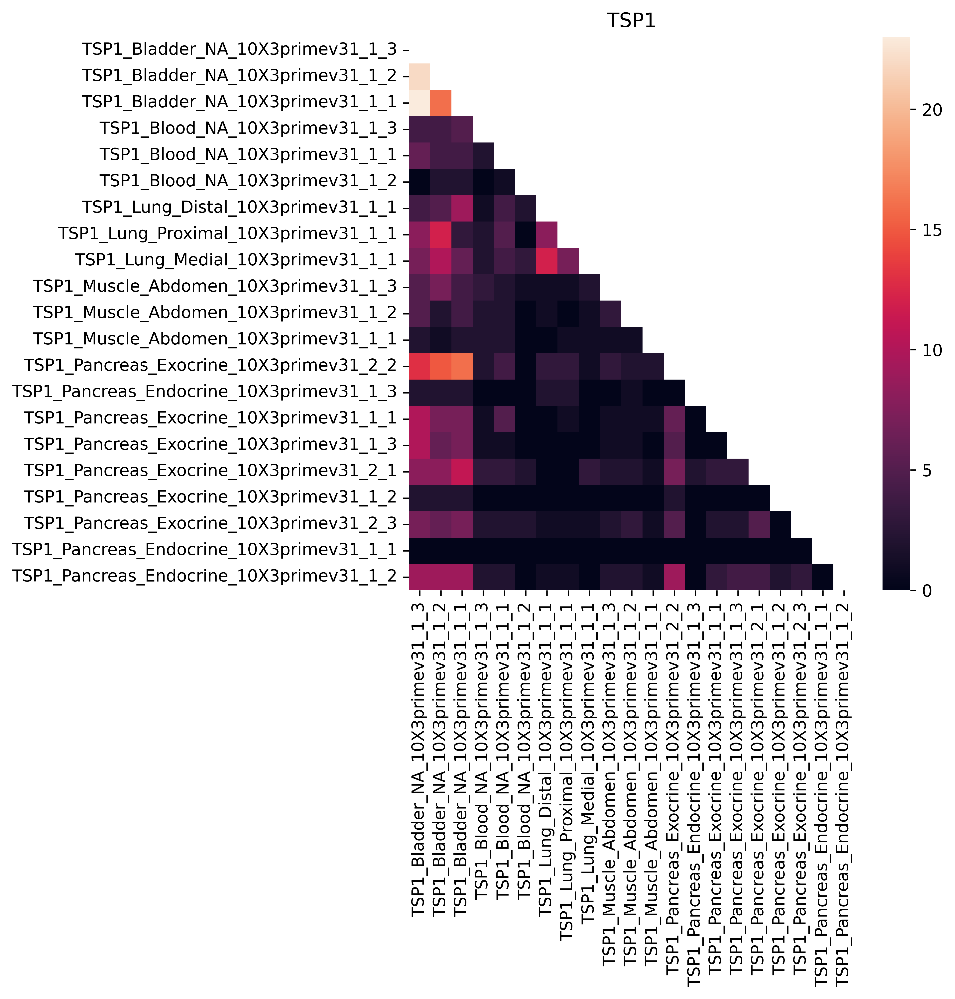

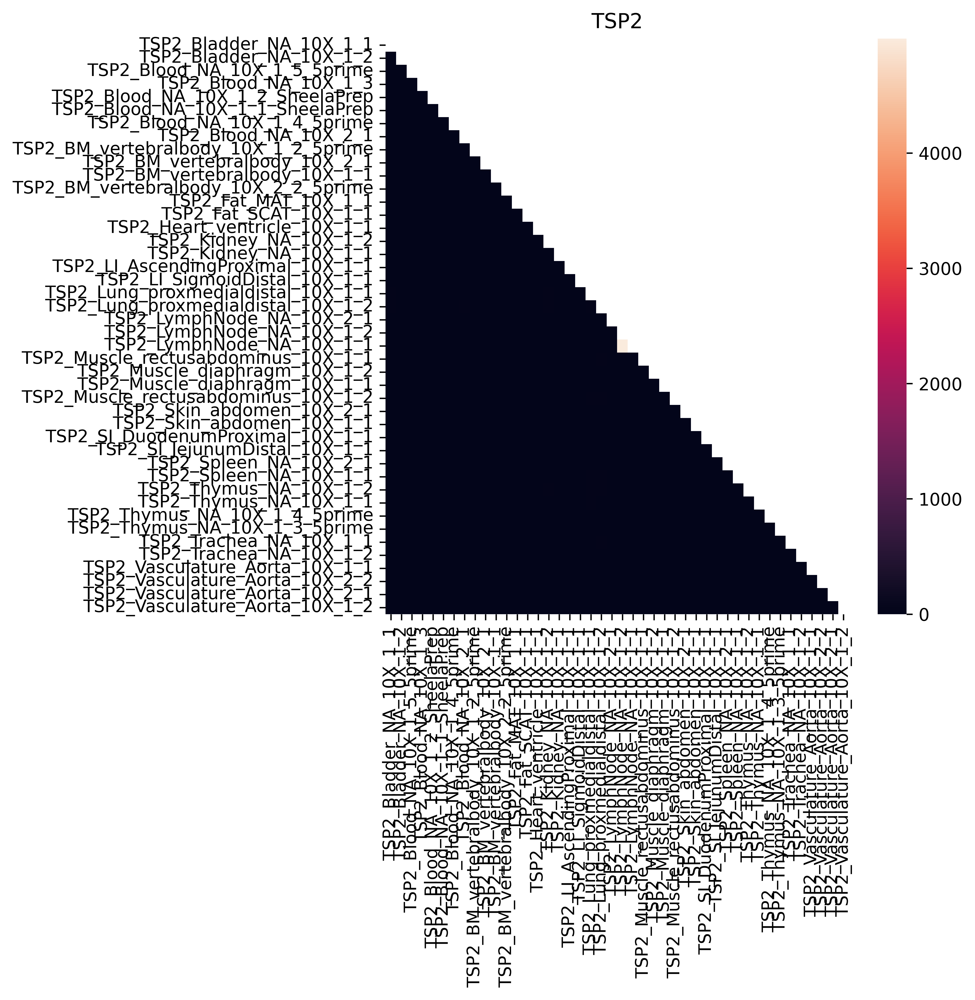

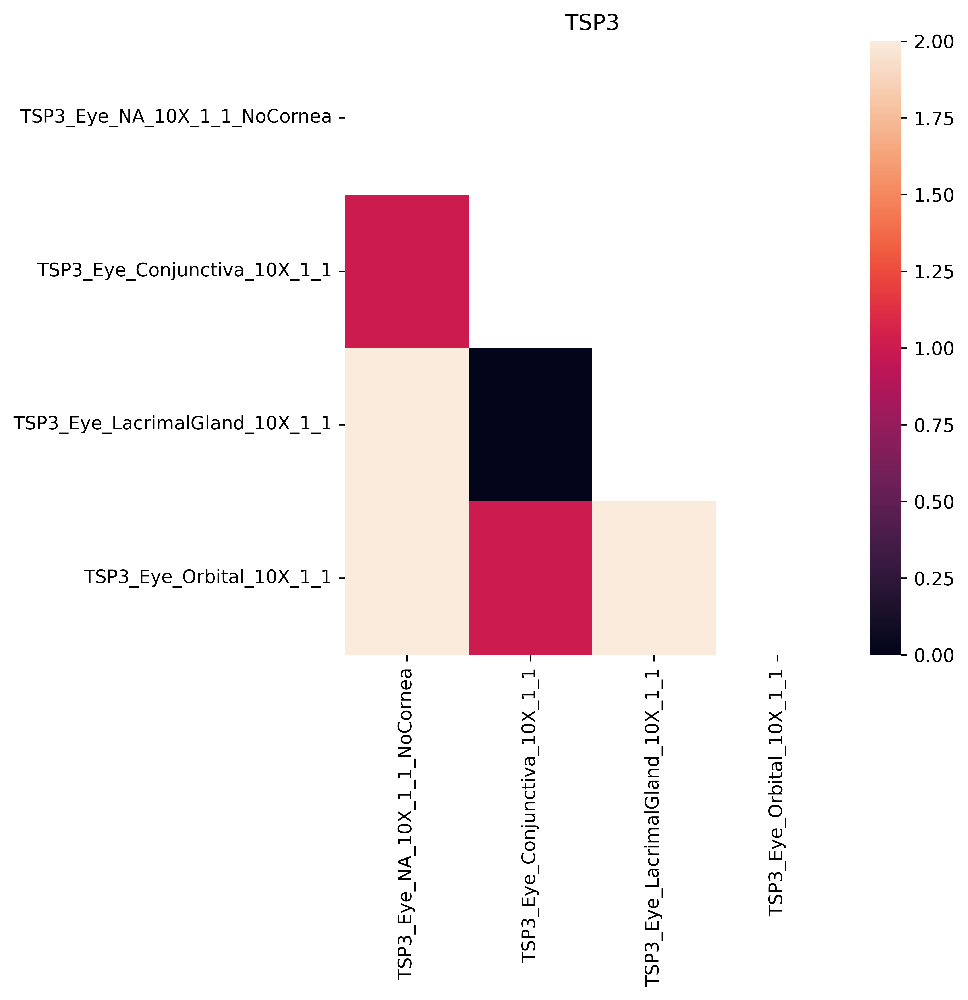

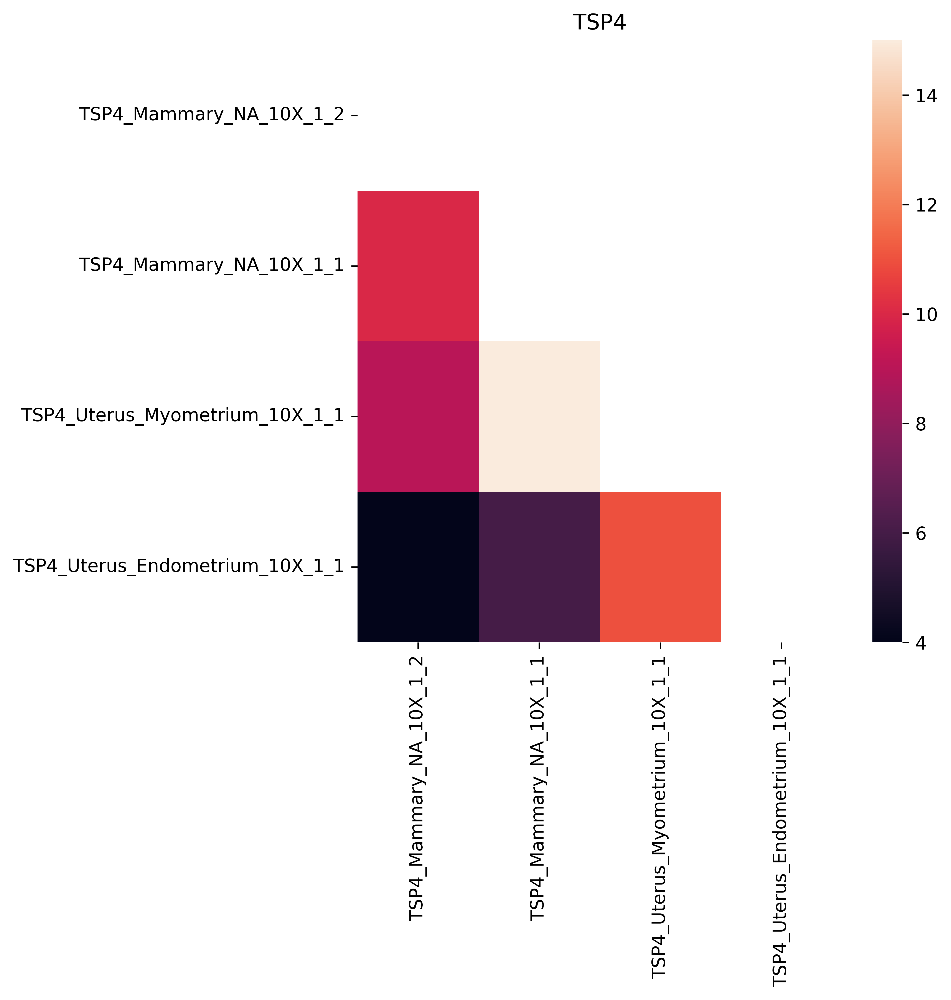

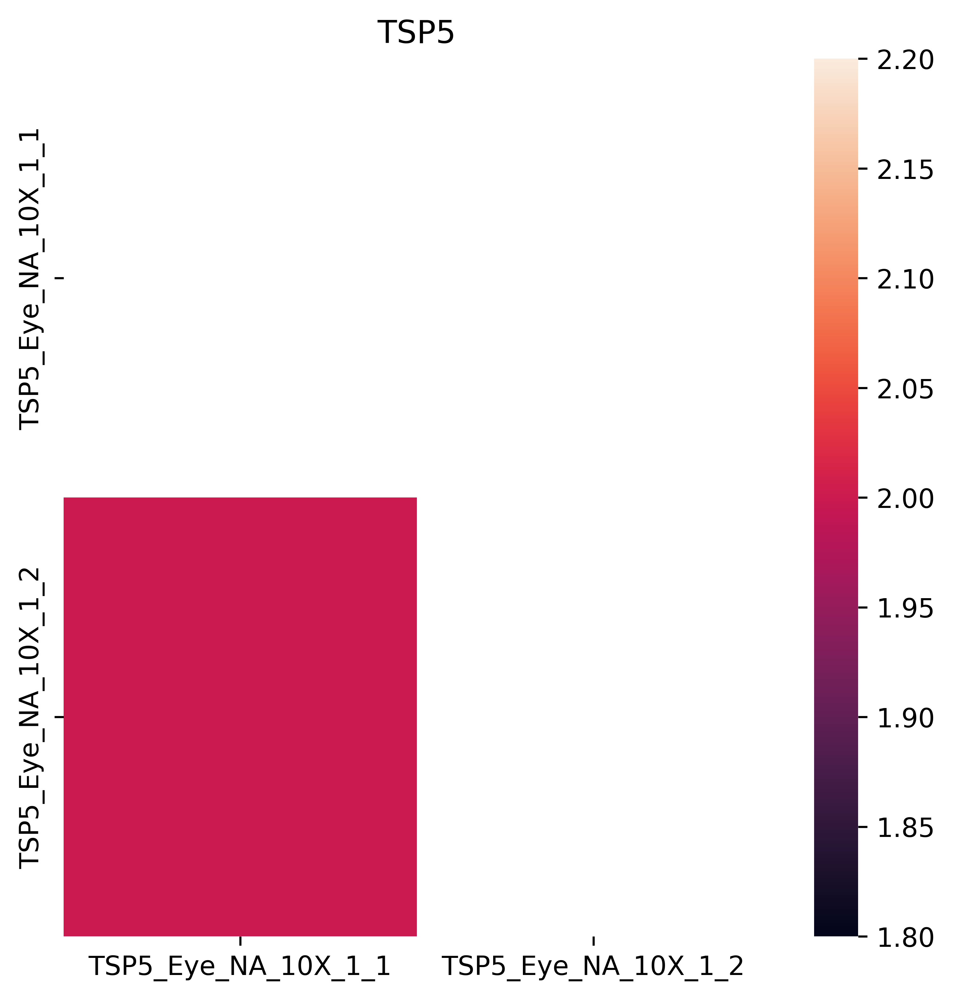

...

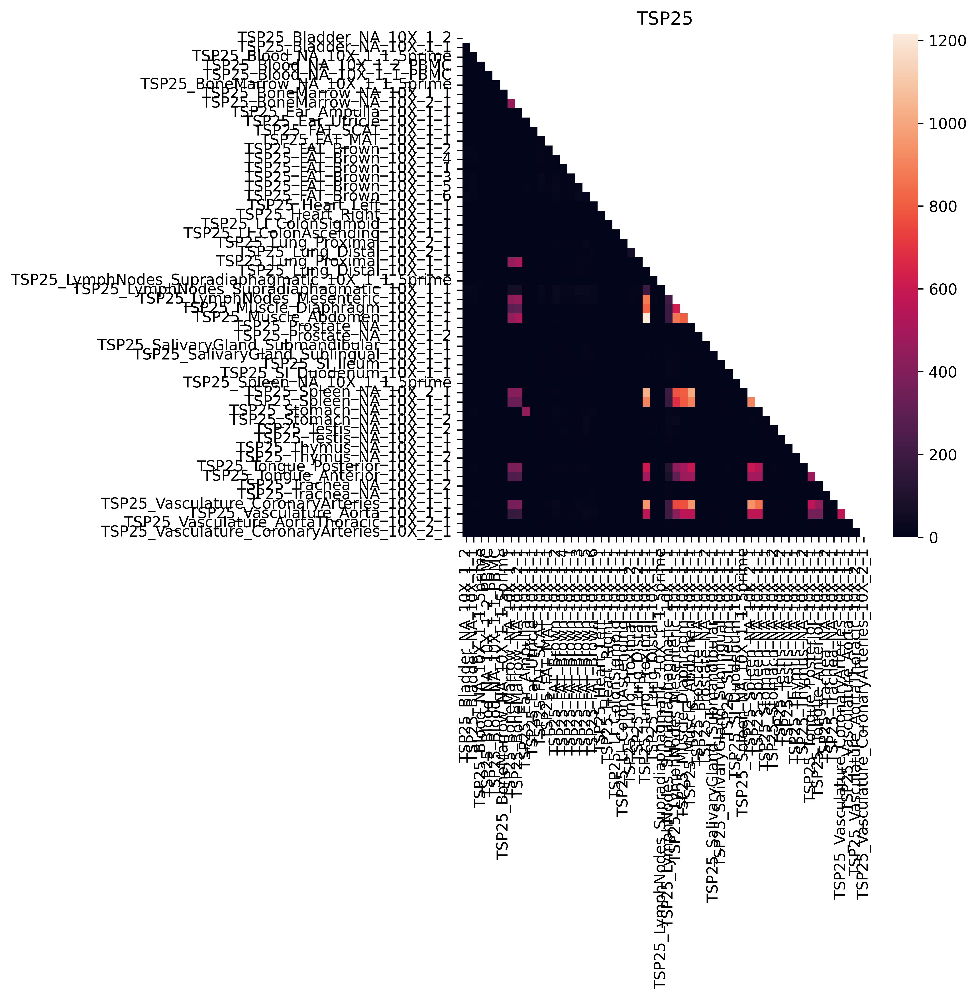

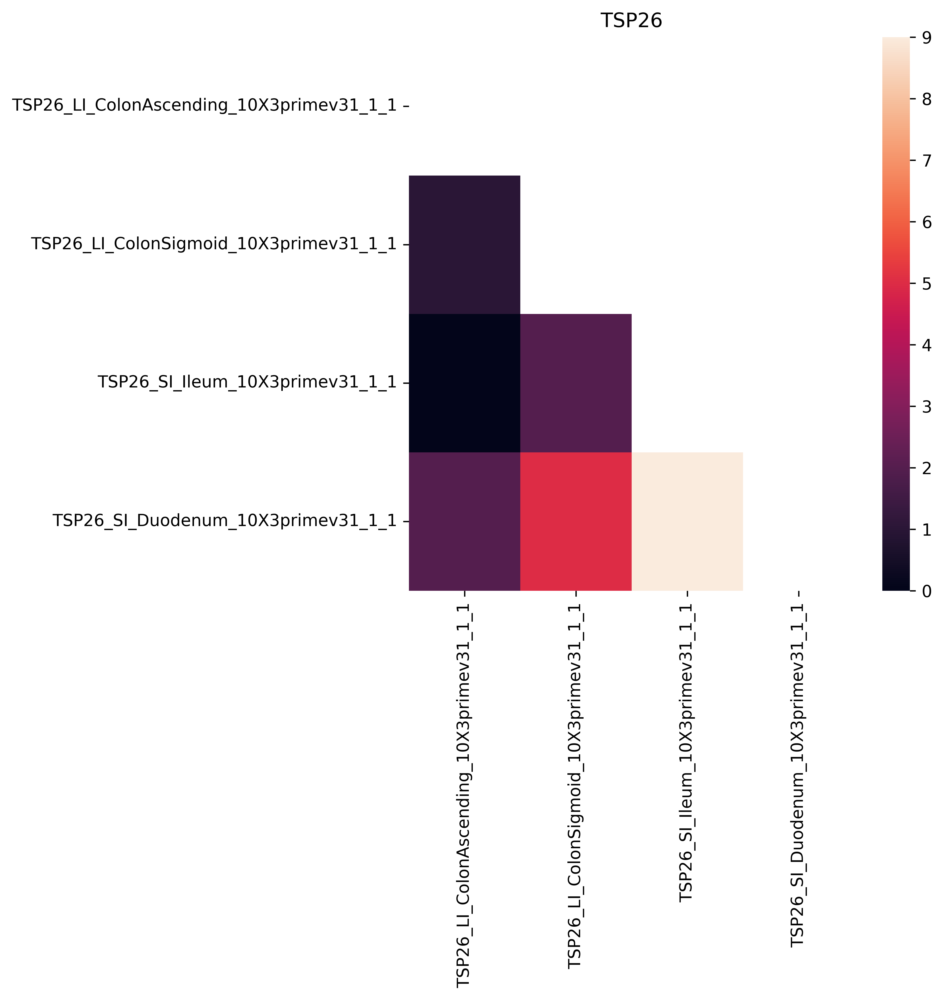

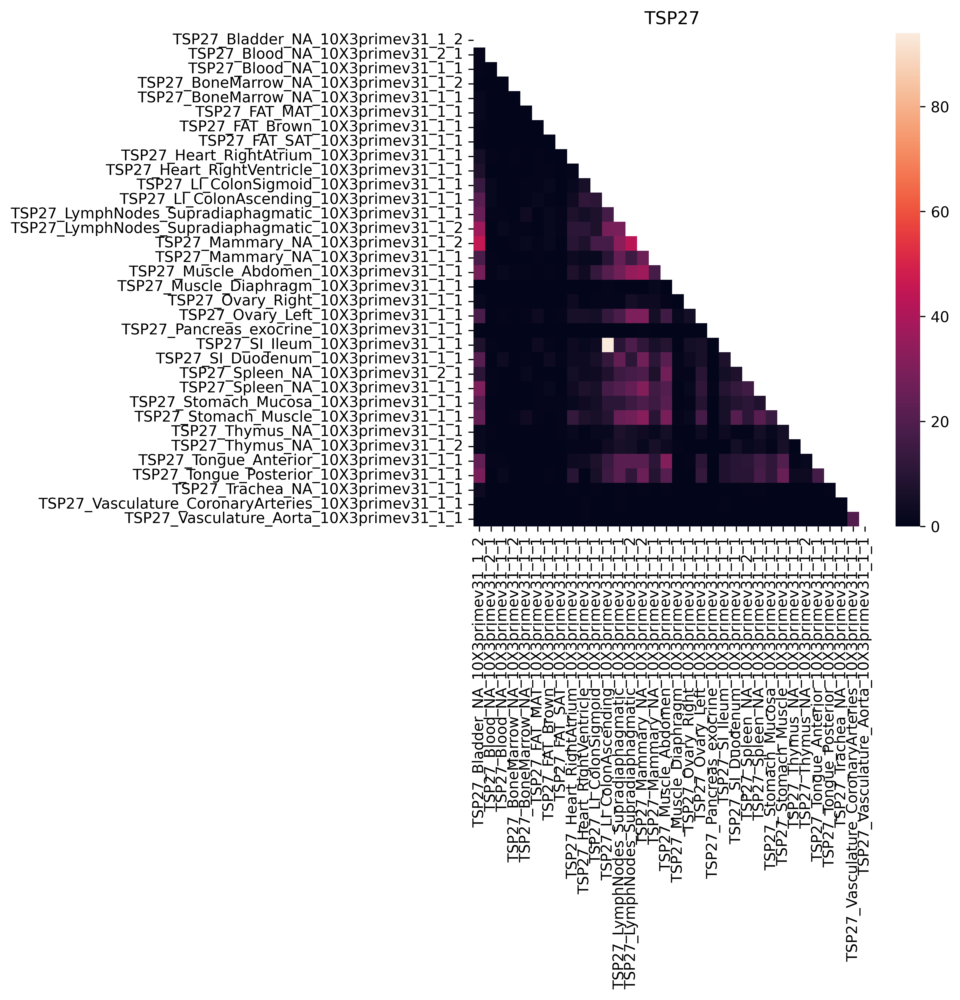

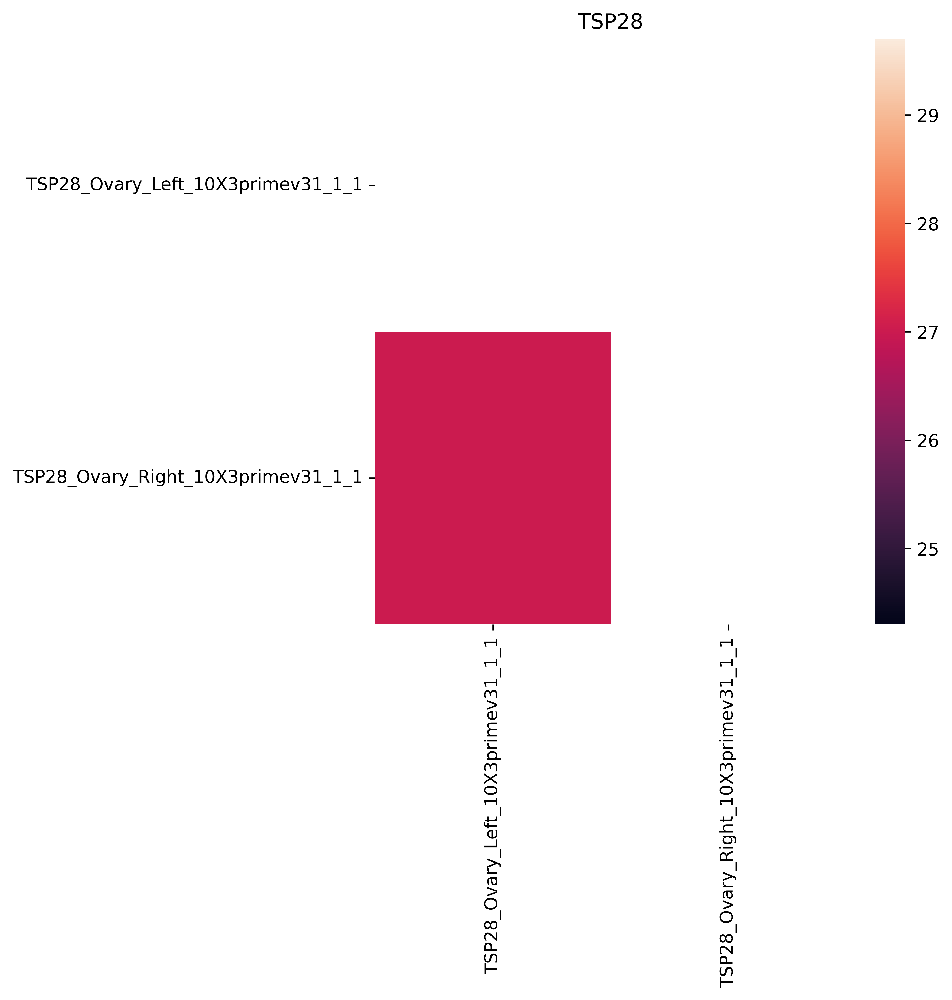

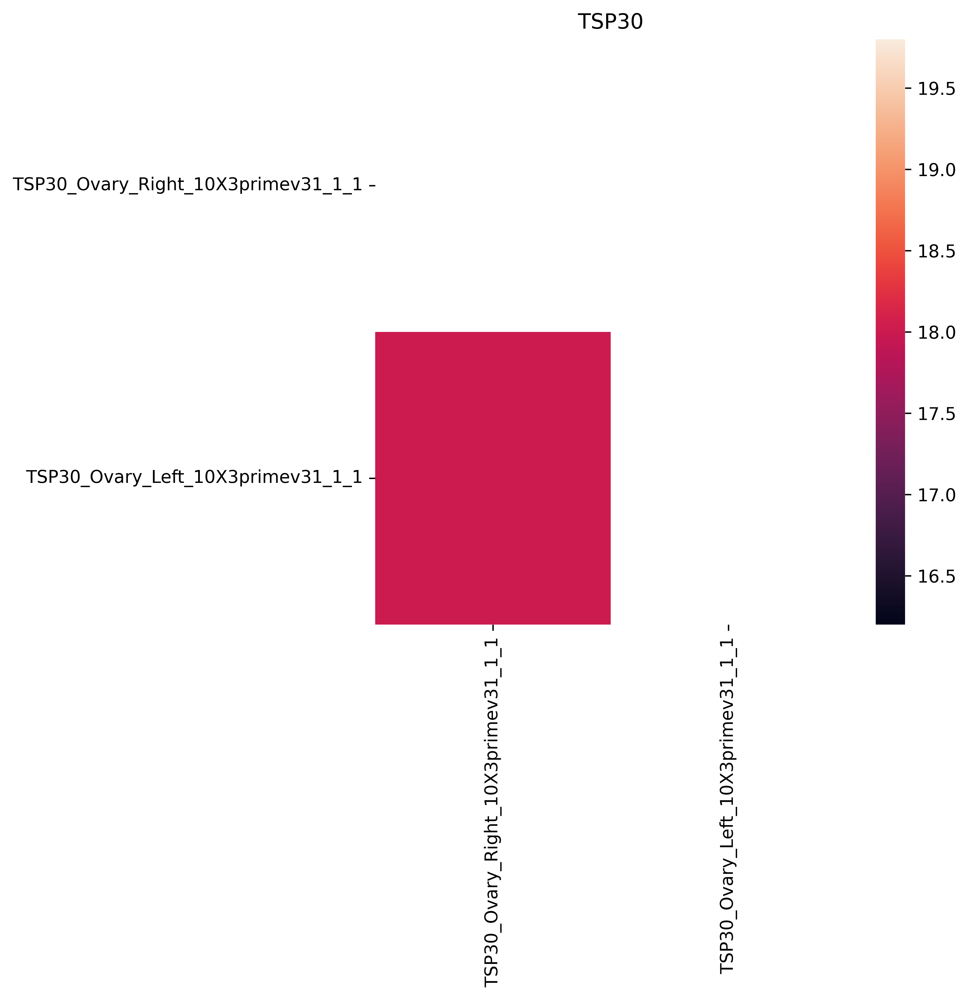

In [181]:
TSP_list = ['TSP1', 'TSP2', 'TSP3', 'TSP4', 'TSP5', 'TSP6', 'TSP7', 'TSP8', 'TSP9',
       'TSP10', 'TSP11', 'TSP12', 'TSP14', 'TSP15', 'TSP17', 'TSP19', 'TSP20',
       'TSP21', 'TSP25', 'TSP26', 'TSP27', 'TSP28', 'TSP30']
for tsp_ in TSP_list:
    print(tsp_)
    
    TS_tissue_adata_tsp = TS_tissue_adata_all[TS_tissue_adata_all.obs['donor']==tsp_].copy()
    
    
    run_experiments_unique = TS_tissue_adata_tsp.obs['10X_run'].unique()
    run_experiments_unique_num = len(run_experiments_unique)
    
    barcode_overlap_tsp = pd.DataFrame(np.zeros([run_experiments_unique_num,run_experiments_unique_num]),columns=run_experiments_unique,index =run_experiments_unique)
    for i in range(0,run_experiments_unique_num):
    
        temp_i = TS_tissue_adata_tsp[TS_tissue_adata_tsp.obs['10X_run']==run_experiments_unique[i]]
       
        for j in range(i+1,run_experiments_unique_num):
            temp_j = TS_tissue_adata_tsp[TS_tissue_adata_tsp.obs['10X_run']==run_experiments_unique[j]]
            barcode_overlap_tsp.loc[run_experiments_unique[i],run_experiments_unique[j]]=len(np.intersect1d(temp_i.obs['10X_barcode'],
                                                             temp_j.obs['10X_barcode']))
            
    
    for i in range(0,run_experiments_unique_num):
        for j in range(0,i+1):
            barcode_overlap_tsp.loc[run_experiments_unique[i],run_experiments_unique[j]] = np.NaN
    barcode_overlap_tsp.to_csv('barcode_overlap_tsp_'+str(tsp_)+'.csv')
    plt.figure(dpi=600,figsize=(6,6))
    sns.heatmap(barcode_overlap_tsp.transpose(),xticklabels=True, yticklabels=True)
    plt.title(tsp_)

In [9]:
TS_adata_all_filtered_obs = pd.concat(TS_adata_all_filtered_obs)

TS_adata_all_filtered_obs### save the index for futher usage:

In [10]:
TS_adata_all_filtered_obs.to_csv('/hpc/projects/group.quake/siyu/DATA/TS_adata_all_filtered_index.csv')

In [11]:
TS_adata_all_filtered_obs.to_csv('/hpc/mydata/siyu.he/TS_project/TS_adata_all_filtered_index.csv')

In [12]:
TS_adata_all_filtered_obs.shape

(1084151, 40)

In [13]:
TS_adata_all_orig_obs = TS_tissue_adata_all.obs

df_plot = []
for tsp_ in TSP_list:
    df_plot.append([tsp_,(TS_adata_all_orig_obs['donor']==tsp_).sum(),(TS_adata_all_filtered_obs['donor']==tsp_).sum()])
    
df_plot = pd.DataFrame(df_plot, columns=['donor','orginal_size','filtered_size'])
df_plot['deleted'] = df_plot['orginal_size']-df_plot['filtered_size']

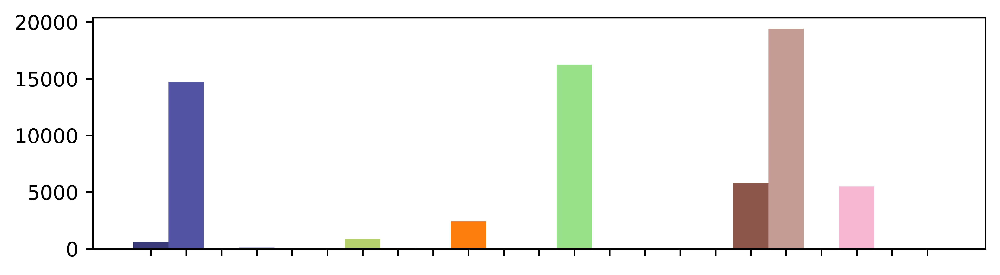

In [14]:
colors1 = sns.color_palette("tab20b", 7)
colors2 = sns.color_palette("tab20", 15)

bar_width = 1
n_bars = len(df_plot)
color_list = list(colors1+colors2)
bar_positions = range(n_bars)

hsv_colors = [(i / 17.0, 1, 1) for i in range(17)]
rgb_colors = [mcolors.hsv_to_rgb(color) for color in hsv_colors]

fig, ax = plt.subplots(figsize=(7, 2), dpi=800)

bar_width = 1
n_bars = len(df_plot)

bar_positions = range(n_bars)

# Plot bars
bars = ax.bar(bar_positions, df_plot['deleted'], width=bar_width, color =color_list)
ax.set_xticks(range(23))
ax.set_xticklabels([])
#ax.set_yticks([])

#for spine in ['top', 'left' ]:#, 'bottom']:
#    ax.spines[spine].set_visible(False)


plt.tight_layout()  
plt.show()

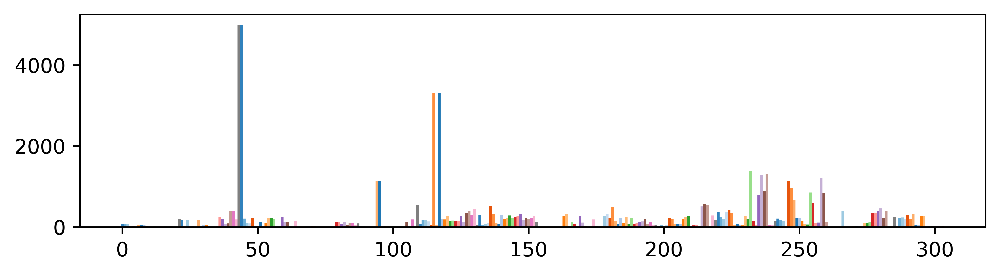

In [15]:
df_plot = []
run_experiments_unique = TS_adata_all_filtered_obs['10X_run'].unique()
run_experiments_unique_num = len(run_experiments_unique)

for run_i in range(0, run_experiments_unique_num):
    df_plot.append([tsp_,(TS_adata_all_orig_obs['10X_run']==run_experiments_unique[run_i]).sum(),
                    (TS_adata_all_filtered_obs['10X_run']==run_experiments_unique[run_i]).sum()])
    
df_plot = pd.DataFrame(df_plot, columns=['donor','orginal_size','filtered_size'])
df_plot['deleted'] = df_plot['orginal_size']-df_plot['filtered_size']

colors1 = sns.color_palette("tab20c", 7)
colors2 = sns.color_palette("tab20", 15)

bar_width = 1
n_bars = len(df_plot)
color_list = list(colors1+colors2)
bar_positions = range(n_bars)

hsv_colors = [(i / 17.0, 1, 1) for i in range(17)]
rgb_colors = [mcolors.hsv_to_rgb(color) for color in hsv_colors]

fig, ax = plt.subplots(figsize=(7, 2), dpi=800)

bar_width = 1
n_bars = len(df_plot)

bar_positions = range(n_bars)

# Plot bars
bars = ax.bar(bar_positions, df_plot['deleted'], width=bar_width, color =color_list)
#ax.set_xticks(range(23))
#ax.set_xticklabels([])
#ax.set_yticks([])

#for spine in ['top', 'left' ]:#, 'bottom']:
#    ax.spines[spine].set_visible(False)


plt.tight_layout()  
plt.show()

In [16]:
(1150192-1084151)/1084151

0.060914946349724344

# Number of cells for following analysis

In [11]:
#TS_adata_all_filtered = TS_tissue_adata_all.copy()#[TS_adata_all_filtered_obs.index]

In [7]:
df_plot = TS_tissue_adata_all.obs[['donor','count']].groupby('donor').sum()
df_plot['donor_id'] = [i.split('P')[1] for i in df_plot.index]
df_plot['donor_id'] = df_plot['donor_id'].astype(int)
df_plot = df_plot.sort_values(by='donor_id')

/tmp/ipykernel_2091420/727001611.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df_plot = TS_tissue_adata_all.obs[['donor','count']].groupby('donor').sum()


In [7]:
sex_diff_count = []
for tissue_ in TS_data.tissues:
    temp_adata = TS_tissue_adata_all[TS_tissue_adata_all.obs['tissue']==tissue_]
    for cell_type_ in temp_adata.obs['broad_cell_class'].unique():
        print(tissue_+' & '+cell_type_)
        temp_adata_ct =  temp_adata[temp_adata.obs['broad_cell_class']==cell_type_]
        temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
        if 'female' in temp_df.index:
            f_count = temp_df.loc['female','count']
        else:
            f_count = 0
        if 'male' in temp_df.index:
            m_count = temp_df.loc['male','count']
        else:
            m_count = 0
        sex_diff_count.append([tissue_,
                               cell_type_,
                               m_count,
                               f_count,
                               len(temp_adata_ct[temp_adata_ct.obs['sex']=='male'].obs['donor'].unique()),
                               len(temp_adata_ct[temp_adata_ct.obs['sex']=='female'].obs['donor'].unique()),
                              ]
                              
                             )
        
sex_diff_count = pd.DataFrame(sex_diff_count,columns=['tissue','cell type','male cell num','female cell num','male donor num','female donor num'])    

Bladder & t cell
Bladder & transitional epithelial cell
Bladder & fibroblast
Bladder & myeloid leukocyte
Bladder & contractile cell
Bladder & granulocyte


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Bladder & erythroid lineage cell
Bladder & endothelial cell
Bladder & innate lymphoid cell
Bladder & lymphocyte of b lineage
Blood & innate lymphoid cell
Blood & myeloid leukocyte


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Blood & lymphocyte of b lineage
Blood & t cell
Blood & hematopoietic cell
Blood & granulocyte
Blood & erythroid lineage cell
Blood & stem cell
Blood & dendritic cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Bone_Marrow & stem cell
Bone_Marrow & t cell
Bone_Marrow & granulocyte
Bone_Marrow & myeloid leukocyte
Bone_Marrow & dendritic cell
Bone_Marrow & hematopoietic cell
Bone_Marrow & innate lymphoid cell
Bone_Marrow & lymphocyte of b lineage
Bone_Marrow & erythroid lineage cell
Bone_Marrow & fibroblast


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Bone_Marrow & endothelial cell
Ear & stromal cell
Ear & hematopoietic cell
Ear & contractile cell
Ear & endothelial cell
Ear & melanocyte
Ear & myeloid leukocyte
Ear & t cell
Ear & granulocyte
Ear & ecto-epithelial cell
Ear & vestibular dark cell
Ear & lymphocyte of b lineage


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Eye & myeloid leukocyte
Eye & glial cell
Eye & neuron
Eye & contractile cell
Eye & erythroid lineage cell
Eye & t cell
Eye & granulocyte
Eye & endothelial cell
Eye & fibroblast
Eye & glandular epithelial cell
Eye & lymphocyte of b lineage


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Eye & conjunctival epithelial cell
Eye & innate lymphoid cell
Eye & ecto-epithelial cell
Eye & stem cell
Eye & retinal pigment epithelial cell
Fat & myeloid leukocyte


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Fat & stem cell
Fat & granulocyte
Fat & fibroblast
Fat & t cell
Fat & contractile cell
Fat & endothelial cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Fat & erythroid lineage cell
Fat & innate lymphoid cell
Fat & lymphocyte of b lineage
Fat & hematopoietic cell
Fat & dendritic cell
Heart & contractile cell
Heart & cardiac endothelial cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Heart & myeloid leukocyte
Heart & fibroblast
Heart & meso-epithelial cell
Heart & dendritic cell
Heart & innate lymphoid cell
Heart & t cell
Heart & lymphocyte of b lineage
Heart & erythroid lineage cell
Heart & neuron
Heart & granulocyte
Heart & hematopoietic cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Kidney & myeloid leukocyte
Kidney & lymphocyte of b lineage
Kidney & kidney epithelial cell
Kidney & granulocyte
Kidney & endothelial cell
Kidney & t cell
Kidney & innate lymphoid cell
Large_Intestine & intestinal epithelial cell
Large_Intestine & stem cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Large_Intestine & endothelial cell
Large_Intestine & lymphocyte of b lineage
Large_Intestine & fibroblast
Large_Intestine & t cell
Large_Intestine & glandular epithelial cell
Large_Intestine & myeloid leukocyte
Large_Intestine & granulocyte
Large_Intestine & glial cell
Large_Intestine & contractile cell
Large_Intestine & innate lymphoid cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Large_Intestine & dendritic cell
Liver & hepatocyte
Liver & t cell
Liver & myeloid leukocyte
Liver & endothelial cell
Liver & duct epithelial cell
Liver & granulocyte
Liver & erythroid lineage cell
Liver & lymphocyte of b lineage


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Liver & innate lymphoid cell
Liver & fibroblast
Liver & dendritic cell
Liver & hematopoietic cell
Lung & endothelial cell
Lung & epithelial cell
Lung & myeloid leukocyte


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Lung & epithelial cell of lung
Lung & fibroblast
Lung & t cell
Lung & granulocyte
Lung & contractile cell
Lung & endo-epithelial cell
Lung & glandular epithelial cell
Lung & lymphocyte of b lineage
Lung & ciliated epithelial cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Lung & adventitial cell
Lung & innate lymphoid cell
Lung & meso-epithelial cell
Lung & dendritic cell
Lung & secretory cell
Lymph_Node & lymphocyte of b lineage


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Lymph_Node & t cell
Lymph_Node & innate lymphoid cell
Lymph_Node & myeloid leukocyte
Lymph_Node & granulocyte
Lymph_Node & erythroid lineage cell
Lymph_Node & endothelial cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Lymph_Node & dendritic cell
Lymph_Node & stromal cell
Lymph_Node & hematopoietic cell
Mammary & t cell
Mammary & myeloid leukocyte
Mammary & duct epithelial cell
Mammary & endothelial cell
Mammary & granulocyte
Mammary & epithelial cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Mammary & fibroblast
Mammary & contractile cell
Mammary & stem cell
Mammary & lymphocyte of b lineage
Mammary & innate lymphoid cell
Muscle & contractile cell
Muscle & stem cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Muscle & granulocyte
Muscle & endothelial cell
Muscle & myeloid leukocyte
Muscle & t cell
Muscle & lymphocyte of b lineage
Muscle & stromal cell
Muscle & innate lymphoid cell
Muscle & epithelial cell
Muscle & erythroid lineage cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Ovary & stromal cell
Ovary & contractile cell
Ovary & endothelial cell
Ovary & glandular epithelial cell
Ovary & epithelial cell
Ovary & myeloid leukocyte
Ovary & meso-epithelial cell
Ovary & t cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Ovary & lymphocyte of b lineage
Ovary & granulocyte
Ovary & hematopoietic cell
Ovary & glial cell
Ovary & dendritic cell
Ovary & female germ cell
Pancreas & glandular epithelial cell
Pancreas & duct epithelial cell
Pancreas & endothelial cell
Pancreas & myeloid leukocyte


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Pancreas & fibroblast
Pancreas & t cell
Pancreas & innate lymphoid cell
Pancreas & lymphocyte of b lineage
Pancreas & granulocyte
Prostate & endothelial cell
Prostate & stem cell
Prostate & endo-epithelial cell
Prostate & fibroblast
Prostate & myeloid leukocyte


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Prostate & t cell
Prostate & contractile cell
Prostate & erythroid lineage cell
Prostate & lymphocyte of b lineage
Prostate & granulocyte
Salivary_Gland & glandular epithelial cell
Salivary_Gland & myeloid leukocyte
Salivary_Gland & duct epithelial cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Salivary_Gland & t cell
Salivary_Gland & innate lymphoid cell
Salivary_Gland & endothelial cell
Salivary_Gland & epithelial cell
Salivary_Gland & fibroblast
Salivary_Gland & contractile cell
Salivary_Gland & lymphocyte of b lineage
Salivary_Gland & meso-epithelial cell
Salivary_Gland & adventitial cell
Salivary_Gland & granulocyte


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Salivary_Gland & hematopoietic cell
Skin & granulocyte
Skin & t cell
Skin & fibroblast
Skin & myeloid leukocyte
Skin & lymphocyte of b lineage
Skin & contractile cell
Skin & endothelial cell
Skin & secretory cell
Skin & melanocyte


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Skin & innate lymphoid cell
Skin & epithelial cell
Skin & dendritic cell
Skin & erythroid lineage cell
Small_Intestine & lymphocyte of b lineage
Small_Intestine & intestinal epithelial cell
Small_Intestine & t cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Small_Intestine & myeloid leukocyte
Small_Intestine & fibroblast
Small_Intestine & stem cell
Small_Intestine & endo-epithelial cell
Small_Intestine & glandular epithelial cell
Small_Intestine & granulocyte
Small_Intestine & innate lymphoid cell
Small_Intestine & contractile cell
Small_Intestine & endothelial cell
Small_Intestine & dendritic cell
Small_Intestine & glial cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Spleen & myeloid leukocyte
Spleen & granulocyte
Spleen & lymphocyte of b lineage
Spleen & innate lymphoid cell
Spleen & t cell
Spleen & erythroid lineage cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Spleen & dendritic cell
Spleen & endothelial cell
Spleen & hematopoietic cell
Spleen & fibroblast
Stomach & lymphocyte of b lineage
Stomach & myeloid leukocyte
Stomach & epithelial cell
Stomach & ecto-epithelial cell
Stomach & fibroblast


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Stomach & granulocyte
Stomach & glandular epithelial cell
Stomach & t cell
Stomach & endothelial cell
Stomach & contractile cell
Stomach & innate lymphoid cell
Testis & male germ cell
Testis & stromal cell
Testis & secretory cell
Testis & endothelial cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Testis & meso-epithelial cell
Testis & myeloid leukocyte
Testis & t cell
Testis & granulocyte
Testis & lymphocyte of b lineage
Thymus & t cell
Thymus & fibroblast
Thymus & innate lymphoid cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Thymus & endothelial cell
Thymus & myeloid leukocyte
Thymus & contractile cell
Thymus & lymphocyte of b lineage
Thymus & granulocyte
Thymus & endo-epithelial cell
Thymus & meso-epithelial cell
Thymus & erythroid lineage cell
Thymus & hematopoietic cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Tongue & epithelial cell
Tongue & t cell
Tongue & stratified epithelial cell
Tongue & contractile cell
Tongue & endothelial cell
Tongue & granulocyte
Tongue & myeloid leukocyte
Tongue & fibroblast
Tongue & lymphocyte of b lineage


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Tongue & glial cell
Tongue & glandular epithelial cell
Tongue & innate lymphoid cell
Tongue & dendritic cell
Tongue & meso-epithelial cell
Tongue & ecto-epithelial cell
Trachea & myeloid leukocyte
Trachea & fibroblast
Trachea & ciliated epithelial cell
Trachea & secretory cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Trachea & contractile cell
Trachea & epithelial cell
Trachea & lymphocyte of b lineage
Trachea & t cell
Trachea & endothelial cell
Trachea & granulocyte
Trachea & innate lymphoid cell
Trachea & glandular epithelial cell
Trachea & dendritic cell
Trachea & connective tissue cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Uterus & fibroblast
Uterus & contractile cell
Uterus & endothelial cell
Uterus & endo-epithelial cell
Uterus & t cell
Uterus & myeloid leukocyte
Uterus & granulocyte
Uterus & ciliated epithelial cell
Uterus & innate lymphoid cell
Uterus & lymphocyte of b lineage


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

Uterus & stem cell
Vasculature & contractile cell
Vasculature & t cell
Vasculature & fibroblast
Vasculature & myeloid leukocyte
Vasculature & endothelial cell
Vasculature & granulocyte
Vasculature & lymphocyte of b lineage
Vasculature & erythroid lineage cell
Vasculature & innate lymphoid cell
Vasculature & dendritic cell


/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['sex','count']].groupby('sex').sum()
/tmp/ipykernel_1909010/2795493442.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df =  temp_adata_ct.obs[['s

In [8]:
sex_diff_count

,tissue,cell type,male cell num,female cell num,male donor num,female donor num
0,Bladder,t cell,2191,5211,2,4
1,Bladder,transitional epithelial cell,4646,22017,2,4
2,Bladder,fibroblast,3377,9892,2,4
3,Bladder,myeloid leukocyte,1122,6518,2,4
4,Bladder,contractile cell,1120,4077,2,4
...,...,...,...,...,...,...
324,Vasculature,granulocyte,1524,280,2,3
325,Vasculature,lymphocyte of b lineage,156,43,2,3
326,Vasculature,erythroid lineage cell,15,66,2,2
327,Vasculature,innate lymphoid cell,177,22,2,2


# preprocessing

In [10]:
#Low statistical power exclusion
sex_diff_count = sex_diff_count[(sex_diff_count['male donor num']>=2)&
               (sex_diff_count['female donor num']>=2) & 
               (sex_diff_count['male cell num']>=100)&
               (sex_diff_count['female cell num']>=100)
              ]
sex_diff_count.to_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/sex_diff_count.csv')

In [8]:
sex_diff_count = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/sex_diff_count.csv',index_col=0)

In [35]:
sex_diff_count = sex_diff_count[sex_diff_count.tissue!='Thymus']
sex_diff_count = sex_diff_count[sex_diff_count.tissue!='Large_Intestine']
sex_diff_count = sex_diff_count[sex_diff_count.tissue!='Lung']
sex_diff_count = sex_diff_count[sex_diff_count.tissue!='Skin']
sex_diff_count = sex_diff_count[sex_diff_count.tissue!='Small_Intestine']

In [36]:
sex_diff_count

,tissue,cell type,male cell num,female cell num,male donor num,female donor num
0,Bladder,t cell,2191,5211,2,4
1,Bladder,transitional epithelial cell,4646,22017,2,4
2,Bladder,fibroblast,3377,9892,2,4
3,Bladder,myeloid leukocyte,1122,6518,2,4
4,Bladder,contractile cell,1120,4077,2,4
...,...,...,...,...,...,...
320,Vasculature,t cell,1942,644,2,3
321,Vasculature,fibroblast,7076,5054,2,3
322,Vasculature,myeloid leukocyte,5261,2318,2,3
323,Vasculature,endothelial cell,3154,2802,2,3


This results in 114 pairs

# filter out the cells at outlies of the pca region and genes

In [13]:
gtf = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/gencode.v41.annotation.gtf', comment='#', sep='\t', header=None)
gtf_columns = ['seqname', 'source', 'feature', 'start', 'end', 'score', 'strand', 'frame', 'attribute']
gtf.columns = gtf_columns

# Extract gene name and gene type from the attributes column
gtf['gene_name'] = gtf['attribute'].str.extract('gene_name "([^"]+)"')
gtf['gene_type'] = gtf['attribute'].str.extract('gene_type "([^"]+)"')
gtf['chr'] = gtf['seqname']

gene_info_mapping = gtf[['gene_name', 'chr', 'gene_type']].drop_duplicates().set_index('gene_name')
gene_info_all = pd.DataFrame(TS_tissue_adata_all.var_names).join(gene_info_mapping, on='index')

gene_info_all.index =gene_info_all['index'] 
chrX_genes, chrY_genes = utils.get_chrXY_genes(gene_info_all)
genes_to_keep = list(chrX_genes) + list(chrY_genes)
genes_to_keep_indices = [TS_tissue_adata_all.var_names.get_loc(gene) for gene in genes_to_keep if gene in TS_tissue_adata_all.var_names]


In [42]:
adata_tissue_ct = TS_tissue_adata_all[(TS_tissue_adata_all.obs['tissue']=='Fat')&
                                           (TS_tissue_adata_all.obs['broad_cell_class']=='contractile cell')
                                          ]
anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
print(f"Anatomical positions by sex: {anatomical_pos_by_sex}")

female_pos = anatomical_pos_by_sex['female']
male_pos = anatomical_pos_by_sex['male']

# Compare the anatomical positions between female and male
common_pos = female_pos.intersection(male_pos)

# Group by 'broad_cell_class' and get the distribution of 'anatomical_position' within each class
anatomical_position_distribution = adata_tissue_ct.obs.groupby('donor')['anatomical_position'].value_counts().unstack(fill_value=0)

# Display the distribution
print(anatomical_position_distribution)

Anatomical positions by sex: sex
female    {Brown, SAT, MAT, SCAT}
male           {Brown, MAT, SCAT}
Name: anatomical_position, dtype: object


/tmp/ipykernel_804417/3908047795.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))


In [14]:
# tissue, cell type level 

for tissue_, cell_type_ in zip(sex_diff_count['tissue'],sex_diff_count['cell type']):
    if not os.path.exists('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'.h5ad'):

        print('working on tissue_..'+tissue_+' and '+cell_type_)
        adata_tissue_ct = TS_tissue_adata_all[(TS_tissue_adata_all.obs['tissue']==tissue_)&
                                           (TS_tissue_adata_all.obs['broad_cell_class']==cell_type_)
                                          ]
        

        # filter out outlies at this step
        pca_data, density, cutoff  = utils.calculate_density_contours_with_unique_variables(adata_tissue_ct.obsm['X_scvi'])
        adata_tissue_ct = adata_tissue_ct[density>cutoff]
        
        
        # check the anatomical position
        pos_ = len(adata_tissue_ct.obs['anatomical_position'].unique())
        
        
        
        if pos_>1 :
            
            
            print(f"Multiple anatomical positions found for tissue: {tissue_} and cell type: {cell_type_}. Checking sex distribution...")

            # Check anatomical positions across sex
            anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
            print(f"Anatomical positions by sex: {anatomical_pos_by_sex}")

            female_pos = anatomical_pos_by_sex['female']
            male_pos = anatomical_pos_by_sex['male']

            # Compare the anatomical positions between female and male
            common_pos = female_pos.intersection(male_pos)

            if len(common_pos) > 0:
                print(f"Using common anatomical positions: {common_pos} for tissue: {tissue_} and cell type: {cell_type_}.")

                # Filter the data to retain only the common positions
                adata_tissue_ct = adata_tissue_ct[adata_tissue_ct.obs['anatomical_position'].isin(common_pos)]
                # Check if there are at least 2 female and 2 male donors
                donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
                female_donor_count = donor_count_by_sex.get('female', 0)
                male_donor_count = donor_count_by_sex.get('male', 0)

                if female_donor_count >= 2 and male_donor_count >= 2:
                    print(f"Sufficient donors found: {female_donor_count} female donors and {male_donor_count} male donors.")
                    # Proceed with saving or further analysis
                    #adata_tissue_ct.write_h5ad(file_path)
                else:
                    print(f"Insufficient donors: {female_donor_count} female donors and {male_donor_count} male donors. Skipping this tissue and cell type.")
                    adata_tissue_ct = None
            else:
                print(f"No common anatomical positions between male and female donors for tissue: {tissue_} and cell type: {cell_type_}.")
                
                adata_tissue_ct = None

        if adata_tissue_ct is not None:

            adata_donor_all = []

            for donor_ in sorted(adata_tissue_ct.obs['donor'].unique()):
                TS_tissue_ct_donor = adata_tissue_ct[adata_tissue_ct.obs['donor']==donor_]

                # set minimium of cell for each donor to be 50
                if TS_tissue_ct_donor.shape[0]<50:
                    print('cell number in donor '+donor_+' < 50')
                else:
                    print('working on donor..'+donor_)

                    sampled_indices = np.random.choice(TS_tissue_ct_donor.shape[0], size=500, replace=True)
                    TS_tissue_ct_donor = TS_tissue_ct_donor[sampled_indices].copy()
                    print(TS_tissue_ct_donor.shape)
                    # cluster donor specific data
                    sc.pp.neighbors(TS_tissue_ct_donor, n_neighbors=30, n_pcs=50, use_rep='X_scvi')
                    sc.tl.leiden(TS_tissue_ct_donor,resolution=0.8)
                    
                    print('leiden number = ')
                    print(len(TS_tissue_ct_donor.obs['leiden'].unique()))

                    new_dataset = anndata.AnnData(TS_tissue_ct_donor.layers['decontXcounts'],dtype=TS_tissue_ct_donor.layers['decontXcounts'].dtype)

                    new_dataset.obs_names = TS_tissue_ct_donor.obs_names
                    new_dataset.var_names = TS_tissue_ct_donor.var_names
                    new_dataset.obs['donor'] = TS_tissue_ct_donor.obs['donor']
                    new_dataset.obs['tissue'] = TS_tissue_ct_donor.obs['tissue']
                    new_dataset.obs['age'] = TS_tissue_ct_donor.obs['age']
                    new_dataset.obs['sex'] = TS_tissue_ct_donor.obs['sex']
                    new_dataset.obs['ethnicity'] = TS_tissue_ct_donor.obs['ethnicity']
                    new_dataset.obs['leiden'] = TS_tissue_ct_donor.obs['leiden']
                    new_dataset.obs['broad_cell_class'] = cell_type_
                    new_dataset.obs['cluster'] = new_dataset.obs['sex'].astype(str) + '_' + new_dataset.obs['donor'].astype(str) + '_'  + new_dataset.obs['leiden'].astype(str)


                    # Calculate the filter mask
                    min_cells = int(new_dataset.shape[0] * 0.1)
                    gene_mask = np.array((new_dataset.X > 0).sum(axis=0)).flatten() >= min_cells

                    # Ensure genes_to_keep are not filtered out
                    for idx in genes_to_keep_indices:
                        gene_mask[idx] = True

                    # Apply the mask to filter the genes
                    new_dataset = new_dataset[:, gene_mask]
                    adata_donor_all.append(new_dataset)

            if len(adata_donor_all)>0:
                print('saving...')
                adata_donor_all = anndata.concat(adata_donor_all)
                adata_donor_all.write('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'.h5ad')

working on tissue_..Bladder and t cell
working on donor..TSP1
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:77: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(TS_tissue_ct_donor,resolution=0.8)
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, 

leiden number = 
9
working on donor..TSP14
(500, 61806)
leiden number = 
11
working on donor..TSP2
(500, 61806)
leiden number = 
9
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

(500, 61806)
leiden number = 
8
working on donor..TSP25
(500, 61806)
leiden number = 
10
working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
14
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Bladder and transitional epithelial cell
working on donor..TSP1
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
9
working on donor..TSP14
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
9
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
9
working on donor..TSP21
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
7
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
8
working on donor..TSP27
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
9
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Bladder and fibroblast
working on donor..TSP1
(500, 61806)
leiden number = 
7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP14
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
working on donor..TSP21
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
9
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
9
working on donor..TSP27
(500, 61806)
leiden number = 
8
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Bladder and myeloid leukocyte
working on donor..TSP1
(500, 61806)
leiden number = 
10
working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
9
working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
9
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
9
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
10
working on donor..TSP27
(500, 61806)
leiden number = 
11
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Bladder and contractile cell
working on donor..TSP1
(500, 61806)
leiden number = 
9
working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
10
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
working on donor..TSP21
(500, 61806)
leiden number = 
12


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27
(500, 61806)
leiden number = 
21
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Bladder and granulocyte
working on donor..TSP1
(500, 61806)
leiden number = 
8
working on donor..TSP14
(500, 61806)
leiden number = 
16


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
(500, 61806)
leiden number = 
11
cell number in donor TSP21 < 50
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
12
cell number in donor TSP27 < 50
saving...
working on tissue_..Bladder and endothelial cell
working on donor..TSP1


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

(500, 61806)
leiden number = 
14
cell number in donor TSP14 < 50
working on donor..TSP2
(500, 61806)
leiden number = 
22
working on donor..TSP21
(500, 61806)
leiden number = 
30
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

(500, 61806)
leiden number = 
26
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Blood and innate lymphoid cell
working on donor..TSP1
(500, 61806)
leiden number = 
28
working on donor..TSP10
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
13
working on donor..TSP14
(500, 61806)
leiden number = 
32
working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

(500, 61806)
leiden number = 
15
working on donor..TSP21
(500, 61806)
leiden number = 
13
working on donor..TSP25
(500, 61806)
leiden number = 
13


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


cell number in donor TSP27 < 50
working on donor..TSP7
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


cell number in donor TSP8 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Blood and myeloid leukocyte
working on donor..TSP1
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
11
working on donor..TSP10
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
9
working on donor..TSP14
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
11
working on donor..TSP2
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP21
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP25
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


cell number in donor TSP27 < 50
working on donor..TSP7
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP8
(500, 61806)
leiden number = 
16
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Blood and lymphocyte of b lineage
working on donor..TSP1
(500, 61806)
leiden number = 
13
working on donor..TSP10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
12
working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
13
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
12
working on donor..TSP21
(500, 61806)
leiden number = 
14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
10
cell number in donor TSP27 < 50
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
10
working on donor..TSP8
(500, 61806)
leiden number = 
29
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Blood and t cell
working on donor..TSP1
(500, 61806)
leiden number = 
11
working on donor..TSP10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
10
working on donor..TSP14
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
17
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
working on donor..TSP21
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP25
(500, 61806)
leiden number = 
10
cell number in donor TSP27 < 50
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
31
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Blood and hematopoietic cell
cell number in donor TSP1 < 50
cell number in donor TSP10 < 50
working on donor..TSP14
(500, 61806)
leiden number = 
37
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
24
working on donor..TSP21
(500, 61806)
leiden number = 
18
cell number in donor TSP25 < 50
cell number in donor TSP27 < 50
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
25
cell number in donor TSP8 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Blood and granulocyte
working on donor..TSP1
(500, 61806)
leiden number = 
10
working on donor..TSP10
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
13
working on donor..TSP14
(500, 61806)
leiden number = 
11
cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
working on donor..TSP25
(500, 61806)
leiden number = 
15
cell number in donor TSP27 < 50
working on donor..TSP7
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
working on donor..TSP8
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
9
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Blood and erythroid lineage cell
working on donor..TSP1
(500, 61806)
leiden number = 
24
working on donor..TSP10
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
working on donor..TSP14
(500, 61806)
leiden number = 
10
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
11
working on donor..TSP21
(500, 61806)
leiden number = 
14
working on donor..TSP27
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
12
working on donor..TSP7
(500, 61806)
leiden number = 
10
cell number in donor TSP8 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

working on tissue_..Bone_Marrow and stem cell
working on donor..TSP11
(500, 61806)
leiden number = 
22
working on donor..TSP14
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
11
working on donor..TSP21
(500, 61806)
leiden number = 
18


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
15
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Bone_Marrow and t cell
working on donor..TSP11
(500, 61806)
leiden number = 
11
working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
working on donor..TSP21
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP25
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


cell number in donor TSP27 < 50
saving...
working on tissue_..Bone_Marrow and granulocyte
cell number in donor TSP11 < 50
working on donor..TSP14
(500, 61806)
leiden number = 
11
cell number in donor TSP2 < 50
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
13
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
11
working on donor..TSP27
(500, 61806)
leiden number = 
14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...
working on tissue_..Bone_Marrow and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP11
(500, 61806)
leiden number = 
14
working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

(500, 61806)
leiden number = 
11
working on donor..TSP2
(500, 61806)
leiden number = 
11
working on donor..TSP21
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
11
working on donor..TSP25
(500, 61806)
leiden number = 
14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Bone_Marrow and hematopoietic cell
working on donor..TSP11
(500, 61806)
leiden number = 
35


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP14
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
(500, 61806)
leiden number = 
16
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
22
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
10
working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
22
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Bone_Marrow and innate lymphoid cell
working on donor..TSP11
(500, 61806)
leiden number = 
32
working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
14
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
working on donor..TSP21
(500, 61806)
leiden number = 
26
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

(500, 61806)
leiden number = 
33
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Bone_Marrow and lymphocyte of b lineage
working on donor..TSP11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
13
working on donor..TSP14
(500, 61806)
leiden number = 
14
working on donor..TSP2
(500, 61806)
leiden number = 
11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
11
working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
42
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Fat and myeloid leukocyte
Multiple anatomical positions found for tissue: Fat and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {MAT, SCAT, Brown}
male      {MAT, SCAT, Brown}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'MAT', 'SCAT', 'Brown'} for tissue: Fat and cell type: myeloid leukocyte.
Sufficient donors found: 3 female donors and 3 male donors.
working on donor..TSP10
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
9
working on donor..TSP14
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
9
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
8
working on donor..TSP27
(500, 61806)
leiden number = 
15


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Fat and stem cell
Multiple anatomical positions found for tissue: Fat and cell type: stem cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {MAT, SCAT, Brown}
male      {MAT, SCAT, Brown}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'MAT', 'SCAT', 'Brown'} for tissue: Fat and cell type: stem cell.
Sufficient donors found: 3 female donors and 3 male donors.
working on donor..TSP10
(500, 61806)
leiden number = 
28
working on donor..TSP14


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

(500, 61806)
leiden number = 
15
cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)
leiden number = 
10
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
9
working on donor..TSP27
(500, 61806)
leiden number = 
30
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Fat and granulocyte
Multiple anatomical positions found for tissue: Fat and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {MAT, SCAT, Brown}
male      {MAT, SCAT, Brown}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'MAT', 'SCAT', 'Brown'} for tissue: Fat and cell type: granulocyte.
Sufficient donors found: 3 female donors and 3 male donors.
cell number in donor TSP10 < 50
working on donor..TSP14
(500, 61806)
leiden number = 
11


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)
leiden number = 
9
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP27
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
27
saving...
working on tissue_..Fat and fibroblast


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Multiple anatomical positions found for tissue: Fat and cell type: fibroblast. Checking sex distribution...
Anatomical positions by sex: sex
female    {MAT, SCAT, Brown}
male      {MAT, SCAT, Brown}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'MAT', 'SCAT', 'Brown'} for tissue: Fat and cell type: fibroblast.
Sufficient donors found: 3 female donors and 3 male donors.
working on donor..TSP10
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
8
working on donor..TSP14
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
7
working on donor..TSP2
(500, 61806)
leiden number = 
30
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

(500, 61806)
leiden number = 
7
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
9
working on donor..TSP27
(500, 61806)
leiden number = 
14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Fat and t cell
Multiple anatomical positions found for tissue: Fat and cell type: t cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {MAT, SCAT, Brown}
male      {MAT, SCAT, Brown}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'MAT', 'SCAT', 'Brown'} for tissue: Fat and cell type: t cell.
Sufficient donors found: 3 female donors and 3 male donors.
working on donor..TSP10
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
9
working on donor..TSP14
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
(500, 61806)
leiden number = 
20
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Fat and contractile cell
Multiple anatomical positions found for tissue: Fat and cell type: contractile cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Brown, MAT, SCAT}
male      {MAT, SCAT, Brown}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'MAT', 'SCAT', 'Brown'} for tissue: Fat and cell type: contractile cell.
Sufficient donors found: 2 female donors and 3 male donors.
working on donor..TSP10
(500, 61806)
leiden number = 
11


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP14
(500, 61806)
leiden number = 
9
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
36
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
working on donor..TSP27
(500, 61806)
leiden number = 
42
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Fat and endothelial cell
Multiple anatomical positions found for tissue: Fat and cell type: endothelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {MAT, SCAT, Brown}
male      {MAT, SCAT, Brown}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'MAT', 'SCAT', 'Brown'} for tissue: Fat and cell type: endothelial cell.
Sufficient donors found: 3 female donors and 3 male donors.
working on donor..TSP10
(500, 61806)
leiden number = 
10


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP14
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)
leiden number = 
12
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
10
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Fat and lymphocyte of b lineage
Multiple anatomical positions found for tissue: Fat and cell type: lymphocyte of b lineage. Checking sex distribution...
Anatomical positions by sex: sex
female           {MAT, SCAT}
male      {MAT, SCAT, Brown}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'MAT', 'SCAT'} for tissue: Fat and cell type: lymphocyte of b lineage.
Sufficient donors found: 2 female donors and 3 male donors.
working on donor..TSP10
(500, 61806)
leiden number = 
28
cell number in donor TSP14 < 50
working on donor..TSP2
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

leiden number = 
30
working on donor..TSP21
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
25
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Heart and contractile cell
Multiple anatomical positions found for tissue: Heart and cell type: contractile cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Ventricle, RightVentricle, Left, RightAtrium}
male                     {Ventricle, Right, Atria, Left}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Ventricle', 'Left'} for tissue: Heart and cell type: contractile cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP12
(500, 61806)
leiden number = 
9


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
18


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...
working on tissue_..Heart and cardiac endothelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Multiple anatomical positions found for tissue: Heart and cell type: cardiac endothelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Ventricle, RightVentricle, Left, RightAtrium}
male                     {Ventricle, Right, Atria, Left}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Ventricle', 'Left'} for tissue: Heart and cell type: cardiac endothelial cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP12
(500, 61806)
leiden number = 
10


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP2
(500, 61806)
leiden number = 
13
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
10
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
12
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/

working on tissue_..Heart and myeloid leukocyte
Multiple anatomical positions found for tissue: Heart and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Ventricle, RightVentricle, Left, RightAtrium}
male                     {Ventricle, Right, Atria, Left}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Ventricle', 'Left'} for tissue: Heart and cell type: myeloid leukocyte.
Sufficient donors found: 2 female donors and 2 male donors.
cell number in donor TSP12 < 50
cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)
leiden number = 
18


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
35
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/

working on tissue_..Heart and fibroblast
Multiple anatomical positions found for tissue: Heart and cell type: fibroblast. Checking sex distribution...
Anatomical positions by sex: sex
female    {Ventricle, RightVentricle, Left, RightAtrium}
male                     {Ventricle, Right, Atria, Left}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Ventricle', 'Left'} for tissue: Heart and cell type: fibroblast.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP12
(500, 61806)
leiden number = 
21
cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)
leiden number = 
17


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
30
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Large_Intestine and intestinal epithelial cell
Multiple anatomical positions found for tissue: Large_Intestine and cell type: intestinal epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {SigmoidDistal, ColonAscending, ColonSigmoid, ...
male       {Proximal, Distal, ColonAscending, ColonSigmoid}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'ColonAscending', 'ColonSigmoid'} for tissue: Large_Intestine and cell type: intestinal epithelial cell.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Large_Intestine and stem cell
Multiple anatomical positions found for tissue: Large_Intestine and cell type: stem cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {SigmoidDistal, ColonAscending, ColonSigmoid, ...
male                         {ColonAscending, ColonSigmoid}
Name: anatomical_position, dtype: object
Using c

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silenc

Multiple anatomical positions found for tissue: Large_Intestine and cell type: lymphocyte of b lineage. Checking sex distribution...
Anatomical positions by sex: sex
female    {SigmoidDistal, ColonAscending, ColonSigmoid, ...
male                     {Proximal, ColonAscending, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'ColonAscending'} for tissue: Large_Intestine and cell type: lymphocyte of b lineage.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Large_Intestine and fibroblast
Multiple anatomical positions found for tissue: Large_Intestine and cell type: fibroblast. Checking sex distribution...
Anatomical positions by sex: sex
female    {SigmoidDistal, ColonAscending, ColonSigmoid, ...
male       {Proximal, Distal, ColonAscending, ColonSigmoid}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'ColonAscending', 'ColonSigmoid'} for tissue: Large_Intest

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silenc

Multiple anatomical positions found for tissue: Large_Intestine and cell type: t cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {SigmoidDistal, ColonAscending, ColonSigmoid, ...
male       {Proximal, Distal, ColonAscending, ColonSigmoid}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'ColonAscending', 'ColonSigmoid'} for tissue: Large_Intestine and cell type: t cell.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Large_Intestine and glial cell
Multiple anatomical positions found for tissue: Large_Intestine and cell type: glial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {ColonAscending, ColonSigmoid}
male                  {Proximal, Distal}
Name: anatomical_position, dtype: object
No common anatomical positions between male and female donors for tissue: Large_Intestine and cell type: glial cell.
working on tissue_..Lung and endo

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silenc

Multiple anatomical positions found for tissue: Lung and cell type: endothelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                            {Proximal, NA, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: endothelial cell.
Insufficient donors: 1 female donors and 2 male donors. Skipping this tissue and cell type.
working on tissue_..Lung and epithelial cell


/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


Multiple anatomical positions found for tissue: Lung and cell type: epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                            {Proximal, NA, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: epithelial cell.
Insufficient donors: 1 female donors and 2 male donors. Skipping this tissue and cell type.
working on tissue_..Lung and myeloid leukocyte


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


Multiple anatomical positions found for tissue: Lung and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                            {Proximal, NA, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: myeloid leukocyte.
Insufficient donors: 1 female donors and 2 male donors. Skipping this tissue and cell type.
working on tissue_..Lung and epithelial cell of lung


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


Multiple anatomical positions found for tissue: Lung and cell type: epithelial cell of lung. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                            {Proximal, NA, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: epithelial cell of lung.
Insufficient donors: 1 female donors and 2 male donors. Skipping this tissue and cell type.
working on tissue_..Lung and fibroblast
Multiple anatomical positions found for tissue: Lung and cell type: fibroblast. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                            {Proximal, NA, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: fibroblast.
Insufficient donors: 1 female donors and 2 male dono

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silenc

Multiple anatomical positions found for tissue: Lung and cell type: t cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                            {Proximal, NA, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: t cell.
Insufficient donors: 1 female donors and 2 male donors. Skipping this tissue and cell type.
working on tissue_..Lung and granulocyte
Multiple anatomical positions found for tissue: Lung and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                                {Proximal, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: granulocyte.
Insufficient donors: 1 female donors and 2 male donors. Skipping this tissue and ce

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silenc

Multiple anatomical positions found for tissue: Lung and cell type: endo-epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                            {Proximal, NA, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: endo-epithelial cell.
Insufficient donors: 1 female donors and 2 male donors. Skipping this tissue and cell type.
working on tissue_..Lung and glandular epithelial cell
Multiple anatomical positions found for tissue: Lung and cell type: glandular epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                            {Proximal, NA, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: glandular epithelial cell.
Insufficient 

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silenc

Multiple anatomical positions found for tissue: Lymph_Node and cell type: lymphocyte of b lineage. Checking sex distribution...
Anatomical positions by sex: sex
female      {Inguinal, NA, SupraDiaphragmatic}
male      {Mesenteric, NA, SupraDiaphragmatic}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'NA', 'SupraDiaphragmatic'} for tissue: Lymph_Node and cell type: lymphocyte of b lineage.
Sufficient donors found: 4 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
6
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
8
working on donor..TSP21
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
7
working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP7
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Lymph_Node and t cell
Multiple anatomical positions found for tissue: Lymph_Node and cell type: t cell. Checking sex distribution...
Anatomical positions by sex: sex
female      {Inguinal, NA, SupraDiaphragmatic}
male      {Mesenteric, NA, SupraDiaphragmatic}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'NA', 'SupraDiaphragmatic'} for tissue: Lymph_Node and cell type: t cell.
Sufficient donors found: 4 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
7
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
9
working on donor..TSP21
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
8
working on donor..TSP25
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27
(500, 61806)
leiden number = 
10
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
9
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/

working on tissue_..Lymph_Node and innate lymphoid cell
Multiple anatomical positions found for tissue: Lymph_Node and cell type: innate lymphoid cell. Checking sex distribution...
Anatomical positions by sex: sex
female      {Inguinal, NA, SupraDiaphragmatic}
male      {Mesenteric, NA, SupraDiaphragmatic}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'NA', 'SupraDiaphragmatic'} for tissue: Lymph_Node and cell type: innate lymphoid cell.
Sufficient donors found: 4 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
8
working on donor..TSP2
(500, 61806)
leiden number = 
14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21
(500, 61806)
leiden number = 
26
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
27
working on donor..TSP27
(500, 61806)
leiden number = 
25
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
16
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Lymph_Node and myeloid leukocyte
Multiple anatomical positions found for tissue: Lymph_Node and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female      {Inguinal, NA, SupraDiaphragmatic}
male      {Mesenteric, NA, SupraDiaphragmatic}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'NA', 'SupraDiaphragmatic'} for tissue: Lymph_Node and cell type: myeloid leukocyte.
Sufficient donors found: 4 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
10


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP2
(500, 61806)
leiden number = 
11
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
working on donor..TSP27
(500, 61806)
leiden number = 
37
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

(500, 61806)
leiden number = 
11
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/

working on tissue_..Lymph_Node and granulocyte
Multiple anatomical positions found for tissue: Lymph_Node and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female      {Inguinal, NA, SupraDiaphragmatic}
male      {Mesenteric, NA, SupraDiaphragmatic}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'NA', 'SupraDiaphragmatic'} for tissue: Lymph_Node and cell type: granulocyte.
Sufficient donors found: 4 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
19
cell number in donor TSP2 < 50
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
27
cell number in donor TSP25 < 50
cell number in donor TSP27 < 50
working on donor..TSP7
(500, 61806)
leiden number = 
18
saving...
working on tissue_..Muscle and contractile cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Multiple anatomical positions found for tissue: Muscle and cell type: contractile cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Diaphragm, Abdomen}
male      {Diaphragm, Abdomen}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Diaphragm', 'Abdomen'} for tissue: Muscle and cell type: contractile cell.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP1
(500, 61806)
leiden number = 
10


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP14
(500, 61806)
leiden number = 
12


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP2
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
22
working on donor..TSP27
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
11
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Muscle and stem cell
Multiple anatomical positions found for tissue: Muscle and cell type: stem cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Diaphragm, Abdomen}
male      {Diaphragm, Abdomen}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Diaphragm', 'Abdomen'} for tissue: Muscle and cell type: stem cell.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP1
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
working on donor..TSP14
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP25
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP27
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Muscle and endothelial cell
Multiple anatomical positions found for tissue: Muscle and cell type: endothelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Diaphragm, Abdomen}
male      {Diaphragm, Abdomen}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Diaphragm', 'Abdomen'} for tissue: Muscle and cell type: endothelial cell.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP1
(500, 61806)
leiden number = 
9


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP14
(500, 61806)
leiden number = 
8
working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
8
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
14
working on donor..TSP27
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Muscle and myeloid leukocyte
Multiple anatomical positions found for tissue: Muscle and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Diaphragm, Abdomen}
male      {Diaphragm, Abdomen}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Diaphragm', 'Abdomen'} for tissue: Muscle and cell type: myeloid leukocyte.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP1
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

leiden number = 
39
working on donor..TSP14
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
(500, 61806)
leiden number = 
9
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
18
working on donor..TSP27
(500, 61806)
leiden number = 
9
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future v

working on tissue_..Muscle and t cell
Multiple anatomical positions found for tissue: Muscle and cell type: t cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Diaphragm, Abdomen}
male      {Diaphragm, Abdomen}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Diaphragm', 'Abdomen'} for tissue: Muscle and cell type: t cell.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP1
(500, 61806)
leiden number = 
34
working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
14
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
7
cell number in donor TSP25 < 50
working on donor..TSP27
(500, 61806)
leiden number = 
11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...
working on tissue_..Muscle and stromal cell
Multiple anatomical positions found for tissue: Muscle and cell type: stromal cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Diaphragm, Abdomen}
male      {Diaphragm, Abdomen}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Diaphragm', 'Abdomen'} for tissue: Muscle and cell type: stromal cell.
Sufficient donors found: 3 female donors and 2 male donors.


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/

working on donor..TSP1
(500, 61806)
leiden number = 
23
cell number in donor TSP14 < 50
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
26
working on donor..TSP25
(500, 61806)
leiden number = 
32
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Salivary_Gland and glandular epithelial cell
Multiple anatomical positions found for tissue: Salivary_Gland and cell type: glandular epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female                               {Parotid}
male      {Parotid, Submandibular, Sublingual}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Parotid'} for tissue: Salivary_Gland and cell type: glandular epithelial cell.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Salivary_Gland and myeloid leukocyte
Multiple anatomical positions found for tissue: Salivary_Gland and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female                {Parotid, Submandibular}
male      {Parotid, Submandibular, Sublingual}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Parotid', 'Submandibular'} for tissue

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silenc

leiden number = 
8
working on donor..TSP21
(500, 61806)
leiden number = 
15


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
19
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
22
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Salivary_Gland and duct epithelial cell
Multiple anatomical positions found for tissue: Salivary_Gland and cell type: duct epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female                               {Parotid}
male      {Parotid, Submandibular, Sublingual}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Parotid'} for tissue: Salivary_Gland and cell type: duct epithelial cell.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Salivary_Gland and t cell


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


Multiple anatomical positions found for tissue: Salivary_Gland and cell type: t cell. Checking sex distribution...
Anatomical positions by sex: sex
female                {Parotid, Submandibular}
male      {Parotid, Submandibular, Sublingual}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Parotid', 'Submandibular'} for tissue: Salivary_Gland and cell type: t cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
8


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP21
(500, 61806)
leiden number = 
14
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
15
working on donor..TSP7
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...
working on tissue_..Salivary_Gland and endothelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


Multiple anatomical positions found for tissue: Salivary_Gland and cell type: endothelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female                {Parotid, Submandibular}
male      {Parotid, Submandibular, Sublingual}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Parotid', 'Submandibular'} for tissue: Salivary_Gland and cell type: endothelial cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
23
working on donor..TSP21
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
10
cell number in donor TSP25 < 50
working on donor..TSP7
(500, 61806)
leiden number = 
15


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...
working on tissue_..Salivary_Gland and epithelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


Multiple anatomical positions found for tissue: Salivary_Gland and cell type: epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female                               {Parotid}
male      {Parotid, Submandibular, Sublingual}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Parotid'} for tissue: Salivary_Gland and cell type: epithelial cell.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Salivary_Gland and fibroblast
Multiple anatomical positions found for tissue: Salivary_Gland and cell type: fibroblast. Checking sex distribution...
Anatomical positions by sex: sex
female                {Parotid, Submandibular}
male      {Parotid, Submandibular, Sublingual}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Parotid', 'Submandibular'} for tissue: Salivary_Gland and cell type: fibroblast.
Sufficient donors found: 2 female donors and 2 male don

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP21
(500, 61806)
leiden number = 
10
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
36
working on donor..TSP7
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


working on tissue_..Salivary_Gland and contractile cell
Multiple anatomical positions found for tissue: Salivary_Gland and cell type: contractile cell. Checking sex distribution...
Anatomical positions by sex: sex
female                {Parotid, Submandibular}
male      {Parotid, Submandibular, Sublingual}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Parotid', 'Submandibular'} for tissue: Salivary_Gland and cell type: contractile cell.
Sufficient donors found: 2 female donors and 2 male donors.
cell number in donor TSP14 < 50
working on donor..TSP21
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
14
cell number in donor TSP25 < 50
cell number in donor TSP7 < 50
saving...
working on tissue_..Skin and fibroblast
Multiple anatomical positions found for tissue: Skin and cell type: fibroblast. Checking sex distribution...
Anatomical positions by sex: sex
female    {Abdomen, Buccal, NA}
male       {Abdomen, NA, Chest}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Abdomen', 'NA'} for tissue: Skin and cell type: fibroblast.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP10
(500, 61806)
leiden number = 
11


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP14
(500, 61806)
leiden number = 
10
cell number in donor TSP2 < 50
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
13
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Skin and myeloid leukocyte
Multiple anatomical positions found for tissue: Skin and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Abdomen, Buccal, NA}
male       {Abdomen, NA, Chest}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Abdomen', 'NA'} for tissue: Skin and cell type: myeloid leukocyte.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP10


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

(500, 61806)
leiden number = 
10
working on donor..TSP14
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
25
cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


saving...
working on tissue_..Skin and endothelial cell
Multiple anatomical positions found for tissue: Skin and cell type: endothelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Abdomen, Buccal, NA}
male       {Abdomen, NA, Chest}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Abdomen', 'NA'} for tissue: Skin and cell type: endothelial cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP10
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
9
working on donor..TSP14
(500, 61806)
leiden number = 
16
cell number in donor TSP2 < 50
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

(500, 61806)
leiden number = 
10
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


working on tissue_..Small_Intestine and lymphocyte of b lineage
Multiple anatomical positions found for tissue: Small_Intestine and cell type: lymphocyte of b lineage. Checking sex distribution...
Anatomical positions by sex: sex
female    {Duodenum, DuodenumProximal, Ileum, JejunumDis...
male                    {Duodenum, Ileum, Proximal, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Duodenum', 'Ileum'} for tissue: Small_Intestine and cell type: lymphocyte of b lineage.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Small_Intestine and intestinal epithelial cell
Multiple anatomical positions found for tissue: Small_Intestine and cell type: intestinal epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Duodenum, DuodenumProximal, Ileum, JejunumDis...
male                    {Duodenum, Ileum, Proximal, Distal}
Name: anatomical_position, dtype: ob

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


Multiple anatomical positions found for tissue: Small_Intestine and cell type: t cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Duodenum, DuodenumProximal, Ileum, JejunumDis...
male                    {Duodenum, Ileum, Proximal, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Duodenum', 'Ileum'} for tissue: Small_Intestine and cell type: t cell.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Small_Intestine and myeloid leukocyte
Multiple anatomical positions found for tissue: Small_Intestine and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Duodenum, DuodenumProximal, Ileum}
male                {Ileum, Proximal, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Ileum'} for tissue: Small_Intestine and cell type: myeloid leukocyte.
Insufficient donors: 2 female do

/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silenc

working on donor..TSP14
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
working on donor..TSP21
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP25
(500, 61806)
leiden number = 
12


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP27
(500, 61806)
leiden number = 
11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP7
(500, 61806)
leiden number = 
11
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Spleen and granulocyte
working on donor..TSP14
(500, 61806)
leiden number = 
9
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
30
working on donor..TSP21
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
10
working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP7
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
12
saving...
working on tissue_..Spleen and lymphocyte of b lineage


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP14
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
11
working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
10
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
12
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Spleen and innate lymphoid cell
working on donor..TSP14
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP2
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21
(500, 61806)
leiden number = 
11
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
17
working on donor..TSP27
(500, 61806)
leiden number = 
9
working on donor..TSP7
(500, 61806)
leiden number = 
12


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Spleen and t cell
working on donor..TSP14
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP2
(500, 61806)
leiden number = 
11
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
9
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
9
working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
8
working on donor..TSP7
(500, 61806)
leiden number = 
12
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Spleen and endothelial cell
working on donor..TSP14
(500, 61806)
leiden number = 
20


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP2
(500, 61806)
leiden number = 
14
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
12
cell number in donor TSP25 < 50
working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
24
working on donor..TSP7
(500, 61806)
leiden number = 
12
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Thymus and t cell
working on donor..TSP14
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
(500, 61806)
leiden number = 
11
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
32
working on donor..TSP27
(500, 61806)
leiden number = 
12


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Thymus and fibroblast
working on donor..TSP14
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP2
(500, 61806)
leiden number = 
11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP21
(500, 61806)
leiden number = 
11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP25
(500, 61806)
leiden number = 
11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27
(500, 61806)
leiden number = 
12
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Thymus and endothelial cell
working on donor..TSP14
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
(500, 61806)
leiden number = 
10
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
12
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
14
working on donor..TSP27
(500, 61806)
leiden number = 
33
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Thymus and myeloid leukocyte
working on donor..TSP14
(500, 61806)
leiden number = 
15


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP2
(500, 61806)
leiden number = 
17


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21
(500, 61806)
leiden number = 
35
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
25
working on donor..TSP27
(500, 61806)
leiden number = 
27
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Thymus and contractile cell
working on donor..TSP14
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
11
working on donor..TSP2
(500, 61806)
leiden number = 
13


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21
(500, 61806)
leiden number = 
15
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
34
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Thymus and lymphocyte of b lineage
working on donor..TSP14
(500, 61806)
leiden number = 
11
working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP21
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
10
cell number in donor TSP25 < 50
working on donor..TSP27
(500, 61806)
leiden number = 
13


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Tongue and epithelial cell
Multiple anatomical positions found for tissue: Tongue and cell type: epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Anterior, Posterior}
male      {Anterior, Posterior}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Anterior', 'Posterior'} for tissue: Tongue and cell type: epithelial cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
10


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP25
(500, 61806)
leiden number = 
7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27
(500, 61806)
leiden number = 
8
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
11
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Tongue and t cell
Multiple anatomical positions found for tissue: Tongue and cell type: t cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Anterior, Posterior}
male      {Anterior, Posterior}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Anterior', 'Posterior'} for tissue: Tongue and cell type: t cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

(500, 61806)
leiden number = 
8
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
8
working on donor..TSP27
(500, 61806)
leiden number = 
21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP7
(500, 61806)
leiden number = 
8
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Tongue and stratified epithelial cell
Multiple anatomical positions found for tissue: Tongue and cell type: stratified epithelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Anterior, Posterior}
male      {Anterior, Posterior}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Anterior', 'Posterior'} for tissue: Tongue and cell type: stratified epithelial cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
9


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP25
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27
(500, 61806)
leiden number = 
8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP7
(500, 61806)
leiden number = 
8
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this wa

working on tissue_..Tongue and contractile cell
Multiple anatomical positions found for tissue: Tongue and cell type: contractile cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Anterior, Posterior}
male      {Anterior, Posterior}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Anterior', 'Posterior'} for tissue: Tongue and cell type: contractile cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
25
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
25
working on donor..TSP27
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
13
working on donor..TSP7
(500, 61806)
leiden number = 
32
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Tongue and endothelial cell
Multiple anatomical positions found for tissue: Tongue and cell type: endothelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female    {Anterior, Posterior}
male      {Anterior, Posterior}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Anterior', 'Posterior'} for tissue: Tongue and cell type: endothelial cell.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

leiden number = 
10
working on donor..TSP25
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP27
(500, 61806)
leiden number = 
10
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
21
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/

working on tissue_..Tongue and myeloid leukocyte
Multiple anatomical positions found for tissue: Tongue and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Anterior, Posterior}
male      {Anterior, Posterior}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Anterior', 'Posterior'} for tissue: Tongue and cell type: myeloid leukocyte.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
16


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
35
working on donor..TSP27
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
17
working on donor..TSP7
(500, 61806)
leiden number = 
12


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


saving...
working on tissue_..Tongue and fibroblast
Multiple anatomical positions found for tissue: Tongue and cell type: fibroblast. Checking sex distribution...
Anatomical positions by sex: sex
female    {Anterior, Posterior}
male      {Anterior, Posterior}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Anterior', 'Posterior'} for tissue: Tongue and cell type: fibroblast.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
23


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

cell number in donor TSP25 < 50
working on donor..TSP27
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP7
(500, 61806)
leiden number = 
30
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Tongue and lymphocyte of b lineage
cell number in donor TSP14 < 50
working on donor..TSP25
(500, 61806)
leiden number = 
10
working on donor..TSP27
(500, 61806)
leiden number = 
12
cell number in donor TSP7 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scv

working on tissue_..Trachea and fibroblast
working on donor..TSP2
(500, 61806)
leiden number = 
24


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21
(500, 61806)
leiden number = 
28
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
34
cell number in donor TSP27 < 50
working on donor..TSP6
(500, 61806)
leiden number = 
8
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Trachea and ciliated epithelial cell
cell number in donor TSP2 < 50
working on donor..TSP21
(500, 61806)
leiden number = 
31


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


cell number in donor TSP25 < 50
working on donor..TSP6
(500, 61806)
leiden number = 
11
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Trachea and secretory cell
working on donor..TSP2
(500, 61806)
leiden number = 
21
cell number in donor TSP21 < 50
cell number in donor TSP25 < 50
cell number in donor TSP27 < 50
working on donor..TSP6


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
14
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Trachea and epithelial cell
working on donor..TSP2
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21
(500, 61806)
leiden number = 
11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
13


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


cell number in donor TSP27 < 50
working on donor..TSP6
(500, 61806)
leiden number = 
12


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Trachea and t cell
working on donor..TSP2
(500, 61806)
leiden number = 
22


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP21
(500, 61806)
leiden number = 
18
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
11
cell number in donor TSP27 < 50
working on donor..TSP6
(500, 61806)
leiden number = 
11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


saving...
working on tissue_..Trachea and endothelial cell
cell number in donor TSP2 < 50
cell number in donor TSP21 < 50


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on donor..TSP25
(500, 61806)
leiden number = 
38
working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
21
working on donor..TSP6
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
12
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Vasculature and contractile cell
Multiple anatomical positions found for tissue: Vasculature and cell type: contractile cell. Checking sex distribution...
Anatomical positions by sex: sex
female                            {Aorta, CoronaryArteries}
male      {Aorta, CoronaryArteries, AortaVenaCava, Aorta...
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Aorta', 'CoronaryArteries'} for tissue: Vasculature and cell type: contractile cell.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
9


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP2
(500, 61806)
leiden number = 
9
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
9
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


(500, 61806)
leiden number = 
13
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Vasculature and t cell
Multiple anatomical positions found for tissue: Vasculature and cell type: t cell. Checking sex distribution...
Anatomical positions by sex: sex
female                            {Aorta, CoronaryArteries}
male      {Aorta, CoronaryArteries, AortaVenaCava, Aorta...
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Aorta', 'CoronaryArteries'} for tissue: Vasculature and cell type: t cell.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP14


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

(500, 61806)
leiden number = 
16
working on donor..TSP2
(500, 61806)
leiden number = 
11
working on donor..TSP21
(500, 61806)
leiden number = 
13


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
9
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Vasculature and fibroblast
Multiple anatomical positions found for tissue: Vasculature and cell type: fibroblast. Checking sex distribution...
Anatomical positions by sex: sex
female                            {Aorta, CoronaryArteries}
male      {Aorta, CoronaryArteries, AortaVenaCava, Aorta...
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Aorta', 'CoronaryArteries'} for tissue: Vasculature and cell type: fibroblast.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
9
working on donor..TSP2
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


leiden number = 
7
working on donor..TSP21
(500, 61806)
leiden number = 
11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)
leiden number = 
9


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Vasculature and myeloid leukocyte
Multiple anatomical positions found for tissue: Vasculature and cell type: myeloid leukocyte. Checking sex distribution...
Anatomical positions by sex: sex
female                            {Aorta, CoronaryArteries}
male      {Aorta, CoronaryArteries, AortaVenaCava, Aorta...
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Aorta', 'CoronaryArteries'} for tissue: Vasculature and cell type: myeloid leukocyte.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
11


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP2
(500, 61806)
leiden number = 
10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21
(500, 61806)
leiden number = 
12


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
11
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Vasculature and endothelial cell
Multiple anatomical positions found for tissue: Vasculature and cell type: endothelial cell. Checking sex distribution...
Anatomical positions by sex: sex
female                            {Aorta, CoronaryArteries}
male      {Aorta, CoronaryArteries, AortaVenaCava, Aorta...
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Aorta', 'CoronaryArteries'} for tissue: Vasculature and cell type: endothelial cell.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP14
(500, 61806)
leiden number = 
11


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP2
(500, 61806)
leiden number = 
11
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
9
working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


(500, 61806)
leiden number = 
11
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


working on tissue_..Vasculature and granulocyte
Multiple anatomical positions found for tissue: Vasculature and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female                            {Aorta, CoronaryArteries}
male      {Aorta, CoronaryArteries, AortaVenaCava, Aorta...
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Aorta', 'CoronaryArteries'} for tissue: Vasculature and cell type: granulocyte.
Sufficient donors found: 3 female donors and 2 male donors.
cell number in donor TSP14 < 50
working on donor..TSP2
(500, 61806)
leiden number = 
28


/tmp/ipykernel_1909010/1740252856.py:28: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1740252856.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/

working on donor..TSP21
(500, 61806)
leiden number = 
16
working on donor..TSP25
(500, 61806)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


leiden number = 
9
cell number in donor TSP27 < 50
saving...


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [16]:
# tissue level 
for tissue_ in sex_diff_count['tissue'].unique():
    if not os.path.exists('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'.h5ad'):
        print('working on tissue_..'+tissue_)
    
        adata_tissue_ct = TS_tissue_adata_all[(TS_tissue_adata_all.obs['tissue']==tissue_)]
        
        pca_data, density, cutoff  = utils.calculate_density_contours_with_unique_variables(adata_tissue_ct.obsm['X_scvi'])
        adata_tissue_ct = adata_tissue_ct[density>cutoff]
        # check the anatomical position
        pos_ = len(adata_tissue_ct.obs['anatomical_position'].unique())
        if pos_>1 :
            print(f"Multiple anatomical positions found for tissue: {tissue_} and cell type: {cell_type_}. Checking sex distribution...")

            # Check anatomical positions across sex
            anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
            print(f"Anatomical positions by sex: {anatomical_pos_by_sex}")

            female_pos = anatomical_pos_by_sex['female']
            male_pos = anatomical_pos_by_sex['male']

            # Compare the anatomical positions between female and male
            common_pos = female_pos.intersection(male_pos)

            if len(common_pos) > 0:
                print(f"Using common anatomical positions: {common_pos} for tissue: {tissue_} and cell type: {cell_type_}.")

                # Filter the data to retain only the common positions
                adata_tissue_ct = adata_tissue_ct[adata_tissue_ct.obs['anatomical_position'].isin(common_pos)]
                # Check if there are at least 2 female and 2 male donors
                donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
                female_donor_count = donor_count_by_sex.get('female', 0)
                male_donor_count = donor_count_by_sex.get('male', 0)

                if female_donor_count >= 2 and male_donor_count >= 2:
                    print(f"Sufficient donors found: {female_donor_count} female donors and {male_donor_count} male donors.")
                    # Proceed with saving or further analysis
                    #adata_tissue_ct.write_h5ad(file_path)
                else:
                    print(f"Insufficient donors: {female_donor_count} female donors and {male_donor_count} male donors. Skipping this tissue and cell type.")
                    adata_tissue_ct = None
            else:
                print(f"No common anatomical positions between male and female donors for tissue: {tissue_} and cell type: {cell_type_}.")
                
                adata_tissue_ct = None
        
        if adata_tissue_ct is not None:        
        
        
            adata_donor_all = []

            for donor_ in sorted(adata_tissue_ct.obs['donor'].unique()):
                TS_tissue_ct_donor = adata_tissue_ct[adata_tissue_ct.obs['donor']==donor_]
                # set minimium of cell for each donor to be 50
                if TS_tissue_ct_donor.shape[0]<50:
                    print('cell number in donor '+donor_+' < 50')
                else:
                    print('working on donor..'+donor_)
                    
                    
                    # apply pca density filter

                    # cluster donor specific data
                    sc.pp.neighbors(TS_tissue_ct_donor, n_neighbors=30, n_pcs=50, use_rep='X_scvi')
                    sc.tl.leiden(TS_tissue_ct_donor,resolution=0.8)


                    new_dataset = anndata.AnnData(TS_tissue_ct_donor.layers['decontXcounts'],dtype=TS_tissue_ct_donor.layers['decontXcounts'].dtype)
                    new_dataset.obs_names = TS_tissue_ct_donor.obs_names
                    new_dataset.var_names = TS_tissue_ct_donor.var_names
                    new_dataset.obs['donor'] = TS_tissue_ct_donor.obs['donor']
                    new_dataset.obs['tissue'] = TS_tissue_ct_donor.obs['tissue']
                    new_dataset.obs['age'] = TS_tissue_ct_donor.obs['age']
                    new_dataset.obs['sex'] = TS_tissue_ct_donor.obs['sex']
                    new_dataset.obs['ethnicity'] = TS_tissue_ct_donor.obs['ethnicity']
                    new_dataset.obs['leiden'] = TS_tissue_ct_donor.obs['leiden']
                    new_dataset.obs['broad_cell_class'] = cell_type_
                    new_dataset.obs['cluster'] = new_dataset.obs['sex'].astype(str) + '_' + new_dataset.obs['donor'].astype(str) + '_'  + new_dataset.obs['leiden'].astype(str)



                    # Calculate the filter mask
                    min_cells = int(new_dataset.shape[0] * 0.1)
                    gene_mask = np.array((new_dataset.X > 0).sum(axis=0)).flatten() >= min_cells

                    # Ensure genes_to_keep are not filtered out
                    for idx in genes_to_keep_indices:
                        gene_mask[idx] = True

                    # Apply the mask to filter the genes
                    new_dataset = new_dataset[:, gene_mask]

                    adata_donor_all.append(new_dataset)
            if len(adata_donor_all)>0:
                adata_donor_all = anndata.concat(adata_donor_all)
                adata_donor_all.write('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'.h5ad')

working on tissue_..Bladder
working on donor..TSP1


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Blood
working on donor..TSP1


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP10


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27
working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP8


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Bone_Marrow
working on donor..TSP11


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Fat
Multiple anatomical positions found for tissue: Fat and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {MAT, SCAT, Brown}
male      {MAT, SCAT, Brown}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'MAT', 'SCAT', 'Brown'} for tissue: Fat and cell type: granulocyte.
Sufficient donors found: 3 female donors and 3 male donors.
working on donor..TSP10


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Heart
Multiple anatomical positions found for tissue: Heart and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Ventricle, RightVentricle, Left, RightAtrium}
male                     {Ventricle, Right, Atria, Left}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Ventricle', 'Left'} for tissue: Heart and cell type: granulocyte.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP12


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64

working on donor..TSP2
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Large_Intestine
Multiple anatomical positions found for tissue: Large_Intestine and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {SigmoidDistal, ColonAscending, ColonSigmoid, ...
male       {Proximal, Distal, ColonAscending, ColonSigmoid}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'ColonAscending', 'ColonSigmoid'} for tissue: Large_Intestine and cell type: granulocyte.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Lung


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


Multiple anatomical positions found for tissue: Lung and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {ProxMedialDistal, Proximal, Medial, Distal}
male                            {Proximal, NA, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Proximal', 'Distal'} for tissue: Lung and cell type: granulocyte.
Insufficient donors: 1 female donors and 2 male donors. Skipping this tissue and cell type.
working on tissue_..Lymph_Node


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


Multiple anatomical positions found for tissue: Lymph_Node and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female      {Inguinal, NA, SupraDiaphragmatic}
male      {Mesenteric, NA, SupraDiaphragmatic}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'NA', 'SupraDiaphragmatic'} for tissue: Lymph_Node and cell type: granulocyte.
Sufficient donors found: 4 female donors and 2 male donors.
working on donor..TSP14


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Muscle
Multiple anatomical positions found for tissue: Muscle and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Diaphragm, Abdomen}
male      {Diaphragm, Abdomen}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Diaphragm', 'Abdomen'} for tissue: Muscle and cell type: granulocyte.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP1


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Salivary_Gland
Multiple anatomical positions found for tissue: Salivary_Gland and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female                {Parotid, Submandibular}
male      {Parotid, Submandibular, Sublingual}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Parotid', 'Submandibular'} for tissue: Salivary_Gland and cell type: granulocyte.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Skin
Multiple anatomical positions found for tissue: Skin and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Abdomen, Buccal, NA}
male       {Abdomen, NA, Chest}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Abdomen', 'NA'} for tissue: Skin and cell type: granulocyte.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP10


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


cell number in donor TSP2 < 50
working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Small_Intestine
Multiple anatomical positions found for tissue: Small_Intestine and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Duodenum, DuodenumProximal, Ileum, JejunumDis...
male                    {Duodenum, Ileum, Proximal, Distal}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Duodenum', 'Ileum'} for tissue: Small_Intestine and cell type: granulocyte.
Insufficient donors: 2 female donors and 1 male donors. Skipping this tissue and cell type.
working on tissue_..Spleen


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()


working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Thymus
working on donor..TSP14


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Tongue
Multiple anatomical positions found for tissue: Tongue and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female    {Anterior, Posterior}
male      {Anterior, Posterior}
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Anterior', 'Posterior'} for tissue: Tongue and cell type: granulocyte.
Sufficient donors found: 2 female donors and 2 male donors.
working on donor..TSP14


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP7


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Trachea
working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27
working on donor..TSP6


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on tissue_..Vasculature
Multiple anatomical positions found for tissue: Vasculature and cell type: granulocyte. Checking sex distribution...
Anatomical positions by sex: sex
female                            {Aorta, CoronaryArteries}
male      {Aorta, CoronaryArteries, AortaVenaCava, Aorta...
Name: anatomical_position, dtype: object
Using common anatomical positions: {'Aorta', 'CoronaryArteries'} for tissue: Vasculature and cell type: granulocyte.
Sufficient donors found: 3 female donors and 2 male donors.
working on donor..TSP14


/tmp/ipykernel_1909010/1110967153.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  anatomical_pos_by_sex = adata_tissue_ct.obs.groupby('sex')['anatomical_position'].apply(lambda x: set(x))
/tmp/ipykernel_1909010/1110967153.py:31: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  donor_count_by_sex = adata_tissue_ct.obs.groupby('sex')['donor'].nunique()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP2


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP21


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP25


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


working on donor..TSP27


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


# get pseudobulk gene

In [18]:
for tissue_, cell_type_ in zip(sex_diff_count['tissue'],sex_diff_count['cell type']):
    #tissue_ = 'Trachea'
    #cell_type_ = 'tracheal_goblet_cell'
    
    if os.path.exists('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'.h5ad'):
        adata_donor_all = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'.h5ad')
        # to confirm : 1. each cell type - tissue pairs has >=2 donors in both male and female
        adata_donor_f = adata_donor_all[adata_donor_all.obs['sex']=='female']
        adata_donor_m = adata_donor_all[adata_donor_all.obs['sex']=='male']
        if ((len(adata_donor_m.obs['donor'].unique())>=2) and (len(adata_donor_f.obs['donor'].unique())>=2)):
            print(tissue_+ ' and ' + cell_type_)
            # to confirm : 2. the gene is expressed in at least 50% of the cells
            #sc.pp.filter_genes(adata_donor_all, min_cells=int(adata_donor_all.shape[0]*0.5))
            adata_df = adata_donor_all.to_df()
            adata_df['cluster'] = adata_donor_all.obs.cluster

            cluster_sizes = adata_df['cluster'].value_counts()

            # Define a threshold for the minimum size of clusters to keep
            size_threshold = 20  # for example, clusters must have at least 20 cells

            # Filter out clusters that are below the threshold
            clusters_to_keep = cluster_sizes[cluster_sizes >= size_threshold].index

            # Filter the original DataFrame to only include cells from clusters that meet the size threshold
            filtered_adata_df = adata_df[adata_df['cluster'].isin(clusters_to_keep)]
            adata_df_mean = filtered_adata_df.groupby('cluster').mean()

            adata_df_mean = adata_df_mean.transpose()
            adata_df_mean = adata_df_mean.dropna(axis=1)

            adata_df_mean = adata_df_mean * adata_donor_all.shape[0]/len(cluster_sizes)
            adata_df_mean = (adata_df_mean).astype(int)

            adata_df_mean.to_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'_pbulk.csv')

            pd.DataFrame([i.split('_') for i in adata_df_mean.columns],
                         columns=['sex','donor','leiden']).to_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'_pbulk_obs.csv')

            adata_donor_all.obs.to_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'_obs.csv')
        else:
            print('not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex')




/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bladder and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Bladder and transitional epithelial cell


/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bladder and fibroblast


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bladder and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bladder and contractile cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bladder and granulocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Blood and innate lymphoid cell


/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Blood and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Blood and lymphocyte of b lineage


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Blood and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Blood and granulocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Blood and erythroid lineage cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bone_Marrow and stem cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bone_Marrow and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bone_Marrow and granulocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bone_Marrow and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bone_Marrow and hematopoietic cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bone_Marrow and innate lymphoid cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bone_Marrow and lymphocyte of b lineage


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Fat and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Fat and stem cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Fat and granulocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Fat and fibroblast


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Fat and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Fat and contractile cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Fat and lymphocyte of b lineage


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Heart and cardiac endothelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Lymph_Node and lymphocyte of b lineage


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Lymph_Node and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Lymph_Node and innate lymphoid cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Lymph_Node and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Muscle and contractile cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Muscle and stem cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Muscle and endothelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Muscle and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Salivary_Gland and myeloid leukocyte


/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Salivary_Gland and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Salivary_Gland and fibroblast


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Spleen and myeloid leukocyte


/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Spleen and granulocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Spleen and lymphocyte of b lineage


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Spleen and innate lymphoid cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Spleen and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Thymus and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Thymus and fibroblast


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Thymus and endothelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Thymus and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Thymus and contractile cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Tongue and epithelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Tongue and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Tongue and stratified epithelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Tongue and contractile cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Tongue and endothelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Tongue and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Trachea and fibroblast


/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Trachea and epithelial cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Trachea and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Vasculature and contractile cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Vasculature and t cell


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Vasculature and fibroblast


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Vasculature and myeloid leukocyte


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_1909010/4147884273.py:27: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Vasculature and endothelial cell
not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [19]:
for tissue_ in sex_diff_count['tissue'].unique():
    print(tissue_)
    if os.path.exists('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'.h5ad'):
        adata_donor_all = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'.h5ad')
        adata_donor_f = adata_donor_all[adata_donor_all.obs['sex']=='female']
        adata_donor_m = adata_donor_all[adata_donor_all.obs['sex']=='male']
        if ((len(adata_donor_m.obs['donor'].unique())>=2) and (len(adata_donor_f.obs['donor'].unique())>=2)):
            print(tissue_)
            # to confirm : 2. the gene is expressed in at least 40% of the cells
            #sc.pp.filter_genes(adata_donor_all, min_cells=int(adata_donor_all.shape[0]*0.5))
            adata_df = adata_donor_all.to_df()
            adata_df['cluster'] = adata_donor_all.obs.cluster
            cluster_sizes = adata_df['cluster'].value_counts()

            size_threshold = 20  # for example, clusters must have at least 50 cells
            # Filter out clusters that are below the threshold
            clusters_to_keep = cluster_sizes[cluster_sizes >= size_threshold].index

            # Filter the original DataFrame to only include cells from clusters that meet the size threshold
            filtered_adata_df = adata_df[adata_df['cluster'].isin(clusters_to_keep)]
            adata_df_mean = filtered_adata_df.groupby('cluster').mean()

            adata_df_mean = adata_df_mean.transpose()
            adata_df_mean = adata_df_mean.dropna(axis=1)

            adata_df_mean = adata_df_mean * adata_donor_all.shape[0]/len(cluster_sizes)
            adata_df_mean = (adata_df_mean).astype(int)

            adata_df_mean.to_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_pbulk.csv')

            pd.DataFrame([i.split('_') for i in adata_df_mean.columns],columns=['sex','donor','leiden']).to_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_pbulk_obs.csv')

            adata_donor_all.obs.to_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_obs.csv')
        else:
            print('not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex')
    
    
    

Bladder
Bladder


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Blood
Blood


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Bone_Marrow
Bone_Marrow


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Fat
Fat


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Heart
Heart


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Large_Intestine
Lung
Lymph_Node
Lymph_Node


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Muscle
Muscle


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Salivary_Gland
Salivary_Gland


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Skin
not satisfied: each cell type - tissue pairs has >=2 donors in both male and femalex
Small_Intestine
Spleen
Spleen


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Thymus
Thymus


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Tongue
Tongue


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Trachea
Trachea


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


Vasculature
Vasculature


/tmp/ipykernel_1909010/3994399048.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_df_mean = filtered_adata_df.groupby('cluster').mean()


# Get all DE genes

In [10]:
import DEG_comparison, GTEx_object, TS_object, figure_utils, utils

def get_edgeR_LRT_all_DEGs(sex_diff_count):
    edgeR_LRT_all = pd.DataFrame()
    
    for tissue_, cell_type_, male_cell_num, female_cell_num, male_donor_num, female_donor_num in zip(sex_diff_count['tissue'],
                                    sex_diff_count['cell type'],
                                    sex_diff_count['male cell num'],
                                    sex_diff_count['female cell num'],
                                    sex_diff_count['male donor num'],
                                    sex_diff_count['female donor num']
                                   ):
        print(tissue_+ ' and ' + cell_type_)
        if os.path.exists('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_result/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'_pbulk_edgeR_LRT_marker.csv'):
            temp = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_result/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'_pbulk_edgeR_LRT_marker.csv', index_col=0)
            temp = utils.get_significant(temp, thr = 0.05, used_column='FDR')

            temp['gene_symbol'] = temp.index
            temp['tissue'] = tissue_
            temp['cell_type'] = cell_type_
            temp['male cell num'] = male_cell_num
            temp['female cell num'] = female_cell_num
            temp['male donor num'] = male_donor_num
            temp['female donor num'] = female_donor_num

            edgeR_LRT_all = pd.concat([edgeR_LRT_all, temp])
    
    if not edgeR_LRT_all.empty:
        edgeR_LRT_all.reset_index(drop=True, inplace=True)
    edgeR_LRT_all.to_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/edgeR_LRT_all_DEGs.csv')
    return edgeR_LRT_all

In [11]:
edgeR_LRT_all = get_edgeR_LRT_all_DEGs(sex_diff_count)

edgeR_LRT_all.index = edgeR_LRT_all['gene_symbol'].values


Bladder and t cell
Bladder and transitional epithelial cell
Bladder and fibroblast
Bladder and myeloid leukocyte
Bladder and contractile cell
Bladder and granulocyte
Bladder and endothelial cell
Blood and innate lymphoid cell
Blood and myeloid leukocyte
Blood and lymphocyte of b lineage
Blood and t cell
Blood and hematopoietic cell
Blood and granulocyte
Blood and erythroid lineage cell
Bone_Marrow and stem cell
Bone_Marrow and t cell
Bone_Marrow and granulocyte
Bone_Marrow and myeloid leukocyte
Bone_Marrow and hematopoietic cell
Bone_Marrow and innate lymphoid cell
Bone_Marrow and lymphocyte of b lineage
Fat and myeloid leukocyte
Fat and stem cell
Fat and granulocyte
Fat and fibroblast
Fat and t cell
Fat and contractile cell
Fat and endothelial cell
Fat and lymphocyte of b lineage
Heart and contractile cell
Heart and cardiac endothelial cell
Heart and myeloid leukocyte
Heart and fibroblast
Large_Intestine and intestinal epithelial cell
Large_Intestine and stem cell
Large_Intestine and 

In [12]:
gtf = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/gencode.v41.annotation.gtf', comment='#', sep='\t', header=None)
gtf_columns = ['seqname', 'source', 'feature', 'start', 'end', 'score', 'strand', 'frame', 'attribute']
gtf.columns = gtf_columns

# Extract gene name and gene type from the attributes column
gtf['gene_name'] = gtf['attribute'].str.extract('gene_name "([^"]+)"')
gtf['gene_type'] = gtf['attribute'].str.extract('gene_type "([^"]+)"')
gtf['chr'] = gtf['seqname']

gene_info_mapping = gtf[['gene_name', 'chr', 'gene_type']].drop_duplicates().set_index('gene_name')

# Map gene information to DEG data
edgeR_LRT_all = edgeR_LRT_all.join(gene_info_mapping, on='gene_symbol')

edgeR_LRT_all['coding_status'] = edgeR_LRT_all['gene_type'].apply(lambda x: 'coding' if x == 'protein_coding' else 'non-coding')

chrX_genes, chrY_genes = utils.get_chrXY_genes(edgeR_LRT_all)

edgeR_LRT_all['gene_type'] = edgeR_LRT_all['gene_symbol'].apply(lambda x: utils.classify_gene(x, chrX_genes, chrY_genes))


In [58]:
edgeR_LRT_all

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,coding_status
DDX3Y,-8.703072,6.438212,1144.042125,8.846046e-251,6.054234e-247,DDX3Y,Bladder,t cell,2191,5211,2,4,chrY,chrY_gene,coding
RPS4Y1,-9.780895,7.420446,953.299207,2.544359e-209,8.706798e-206,RPS4Y1,Bladder,t cell,2191,5211,2,4,chrY,RP,coding
XIST,9.370624,7.883749,760.123219,2.525043e-167,5.760464e-164,XIST,Bladder,t cell,2191,5211,2,4,chrX,chrX_gene,non-coding
UTY,-8.607223,6.361452,753.832886,5.888397e-166,1.007505e-162,UTY,Bladder,t cell,2191,5211,2,4,chrY,chrY_gene,coding
USP9Y,-7.855375,5.973508,608.896314,1.944480e-134,2.661604e-131,USP9Y,Bladder,t cell,2191,5211,2,4,chrY,chrY_gene,coding
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HSPB11,0.553402,5.085774,9.045336,2.633659e-03,4.914506e-02,HSPB11,Vasculature,endothelial cell,3154,2802,2,3,chr1,Autosomal,coding
MFSD6,-0.478130,6.289844,9.034391,2.649472e-03,4.932211e-02,MFSD6,Vasculature,endothelial cell,3154,2802,2,3,chr2,Autosomal,coding
PSMB2,0.523852,6.133968,9.033022,2.651458e-03,4.932211e-02,PSMB2,Vasculature,endothelial cell,3154,2802,2,3,chr1,Autosomal,coding
RNF145,-0.374137,6.610427,9.013679,2.679666e-03,4.976881e-02,RNF145,Vasculature,endothelial cell,3154,2802,2,3,chr5,Autosomal,coding


In [14]:
def get_edgeR_LRT_all_DEGs_tissue(sex_diff_count):
    edgeR_LRT_all = pd.DataFrame()
    
    for tissue_ in sex_diff_count['tissue'].unique():
        print(tissue_)
        if os.path.exists('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_result/'+tissue_.replace(' ', '_')+'_pbulk_edgeR_LRT_marker.csv'):
            temp = pd.read_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/pseudobulk_result/'+tissue_.replace(' ', '_')+'_pbulk_edgeR_LRT_marker.csv', index_col=0)
            temp = utils.get_significant(temp, thr=0.05,used_column='FDR')

            temp['gene_symbol'] = temp.index
            temp['tissue'] = tissue_

            edgeR_LRT_all = pd.concat([edgeR_LRT_all, temp])

    if not edgeR_LRT_all.empty:
        edgeR_LRT_all.reset_index(drop=True, inplace=True)
    edgeR_LRT_all.to_csv('/hpc/mydata/siyu.he/Siyu_projects/TS_project/edgeR_LRT_all_DEGs_tissue.csv')
    return edgeR_LRT_all

In [15]:
edgeR_LRT_all_tissue = get_edgeR_LRT_all_DEGs_tissue(sex_diff_count)

edgeR_LRT_all_tissue.index = edgeR_LRT_all_tissue['gene_symbol'].values



Bladder
Blood
Bone_Marrow
Fat
Heart
Large_Intestine
Lung
Lymph_Node
Muscle
Salivary_Gland
Skin
Small_Intestine
Spleen
Thymus
Tongue
Trachea
Vasculature


In [59]:
chrX_genes, chrY_genes = utils.get_chrXY_genes(edgeR_LRT_all_tissue)

edgeR_LRT_all_tissue['gene_type'] = edgeR_LRT_all_tissue['gene_symbol'].apply(lambda x: utils.classify_gene(x, chrX_genes, chrY_genes))


edgeR_LRT_all_coding = edgeR_LRT_all[edgeR_LRT_all['coding_status']=='coding']
edgeR_LRT_all_noncoding = edgeR_LRT_all[edgeR_LRT_all['coding_status']=='non-coding']

edgeR_LRT_chrXY = edgeR_LRT_all_noncoding[edgeR_LRT_all_noncoding['gene_type'].isin(['chrX_gene','chrY_gene'])]

edgeR_LRT_all_coding_w_chrXY = pd.concat([edgeR_LRT_all_coding, edgeR_LRT_chrXY],axis=0)


edgeR_LRT_all_tissue_coding = edgeR_LRT_all_tissue[edgeR_LRT_all_tissue['coding_status']=='coding']
edgeR_LRT_all_tissue_noncoding = edgeR_LRT_all_tissue[edgeR_LRT_all_tissue['coding_status']=='non-coding']


edgeR_LRT_tissue_chrXY = edgeR_LRT_all_tissue_noncoding[edgeR_LRT_all_tissue_noncoding['gene_type'].isin(['chrX_gene','chrY_gene'])]
edgeR_LRT_all_tissue_coding_w_chrXY = pd.concat([edgeR_LRT_all_tissue_noncoding, edgeR_LRT_tissue_chrXY],axis=0)



## Lollipop plot for DE numbers across tissue cell types:

In [38]:
### relationship between DEG numbers and cell numbers or DEG numbers and cell proportions

DE_num = []
for tissue_, cell_type_, male_cell_num, female_cell_num, male_donor_num, female_donor_num in zip(sex_diff_count['tissue'],
                                                                                                 sex_diff_count['cell type'],
                                                                                                sex_diff_count['male cell num'],
                                                                                                sex_diff_count['female cell num'],
                                                                                                sex_diff_count['male donor num'],
                                                                                                sex_diff_count['female donor num']
                                                                                               ):
    temp = edgeR_LRT_all[(edgeR_LRT_all['tissue'] == tissue_) &(edgeR_LRT_all['cell_type'] == cell_type_) ]

    DE_num.append(temp.shape[0])
sex_diff_count['DE_num'] = DE_num

In [81]:
sex_diff_count['num_ratio'] = np.log2(sex_diff_count['female cell num']/sex_diff_count['male cell num'])
sex_diff_count['num_ratio_abs'] = np.abs(sex_diff_count['num_ratio'])

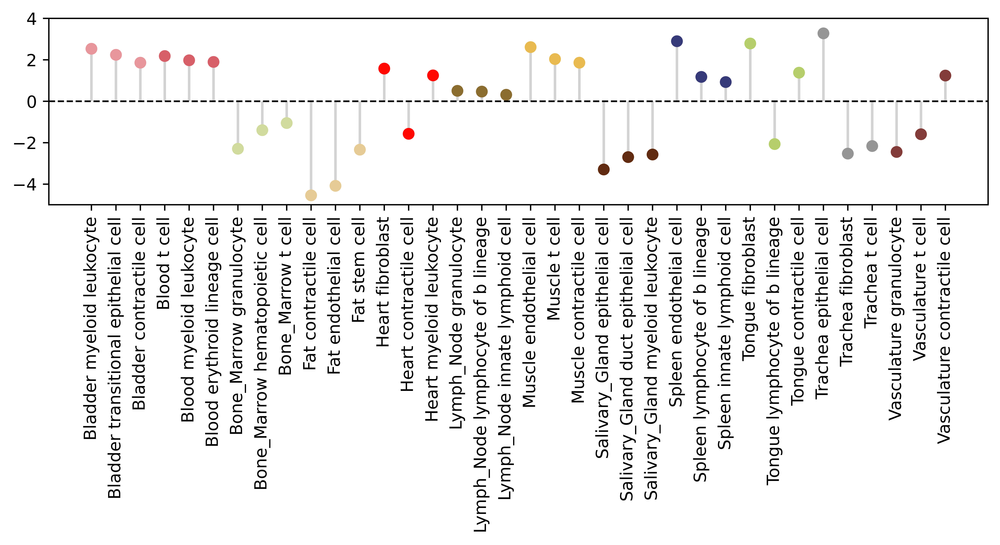

In [102]:
tissue_colors = utils.tissue_colors()
df_plot = pd.DataFrame()
for tissue_ in list(sorted(sex_diff_count.tissue.unique())):
    sex_diff_temp = sex_diff_count[sex_diff_count['tissue']==tissue_]
    sex_diff_temp = sex_diff_temp.sort_values(by='num_ratio_abs',ascending=False)
    df_plot = pd.concat([df_plot,sex_diff_temp[:3][['tissue','cell type','num_ratio']]],axis=0)
df_plot['color'] = df_plot['tissue'].map(tissue_colors)
categories = df_plot['tissue'] + ' ' +df_plot['cell type']
values = df_plot['num_ratio']
color_list = df_plot['color']

fig, ax = plt.subplots(figsize=(10,2),dpi=800)
for (category, value, color_) in zip(categories, values, color_list):
    markerline, stemlines, baseline = ax.stem([category], [value], basefmt=" ")
    plt.setp(markerline,'color', color_, 'markerfacecolor', color_)  # Set marker color
    plt.setp(stemlines, 'color', 'lightgray')            # Set stem color
# Adding titles and labels
#ax.axhline(y=0, color='k', linewidth=1, linestyle='--')
#ax.set_xticklabels([])
# Adding dashed line at y=0
ax.axhline(y=0, color='k', linewidth=1, linestyle='--')

# Adding titles and labels
#ax.set_xticklabels([])
plt.xticks(rotation=90)
plt.ylim([-5, 4])

plt.ylim([-5,4])
# Show the plot
plt.show()

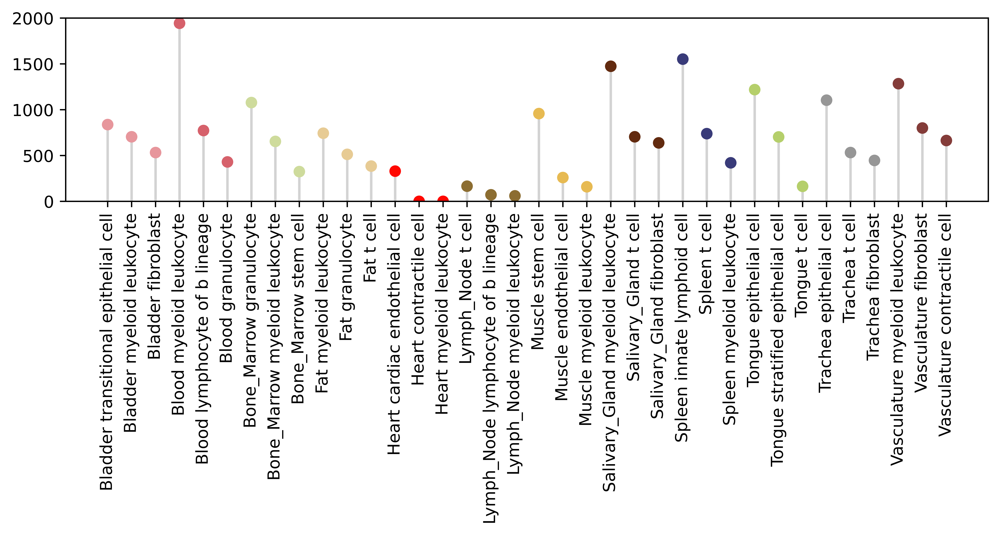

In [103]:
tissue_colors = utils.tissue_colors()
df_plot = pd.DataFrame()
for tissue_ in list(sorted(sex_diff_count.tissue.unique())):
    sex_diff_temp = sex_diff_count[sex_diff_count['tissue']==tissue_]
    sex_diff_temp = sex_diff_temp.sort_values(by='DE_num',ascending=False)
    df_plot = pd.concat([df_plot,sex_diff_temp[:3][['tissue','cell type','DE_num']]],axis=0)
df_plot['color'] = df_plot['tissue'].map(tissue_colors)
categories = df_plot['tissue'] + ' ' +df_plot['cell type']
values = df_plot['DE_num']
color_list = df_plot['color']

fig, ax = plt.subplots(figsize=(10,2),dpi=800)
for (category, value, color_) in zip(categories, values, color_list):
    markerline, stemlines, baseline = ax.stem([category], [value], basefmt=" ")
    plt.setp(markerline,'color', color_, 'markerfacecolor', color_)  # Set marker color
    plt.setp(stemlines, 'color', 'lightgray')            # Set stem color

# Adding titles and labels
#ax.axhline(y=0, color='k', linewidth=1, linestyle='--')
#ax.set_xticklabels([])
plt.xticks(rotation=90)
plt.ylim([0,2000])
# Show the plot
plt.show()

## Scatter plot for DE (protein coding DE genes)

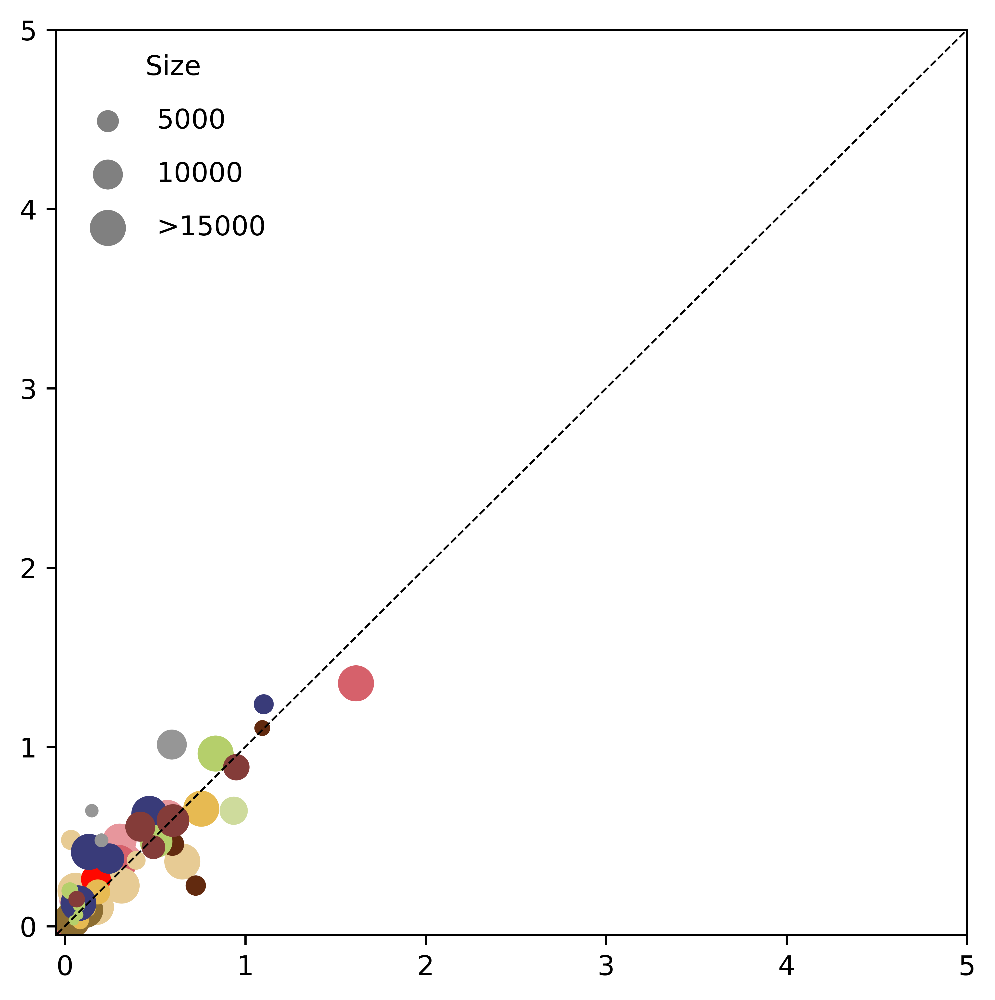

In [62]:
plt.figure(figsize=(6,6), dpi=800)

plt.plot(np.linspace(-1,5,10),np.linspace(-1,5,10),'--',c='k',linewidth=0.7)


sizes = np.minimum(sex_diff_count['total_cell_num']/100, 150)  # Capping the size

# Plot using the capped sizes
plt.scatter((sex_diff_count['count_F']),(sex_diff_count['count_M']), s=sizes, color=sex_diff_count['color'])

plt.ylim([-0.05,5])
plt.xlim([-0.05,5])


# Example legend - manually add scatter plots for legend entries
for size in [50, 100,]:  # Example sizes
    plt.scatter([], [], s=size, color='gray', label=f'{size}00')
for size in [150]:  # Example sizes
    plt.scatter([], [], s=size, color='gray', label=f'>{size}00')

plt.legend(scatterpoints=1, frameon=False, labelspacing=1, title='Size')


plt.show()

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/matplotlib/axes/_base.py:2503: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


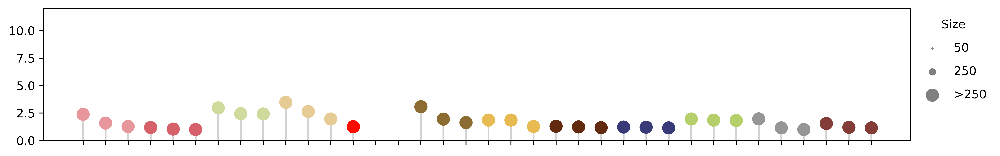

In [72]:
df_plot = pd.DataFrame()
for tissue_ in list(sorted(sex_diff_count.tissue.unique())):
    sex_diff_temp = sex_diff_count[sex_diff_count['tissue']==tissue_]
    sex_diff_temp = sex_diff_temp.sort_values(by='logFC_mean_F',ascending=False)
    df_plot = pd.concat([df_plot,sex_diff_temp[:3][['tissue','cell type','logFC_mean_F','total_cell_num']]],axis=0)
df_plot['color'] = df_plot['tissue'].map(tissue_colors)

categories = df_plot['tissue'] + ' ' +df_plot['cell type']
values = df_plot['logFC_mean_F']
color_list = df_plot['color']
size_list = np.minimum(list(df_plot['total_cell_num']/50), 10)

fig, ax = plt.subplots(figsize=(13,2),dpi=800)
for (category, value, color_, size_) in zip(categories, values, color_list, size_list):

    markerline, stemlines, baseline = ax.stem([category], [value], basefmt=" ")
    plt.setp(markerline,'color', color_, 'markerfacecolor', color_,markersize = size_)  # Set marker color
    plt.setp(stemlines, 'color', 'lightgray')            # Set stem color


# Adding titles and labels
#ax.axhline(y=0, color='k', linewidth=1, linestyle='--')
ax.set_xticklabels([])
plt.ylim([0,12])

# Example legend - manually add scatter plots for legend entries
for size in [1]:  # Example sizes
    plt.scatter([], [], s=size**2, color='gray', label='50')
for size in [5,]:  # Example sizes
    plt.scatter([], [], s=size**2, color='gray', label='250')
for size in [10]:  # Example sizes
    plt.scatter([], [], s=size**2, color='gray', label='>250')

plt.legend(scatterpoints=1, frameon=False, labelspacing=1, title='Size',bbox_to_anchor=(1.1,1))


# Show the plot
plt.show()

In [71]:
edgeR_LRT_all_coding_w_chrXY['tissue_cell_type'] =edgeR_LRT_all_coding_w_chrXY['tissue']+'_'+edgeR_LRT_all_coding_w_chrXY['cell_type']
edgeR_LRT_all_coding_w_chrXY_F = edgeR_LRT_all_coding_w_chrXY[edgeR_LRT_all_coding_w_chrXY['logFC']>0]
edgeR_LRT_all_coding_w_chrXY_M = edgeR_LRT_all_coding_w_chrXY[edgeR_LRT_all_coding_w_chrXY['logFC']<0]


edgeR_LRT_all_coding_w_chrXY_F = edgeR_LRT_all_coding_w_chrXY_F[['logFC','tissue_cell_type']].groupby('tissue_cell_type').mean().sort_values(by='logFC',ascending=False)
edgeR_LRT_all_coding_w_chrXY_F.columns = ['logFC_mean_F']
edgeR_LRT_all_coding_w_chrXY_M = edgeR_LRT_all_coding_w_chrXY_M[['logFC','tissue_cell_type']].groupby('tissue_cell_type').mean().sort_values(by='logFC',ascending=False)
edgeR_LRT_all_coding_w_chrXY_M.columns = ['logFC_mean_M']

sex_diff_count = sex_diff_count.merge(edgeR_LRT_all_coding_w_chrXY_F,how='left',on='tissue_cell_type')
sex_diff_count = sex_diff_count.merge(edgeR_LRT_all_coding_w_chrXY_M,how='left',on='tissue_cell_type')

#sex_diff_count['total_cell_num'] = sex_diff_count['male cell num'] + sex_diff_count['female cell num']

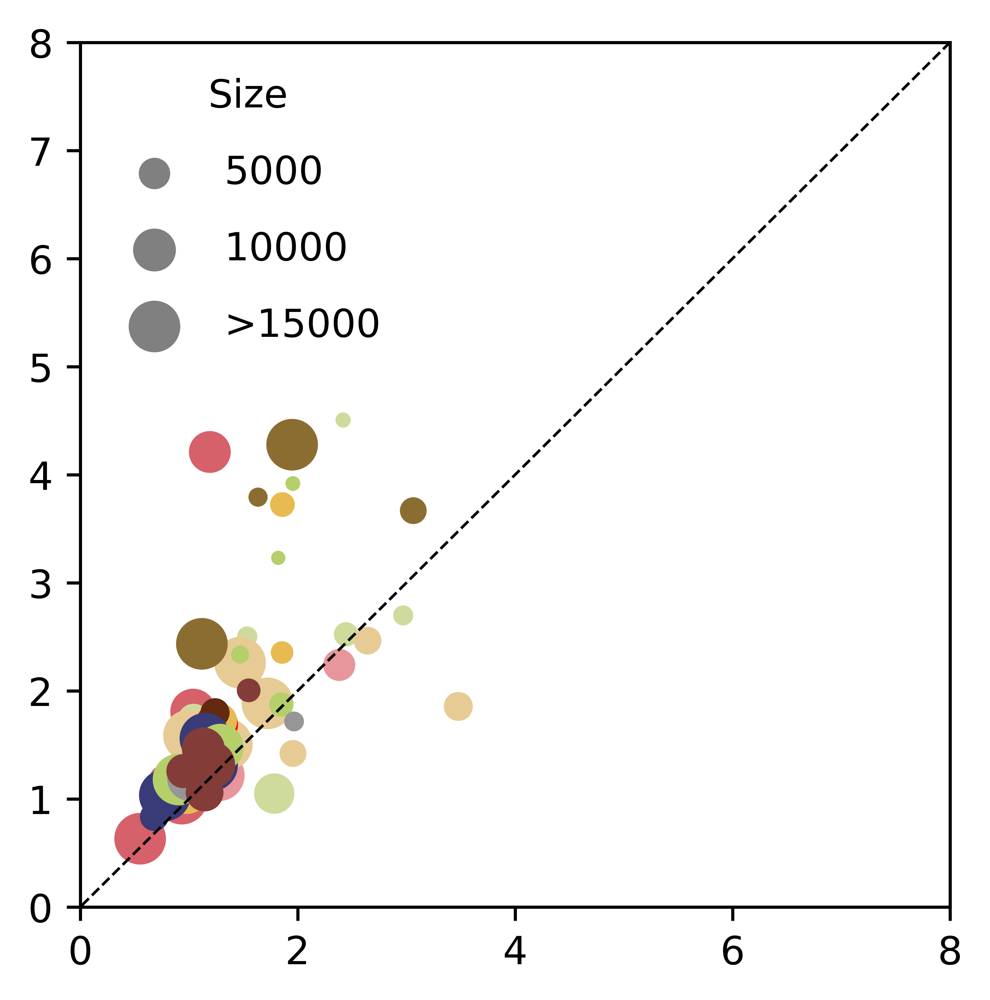

In [73]:
plt.figure(figsize=(4,4), dpi=800)

plt.plot(np.linspace(-1,12,12),np.linspace(-1,12,12),'--',c='k',linewidth=0.7)


sizes = np.minimum(sex_diff_count['total_cell_num']/100, 150)  # Capping the size
# Plot using the capped sizes
plt.scatter(sex_diff_count['logFC_mean_F'], -sex_diff_count['logFC_mean_M'], s=sizes, color=sex_diff_count['color'])

plt.ylim([-0,8])
plt.xlim([-0,8])

# Example legend - manually add scatter plots for legend entries
for size in [50, 100,]:  # Example sizes
    plt.scatter([], [], s=size, color='gray', label=f'{size}00')
for size in [150]:  # Example sizes
    plt.scatter([], [], s=size, color='gray', label=f'>{size}00')

plt.legend(scatterpoints=1, frameon=False, labelspacing=1, title='Size')

plt.show()

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/matplotlib/axes/_base.py:2503: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


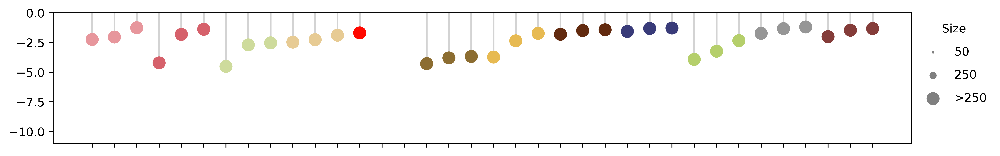

In [74]:
df_plot = pd.DataFrame()
for tissue_ in list(sorted(sex_diff_count.tissue.unique())):
    sex_diff_temp = sex_diff_count[sex_diff_count['tissue']==tissue_]
    sex_diff_temp = sex_diff_temp.sort_values(by='logFC_mean_M',ascending=True)
    df_plot = pd.concat([df_plot,sex_diff_temp[:3][['tissue','cell type','logFC_mean_M','total_cell_num']]],axis=0)
df_plot['color'] = df_plot['tissue'].map(tissue_colors)

categories = df_plot['tissue'] + ' ' +df_plot['cell type']
values = df_plot['logFC_mean_M']
color_list = df_plot['color']
size_list = np.minimum(df_plot['total_cell_num']/50, 10)


fig, ax = plt.subplots(figsize=(13,2),dpi=800)
for (category, value, color_, size_) in zip(categories, values, color_list, size_list):
    markerline, stemlines, baseline = ax.stem([category], [value], basefmt=" ")
    plt.setp(markerline,'color', color_, 'markerfacecolor', color_,markersize = size_)  # Set marker color
    plt.setp(stemlines, 'color', 'lightgray')            # Set stem color


# Adding titles and labels
#ax.axhline(y=0, color='k', linewidth=1, linestyle='--')
ax.set_xticklabels([])
plt.ylim([-11,0])
# Show the plot

# Example legend - manually add scatter plots for legend entries
for size in [1]:  # Example sizes
    plt.scatter([], [], s=size**2, color='gray', label='50')
for size in [5,]:  # Example sizes
    plt.scatter([], [], s=size**2, color='gray', label='250')
for size in [10]:  # Example sizes
    plt.scatter([], [], s=size**2, color='gray', label='>250')

plt.legend(scatterpoints=1, frameon=False, labelspacing=1, title='Size',bbox_to_anchor=(1.1,1))


# Show the plot
plt.show()

In [157]:
edgeR_LRT_all_coding.to_csv('/hpc/mydata/siyu.he/TS_project/edgeR_LRT_all_coding.csv')
edgeR_LRT_all_coding_w_chrXY.to_csv('/hpc/mydata/siyu.he/TS_project/edgeR_LRT_all_coding_w_chrXY.csv')

In [158]:
#all_libraries = gp.get_library_name(organism='Human')
import gseapy as gp
all_libraries = [
    'GO_Biological_Process_2023',
    'GO_Cellular_Component_2023',
    'GO_Molecular_Function_2023',
    'Human_Phenotype_Ontology',
    'KEGG_2021_Human',
    'Reactome_2022',
    'WikiPathway_2023_Human',
    'MSigDB_Hallmark_2020',
    'MSigDB_Oncogenic_Signatures'
]


In [159]:
edgeR_LRT_all_coding  = pd.read_csv('/hpc/mydata/siyu.he/TS_project/edgeR_LRT_all_coding_w_chrXY.csv',index_col=0)



## heart regular atrial cardiac myocyte

In [160]:
edgeR_LRT_exp1 = edgeR_LRT_all_coding[(edgeR_LRT_all_coding['tissue']=='Heart')& (edgeR_LRT_all_coding['cell_type']=='contractile cell')]


In [161]:
edgeR_LRT_exp1

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,coding_status,color,count_F,count_M,tissue_cell_type
DDX3Y,-9.622997,5.573492,916.046991,3.187364e-201,1.467463e-197,DDX3Y,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,coding,#ff0800,0,1,Heart_contractile cell
KDM5D,-8.744313,4.744566,437.821461,3.225395e-97,7.424859e-94,KDM5D,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,coding,#ff0800,0,1,Heart_contractile cell
EIF1AY,-11.633324,7.554794,393.732449,1.274466e-87,1.466911e-84,EIF1AY,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,coding,#ff0800,0,1,Heart_contractile cell
USP9Y,-7.603844,6.315403,359.259768,4.081010e-80,3.131495e-77,USP9Y,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,coding,#ff0800,0,1,Heart_contractile cell
UTY,-9.616460,6.472904,247.688141,8.288101e-56,4.239824e-53,UTY,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,coding,#ff0800,0,1,Heart_contractile cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
JPX,0.840003,8.117947,30.575424,3.211360e-08,6.847208e-07,JPX,Heart,contractile cell,8877,2993,2,3,chrX,chrX_gene,non-coding,#ff0800,1,0,Heart_contractile cell
ENSG00000289132,-2.659537,1.891455,30.319658,3.663938e-08,7.702635e-07,ENSG00000289132,Heart,contractile cell,8877,2993,2,3,chrX,chrX_gene,non-coding,#ff0800,0,1,Heart_contractile cell
ENSG00000229151,3.320207,2.233851,29.853413,4.659760e-08,9.368355e-07,ENSG00000229151,Heart,contractile cell,8877,2993,2,3,chrX,chrX_gene,non-coding,#ff0800,1,0,Heart_contractile cell
ENSG00000260197,-3.728444,1.240376,29.772047,4.859483e-08,9.643560e-07,ENSG00000260197,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,non-coding,#ff0800,0,1,Heart_contractile cell


In [162]:
edgeR_LRT_exp1.sort_values(by='logFC')

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,coding_status,color,count_F,count_M,tissue_cell_type
EIF1AY,-11.633324,7.554794,393.732449,1.274466e-87,1.466911e-84,EIF1AY,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,coding,#ff0800,0,1,Heart_contractile cell
DDX3Y,-9.622997,5.573492,916.046991,3.187364e-201,1.467463e-197,DDX3Y,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,coding,#ff0800,0,1,Heart_contractile cell
UTY,-9.616460,6.472904,247.688141,8.288101e-56,4.239824e-53,UTY,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,coding,#ff0800,0,1,Heart_contractile cell
RPS4Y1,-9.421226,5.928816,247.282731,1.015878e-55,4.677103e-53,RPS4Y1,Heart,contractile cell,8877,2993,2,3,chrY,RP,coding,#ff0800,0,1,Heart_contractile cell
TTTY14,-9.393422,6.263860,398.229478,1.337695e-88,2.052916e-85,TTTY14,Heart,contractile cell,8877,2993,2,3,chrY,chrY_gene,non-coding,#ff0800,0,1,Heart_contractile cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MTND6P32,3.627863,1.010949,43.781084,3.672373e-11,1.537055e-09,MTND6P32,Heart,contractile cell,8877,2993,2,3,chrX,chrX_gene,non-coding,#ff0800,1,0,Heart_contractile cell
AMELX,4.041142,1.228315,55.160993,1.110509e-13,7.101085e-12,AMELX,Heart,contractile cell,8877,2993,2,3,chrX,chrX_gene,coding,#ff0800,1,0,Heart_contractile cell
ENSG00000284377,4.648539,1.330183,76.399243,2.317400e-18,3.810468e-16,ENSG00000284377,Heart,contractile cell,8877,2993,2,3,chrX,chrX_gene,non-coding,#ff0800,1,0,Heart_contractile cell
TSIX,9.337267,4.815441,335.038319,7.681737e-75,4.420840e-72,TSIX,Heart,contractile cell,8877,2993,2,3,chrX,chrX_gene,non-coding,#ff0800,1,0,Heart_contractile cell


In [164]:
edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal'].sort_values(by='logFC')

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,coding_status,color,count_F,count_M,tissue_cell_type
ENO1,-4.020260,10.185898,102.083802,5.322196e-24,1.633559e-21,ENO1,Heart,contractile cell,8877,2993,2,3,chr1,Autosomal,coding,#ff0800,0,1,Heart_contractile cell
MIF,-3.610413,11.089680,55.980264,7.320219e-14,4.814613e-12,MIF,Heart,contractile cell,8877,2993,2,3,chr22,Autosomal,coding,#ff0800,0,1,Heart_contractile cell
LDHA,-3.372914,10.361631,62.167812,3.154013e-15,3.030478e-13,LDHA,Heart,contractile cell,8877,2993,2,3,chr11,Autosomal,coding,#ff0800,0,1,Heart_contractile cell
HSPE1,-2.685959,10.128956,36.097603,1.876776e-09,5.434387e-08,HSPE1,Heart,contractile cell,8877,2993,2,3,chr2,Autosomal,coding,#ff0800,0,1,Heart_contractile cell
GPX1,-2.502897,9.347257,39.033424,4.166114e-10,1.389912e-08,GPX1,Heart,contractile cell,8877,2993,2,3,chr3,Autosomal,coding,#ff0800,0,1,Heart_contractile cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CFLAR,1.605611,7.285919,43.751376,3.728544e-11,1.546506e-09,CFLAR,Heart,contractile cell,8877,2993,2,3,chr2,Autosomal,coding,#ff0800,1,0,Heart_contractile cell
NR3C1,1.610340,7.618106,39.736886,2.905852e-10,9.983988e-09,NR3C1,Heart,contractile cell,8877,2993,2,3,chr5,Autosomal,coding,#ff0800,1,0,Heart_contractile cell
RCAN2,1.842938,9.546338,31.955716,1.577276e-08,3.594939e-07,RCAN2,Heart,contractile cell,8877,2993,2,3,chr6,Autosomal,coding,#ff0800,1,0,Heart_contractile cell
PTEN,1.943915,9.922519,36.020424,1.952601e-09,5.618611e-08,PTEN,Heart,contractile cell,8877,2993,2,3,chr10,Autosomal,coding,#ff0800,1,0,Heart_contractile cell


Text(0.5, 1.0, 'DE genes in heart and contractile cell')

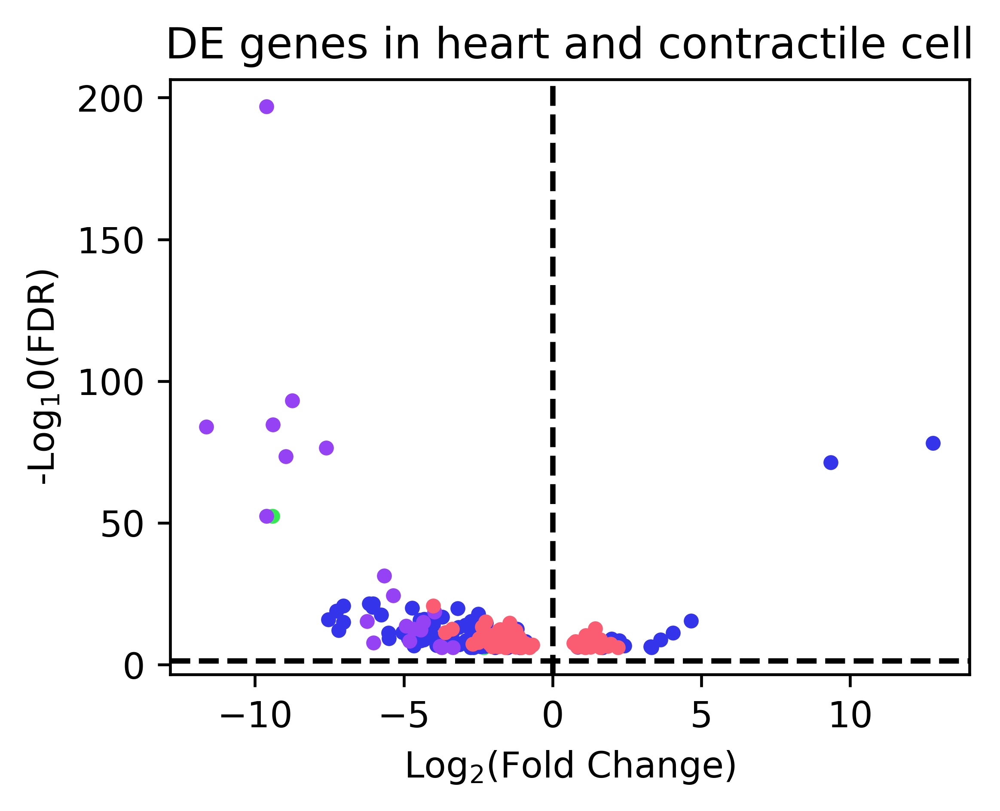

In [165]:
plt.subplots(1,1,figsize=(4,3),dpi=600)

plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='RP']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='RP']['FDR']),
            c='#34eb52',
            s=10
           )
plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='MT']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='MT']['FDR']),
            c='#ebc034',
            s=10
           )


plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrX_gene']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrX_gene']['FDR']),
            c='#3434eb',
            s=10
           )

plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrY_gene']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrY_gene']['FDR']),
            c='#9542f5',
            s=10
           )
plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal']['FDR']),
            c='#fa5c72',
            s=10
           )



plt.axhline(y=-np.log10(0.05),linestyle='--',c='k')
plt.axvline(x=0,linestyle='--',c='k')
plt.xlabel('Log$_2$(Fold Change)')
plt.ylabel('-Log$_10$(FDR)')
plt.title('DE genes in heart and contractile cell')


In [166]:
degs_up = edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal'][edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal'].logFC > 0]
degs_dw = edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal'][edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal'].logFC < 0]
enr_up = gp.enrichr(list(degs_up.index),
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]

enr_dw = gp.enrichr(list(degs_dw.index),
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)
enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
enr_up.res2d['UP_DW'] = "Female"
enr_dw.res2d['UP_DW'] = "Male"
enr_res = pd.concat([enr_up.res2d.head(), enr_dw.res2d.head()])


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


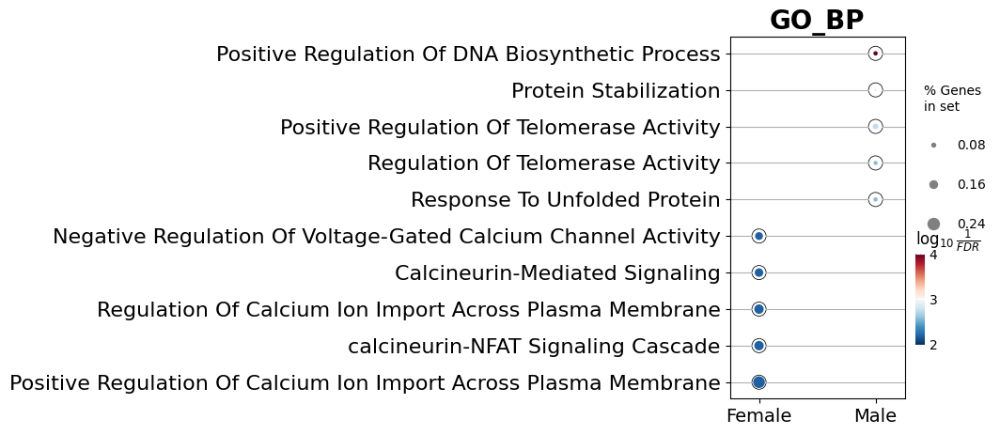

In [167]:
# display multi-datasets
ax = gp.dotplot(enr_res,figsize=(3,5),
                x='UP_DW',
                x_order = ["Female","Male"],
                title="GO_BP",
                cmap ='RdBu_r',
                size=6,
                show_ring=True)
ax.set_xlabel("")
plt.savefig("plot_filename.png", dpi=500,bbox_inches='tight') 

<Figure size 400x200 with 0 Axes>

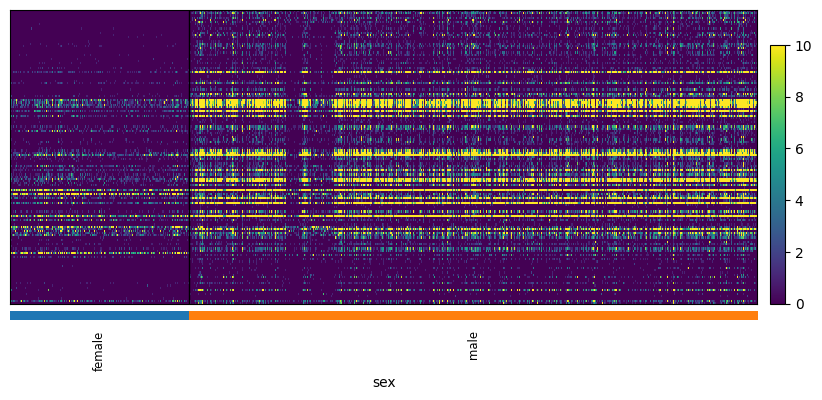

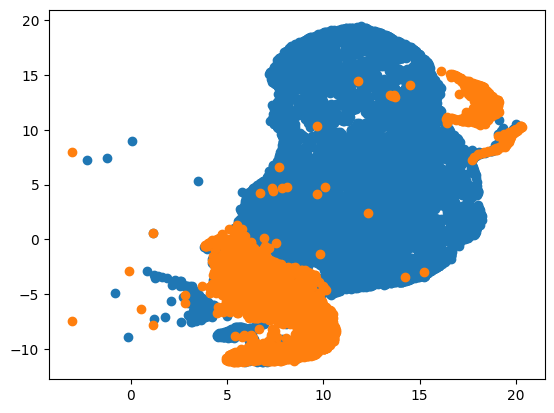

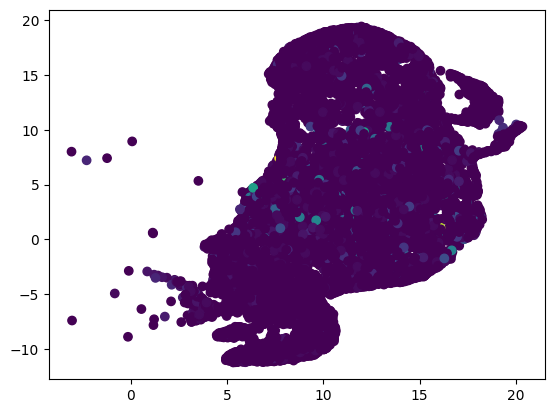

In [407]:
tissue_ = 'Heart'
cell_type_ = 'contractile cell'
adata_donor_all = sc.read_h5ad('/hpc/mydata/siyu.he/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'.h5ad')

TS_ct_adata = TS_tissue_adata_all[(TS_tissue_adata_all.obs['tissue']==tissue_) & 
                                  (TS_tissue_adata_all.obs['broad_cell_class']==cell_type_)]
TS_ct_adata = TS_ct_adata[adata_donor_all.obs_names]


markers = edgeR_LRT_exp1.index
plt.figure(figsize=(4,2))
sc.pl.heatmap(adata_donor_all, markers, groupby='sex', swap_axes=True,vmax=10)

for i in TS_ct_adata.obs['sex'].unique():
    plt.scatter(TS_ct_adata.obsm['X_umap'][TS_ct_adata.obs['sex']==i,0],
                TS_ct_adata.obsm['X_umap'][TS_ct_adata.obs['sex']==i,1],
                
               )
plt.figure()
plt.scatter(TS_ct_adata.obsm['X_umap'][:,0],
            TS_ct_adata.obsm['X_umap'][:,1],
            c=TS_ct_adata[:,'RPS4Y1'].to_df().values
           )

Text(0.5, 1.0, 'Heart')

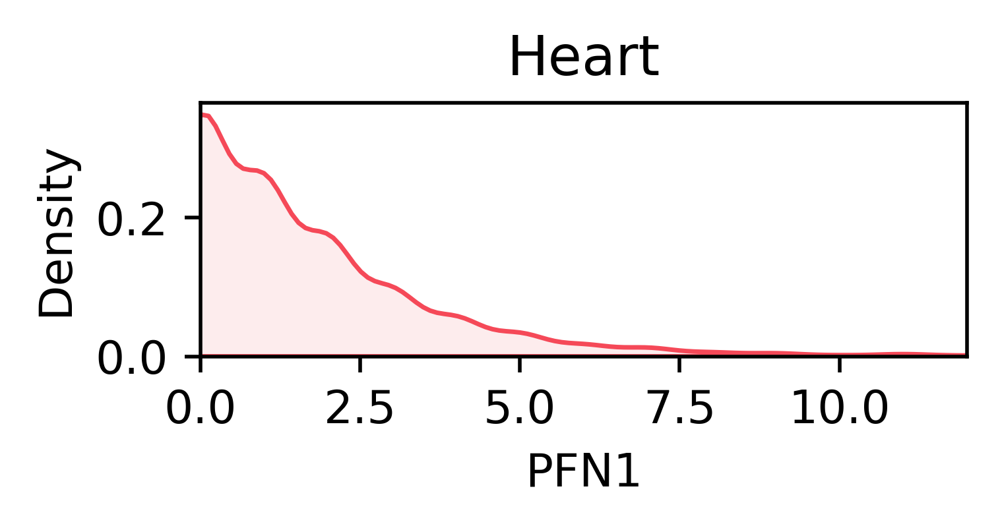

In [410]:
plt.subplots(1,1,figsize=(3,1),dpi=500)

temp_df = TS_ct_adata[TS_ct_adata.obs['sex']=='female'][:,'PFN1'].to_df()
temp_df.index = list(range(temp_df.shape[0]))
#temp_df.replace(0, np.nan, regex=True, inplace=True)
sns.kdeplot(temp_df,x='PFN1',color='#f54958', fill=True,alpha=0.1)
plt.xlim([0,12])

plt.title(tissue_)

Text(0.5, 1.0, 'Heart')

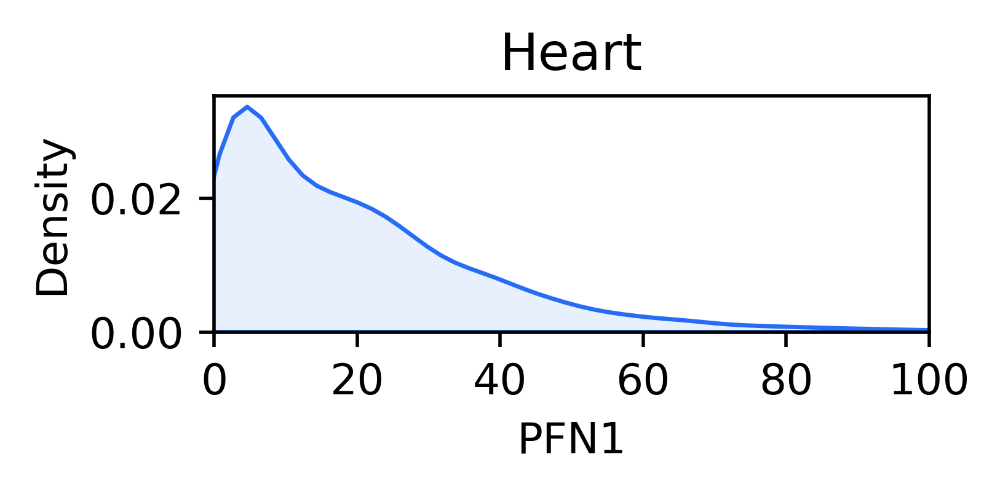

In [413]:
plt.subplots(1,1,figsize=(3,1),dpi=500)

temp_df = TS_ct_adata[TS_ct_adata.obs['sex']=='male'][:,'PFN1'].to_df()
#temp_df.replace(0, np.nan, regex=True, inplace=True)
sns.kdeplot(temp_df,x='PFN1',color='#276cf5', fill=True,alpha=0.1)
plt.xlim([0,100])
plt.title(tissue_)

##  NK cell in Salivary_Gland

<Figure size 400x200 with 0 Axes>

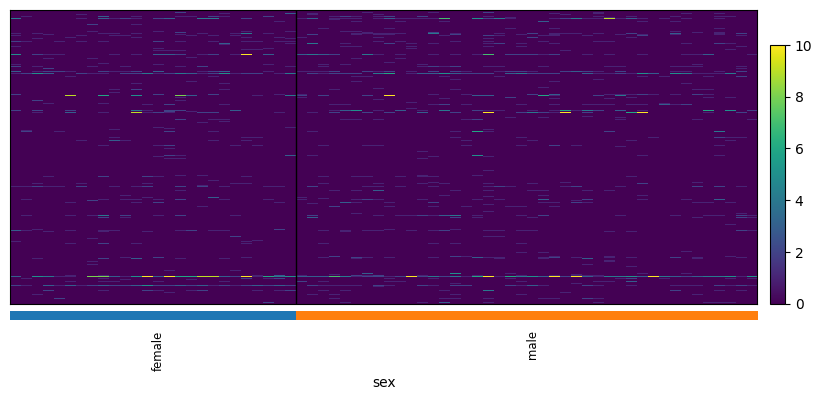

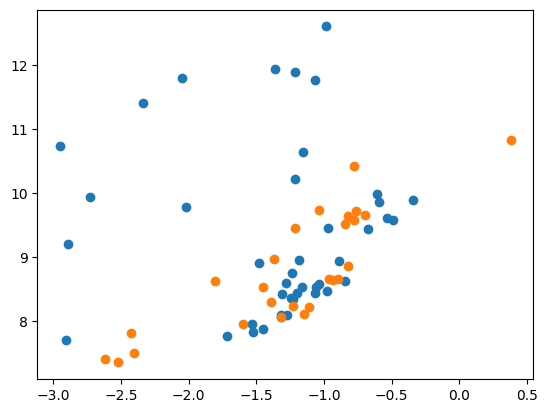

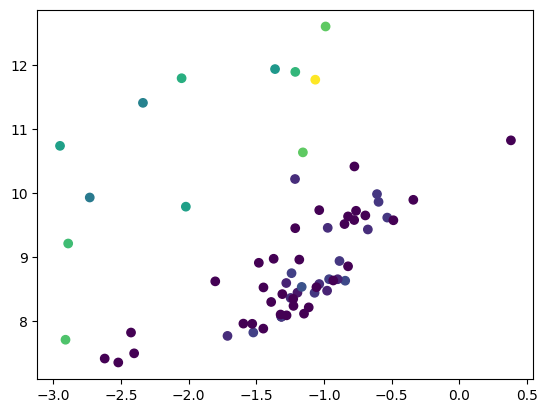

In [214]:
tissue_ = 'Salivary_Gland'
cell_type_ = 'natural killer cell'
adata_donor_all = sc.read_h5ad('/hpc/mydata/siyu.he/TS_project/pseudobulk_input/'+tissue_.replace(' ', '_')+'_'+cell_type_.replace(' ', '_')+'.h5ad')

TS_ct_adata = TS_tissue_adata_all[(TS_tissue_adata_all.obs['tissue']==tissue_) & 
                                  (TS_tissue_adata_all.obs['broad_cell_class']==cell_type_)]
TS_ct_adata = TS_ct_adata[adata_donor_all.obs_names]


markers = edgeR_LRT_exp1.index
plt.figure(figsize=(4,2))
sc.pl.heatmap(adata_donor_all, markers, groupby='sex', swap_axes=True,vmax=10)

for i in TS_ct_adata.obs['sex'].unique():
    plt.scatter(TS_ct_adata.obsm['X_umap'][TS_ct_adata.obs['sex']==i,0],
                TS_ct_adata.obsm['X_umap'][TS_ct_adata.obs['sex']==i,1],
                
               )
plt.figure()
plt.scatter(TS_ct_adata.obsm['X_umap'][:,0],
            TS_ct_adata.obsm['X_umap'][:,1],
            c=TS_ct_adata[:,'STATH'].to_df().values
           )

In [188]:
edgeR_LRT_exp1 = edgeR_LRT_all_coding[(edgeR_LRT_all_coding['tissue']==tissue_)& 
                                      (edgeR_LRT_all_coding['cell_type']==cell_type_)]

In [189]:
edgeR_LRT_exp1

,logFC,logCPM,LR,PValue,FDR,gene_symbol,tissue,cell_type,male cell num,female cell num,male donor num,female donor num,chr,gene_type,coding_status,color,count_F,count_M,tissue_cell_type
STATH,-9.025073,12.782848,23.843876,0.000001,0.000702,STATH,Salivary_Gland,natural killer cell,45,27,2,2,chr4,Autosomal,coding,#622a0f,0,1,Salivary_Gland_natural killer cell
HLA-DPB1,5.097489,9.509263,22.477249,0.000002,0.000935,HLA-DPB1,Salivary_Gland,natural killer cell,45,27,2,2,chr6,Autosomal,coding,#622a0f,1,0,Salivary_Gland_natural killer cell
HSPA1B,3.502769,11.986924,21.815066,0.000003,0.000935,HSPA1B,Salivary_Gland,natural killer cell,45,27,2,2,chr6,Autosomal,coding,#622a0f,1,0,Salivary_Gland_natural killer cell
HLA-DRB1,4.703806,9.732258,21.756859,0.000003,0.000935,HLA-DRB1,Salivary_Gland,natural killer cell,45,27,2,2,chr6,Autosomal,coding,#622a0f,1,0,Salivary_Gland_natural killer cell
MT-ATP8,3.041915,11.441369,20.873830,0.000005,0.001270,MT-ATP8,Salivary_Gland,natural killer cell,45,27,2,2,chrM,MT,coding,#622a0f,1,0,Salivary_Gland_natural killer cell


Text(0.5, 1.0, 'DE genes in Salivary Gland and NK cell')

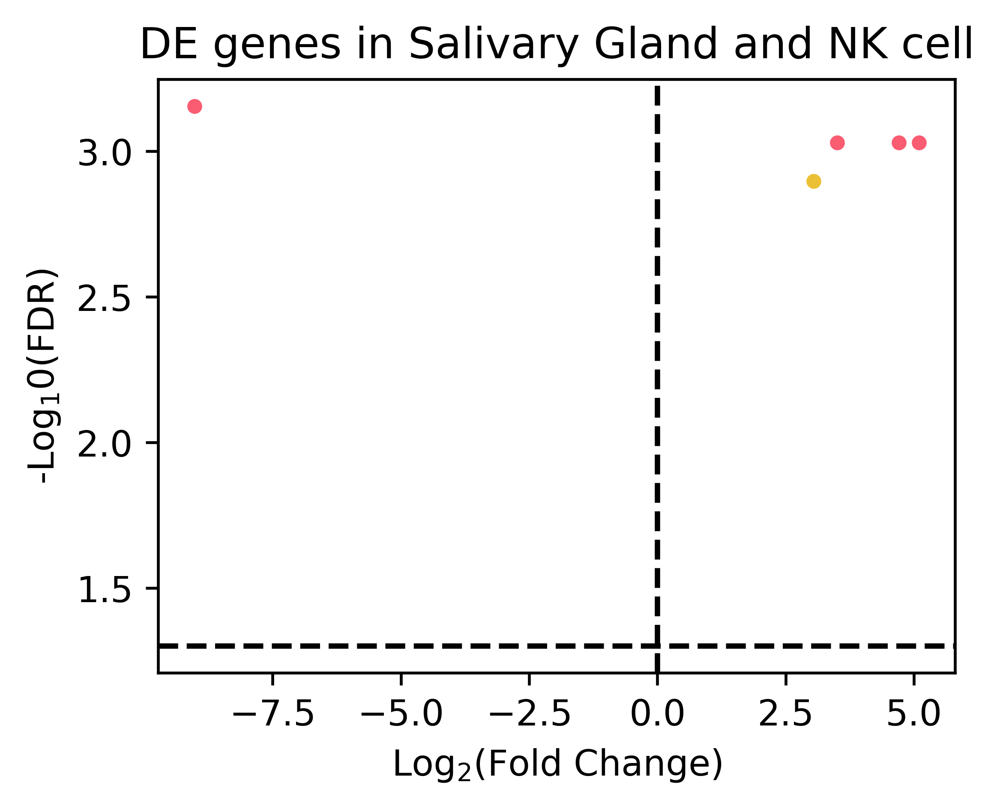

In [202]:
plt.subplots(1,1,figsize=(4,3),dpi=600)
plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal']['FDR']),
            c='#fa5c72',
            s=10
           )
plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrX_gene']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrX_gene']['FDR']),
            c='#3434eb',
            s=10
           )

plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrY_gene']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrY_gene']['FDR']),
            c='#9542f5',
            s=10
           )


plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='RP']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='RP']['FDR']),
            c='#34eb52',
            s=10
           )
plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='MT']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='MT']['FDR']),
            c='#ebc034',
            s=10
           )
plt.axhline(y=-np.log10(0.05),linestyle='--',c='k')
plt.axvline(x=0,linestyle='--',c='k')
plt.xlabel('Log$_2$(Fold Change)')
plt.ylabel('-Log$_10$(FDR)')
plt.title('DE genes in Salivary Gland and NK cell')


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




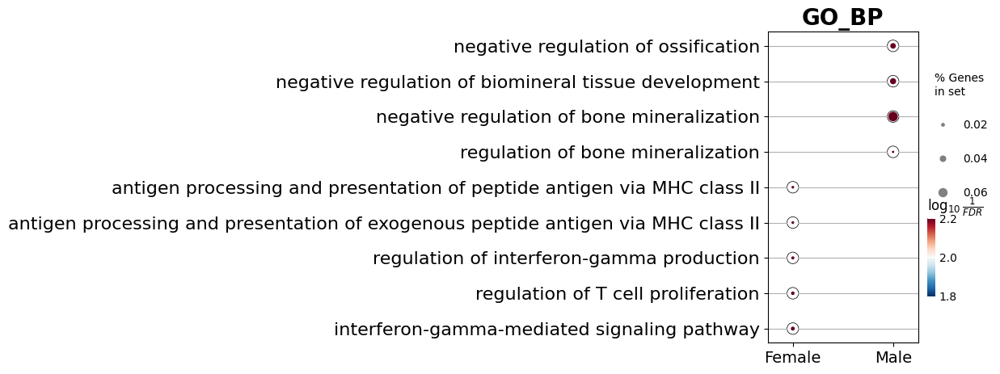

In [191]:
degs_up = edgeR_LRT_exp1[edgeR_LRT_exp1.logFC > 0]
degs_dw = edgeR_LRT_exp1[edgeR_LRT_exp1.logFC < 0]
enr_up = gp.enrichr(list(degs_up.index),
                    gene_sets='GO_Biological_Process_2021',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]

enr_dw = gp.enrichr(list(degs_dw.index),
                    gene_sets='GO_Biological_Process_2021',
                    outdir=None)
enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
enr_up.res2d['UP_DW'] = "Female"
enr_dw.res2d['UP_DW'] = "Male"
enr_res = pd.concat([enr_up.res2d.head(), enr_dw.res2d.head()])

# display multi-datasets
ax = gp.dotplot(enr_res,figsize=(3,5),
                x='UP_DW',
                x_order = ["Female","Male"],
                title="GO_BP",
                cmap ='RdBu_r',
                size=20,
                show_ring=True)
ax.set_xlabel("")
plt.savefig("plot_filename.png", dpi=500,bbox_inches='tight') 

In [192]:
enr_res

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes,UP_DW
0,GO_Biological_Process_2021,interferon-gamma-mediated signaling pathway,2/68,0.000068,0.00407,0,0,301.969697,2897.524306,HLA-DPB1;HLA-DRB1,Female
1,GO_Biological_Process_2021,regulation of T cell proliferation,2/76,0.000085,0.00407,0,0,269.216216,2523.074325,HLA-DPB1;HLA-DRB1,Female
2,GO_Biological_Process_2021,regulation of interferon-gamma production,2/86,0.000109,0.00407,0,0,237.047619,2162.778510,HLA-DPB1;HLA-DRB1,Female
3,GO_Biological_Process_2021,antigen processing and presentation of exogeno...,2/98,0.000142,0.00407,0,0,207.291667,1837.005192,HLA-DPB1;HLA-DRB1,Female
4,GO_Biological_Process_2021,antigen processing and presentation of peptide...,2/100,0.000148,0.00407,0,0,203.040816,1791.115710,HLA-DPB1;HLA-DRB1,Female
0,GO_Biological_Process_2021,negative regulation of bone mineralization,1/14,0.000700,0.00160,0,0,19986.000000,145187.405357,STATH,Male
1,GO_Biological_Process_2021,negative regulation of biomineral tissue devel...,1/22,0.001100,0.00160,0,0,19978.000000,136099.470302,STATH,Male
2,GO_Biological_Process_2021,negative regulation of ossification,1/24,0.001200,0.00160,0,0,19976.000000,134347.694878,STATH,Male
3,GO_Biological_Process_2021,regulation of bone mineralization,1/57,0.002850,0.00285,0,0,19943.000000,116875.007430,STATH,Male


## Fat myofibroblast

In [233]:
edgeR_LRT_exp1 = edgeR_LRT_all_coding[(edgeR_LRT_all_coding['tissue']=='Vasculature')& (edgeR_LRT_all_coding['cell_type']=='erythrocyte')]


In [238]:
edgeR_LRT_exp1.index

Index(['GPX3', 'HSPB1', 'PPDPF', 'COL3A1', 'MYH11', 'HBD', 'MT-ATP8'], dtype='object')

Text(0.5, 1.0, 'DE genes in heart and regular atrial cardiac myocyte')

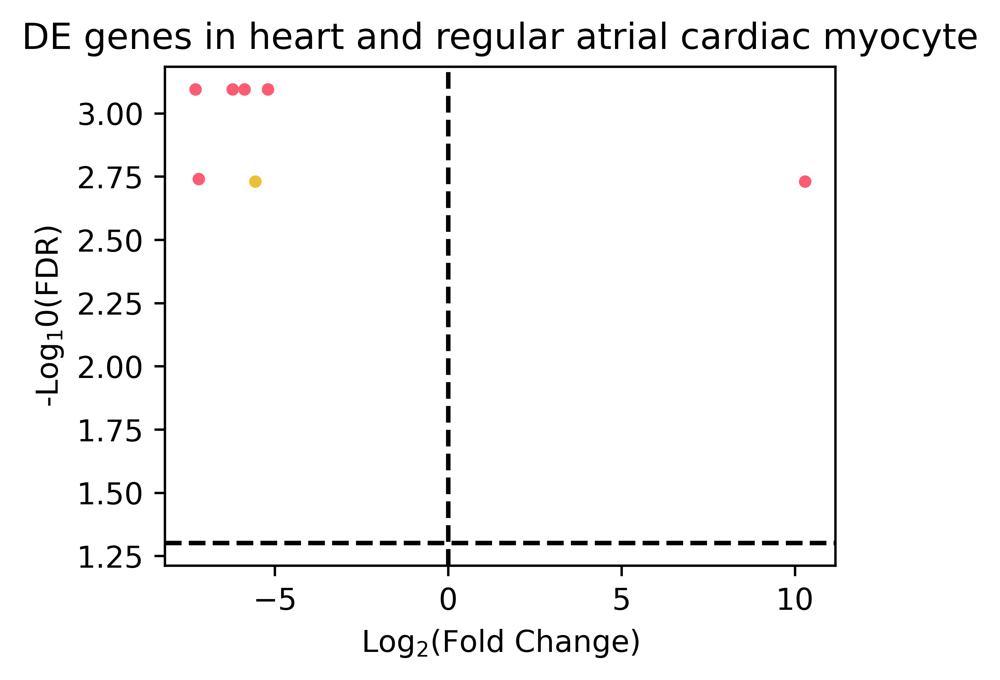

In [235]:
plt.subplots(1,1,figsize=(4,3),dpi=600)
plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='Autosomal']['FDR']),
            c='#fa5c72',
            s=10
           )
plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrX_gene']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrX_gene']['FDR']),
            c='#3434eb',
            s=10
           )

plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrY_gene']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='chrY_gene']['FDR']),
            c='#9542f5',
            s=10
           )


plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='RP']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='RP']['FDR']),
            c='#34eb52',
            s=10
           )
plt.scatter(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='MT']['logFC'],
            -np.log10(edgeR_LRT_exp1[edgeR_LRT_exp1['gene_type']=='MT']['FDR']),
            c='#ebc034',
            s=10
           )

plt.axhline(y=-np.log10(0.05),linestyle='--',c='k')
plt.axvline(x=0,linestyle='--',c='k')
plt.xlabel('Log$_2$(Fold Change)')
plt.ylabel('-Log$_10$(FDR)')
plt.title('DE genes in heart and regular atrial cardiac myocyte')


In [236]:
degs_up = edgeR_LRT_exp1[edgeR_LRT_exp1.logFC > 0]
degs_dw = edgeR_LRT_exp1[edgeR_LRT_exp1.logFC < 0]
enr_up = gp.enrichr(list(degs_up.index),
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]

enr_dw = gp.enrichr(list(degs_dw.index),
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)
enr_dw.res2d.Term = enr_dw.res2d.Term.str.split(" \(GO").str[0]
enr_up.res2d['UP_DW'] = "Female"
enr_dw.res2d['UP_DW'] = "Male"
enr_res = pd.concat([enr_up.res2d.head(), enr_dw.res2d.head()])


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/gseapy/plot.py:689: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




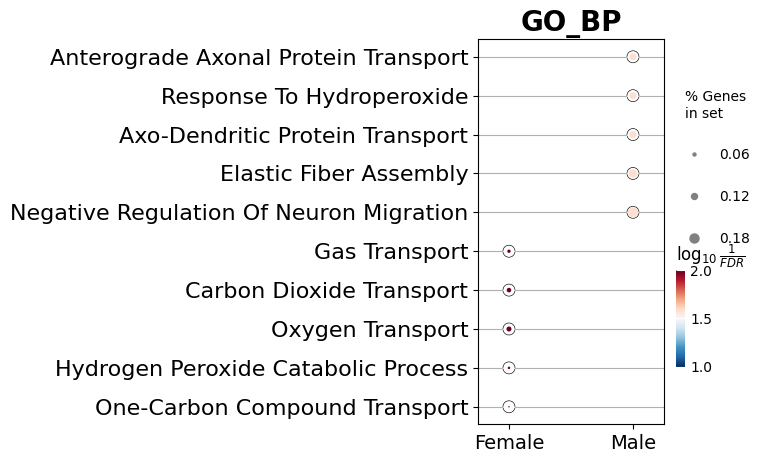

In [237]:

# display multi-datasets
ax = gp.dotplot(enr_res,figsize=(3,5),
                x='UP_DW',
                x_order = ["Female","Male"],
                title="GO_BP",
                cmap ='RdBu_r',
                size=6,
                show_ring=True)
ax.set_xlabel("")
plt.savefig("plot_filename.png", dpi=500,bbox_inches='tight') 

In [94]:
tissue_colors = utils.tissue_colors()
# List of Top N values to plot
top_n_list = np.linspace(1, 5e3, 100, dtype=int)
# Initialize a dictionary to hold data
plot_data = pd.DataFrame(index=[tissue for tissue in tissue_colors.keys()])
# Sort the DataFrame once to optimize
sorted_df = edgeR_LRT_all_coding.sort_values(by='logFC', ascending=False)


# Aggregate data for each top_N
for top_n in top_n_list:
    top_entries = sorted_df.head(top_n)
    tissue_counts = top_entries['tissue'].value_counts(normalize=True)
    plot_data[top_n] = tissue_counts

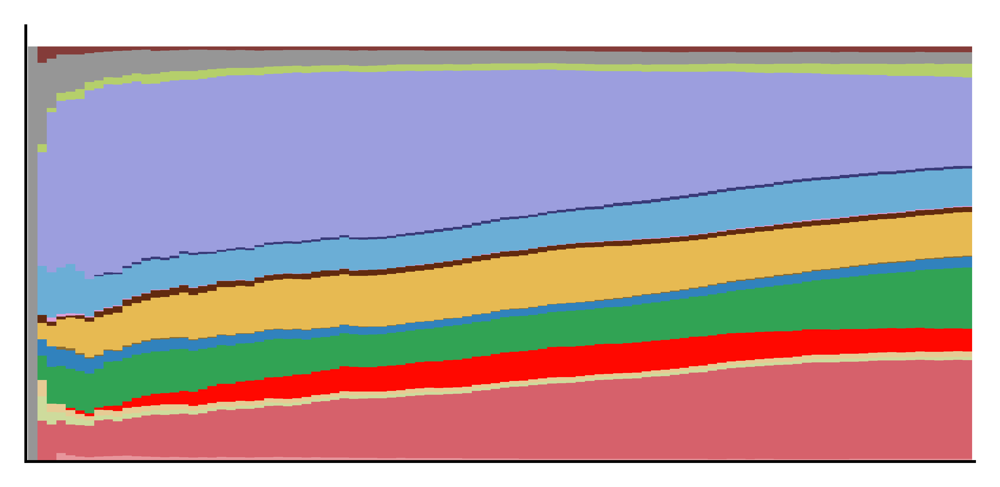

In [95]:
# Plot stacked bar plot
fig, ax = plt.subplots(figsize=(4,2), dpi=800)
plot_data.transpose().plot(kind='bar', width=1,color=[tissue_colors[keys] for keys in tissue_colors.keys()],
                                                          ax=ax,stacked=True)

# Customize the plot with labels, title, etc
ax.set_xlabel('Tissue Number')
plt.ylabel('Gene type')
plt.xticks(rotation=0)  # Rotates X-axis labels to show them horizontally
# Move the legend outside of the plot
# Remove the legend
ax.legend([], frameon=False)

#ax.legend(title='Gene type', bbox_to_anchor=(1.05, 1), loc='upper left')
# Add a horizontal dashed line at y=0.5

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
# Display the plot
plt.yticks([])
plt.xticks([])
plt.xlabel('')
plt.ylabel('')
plt.tight_layout()
plt.show()

In [96]:
tissue_colors = utils.tissue_colors()
# List of Top N values to plot
top_n_list = np.linspace(1, 5e3, 100, dtype=int)
# Initialize a dictionary to hold data
plot_data = pd.DataFrame(index=[tissue for tissue in tissue_colors.keys()])
# Sort the DataFrame once to optimize
sorted_df = edgeR_LRT_all_coding.sort_values(by='logFC', ascending=True)


# Aggregate data for each top_N
for top_n in top_n_list:
    top_entries = sorted_df.head(top_n)
    tissue_counts = top_entries['tissue'].value_counts(normalize=True)
    plot_data[top_n] = tissue_counts

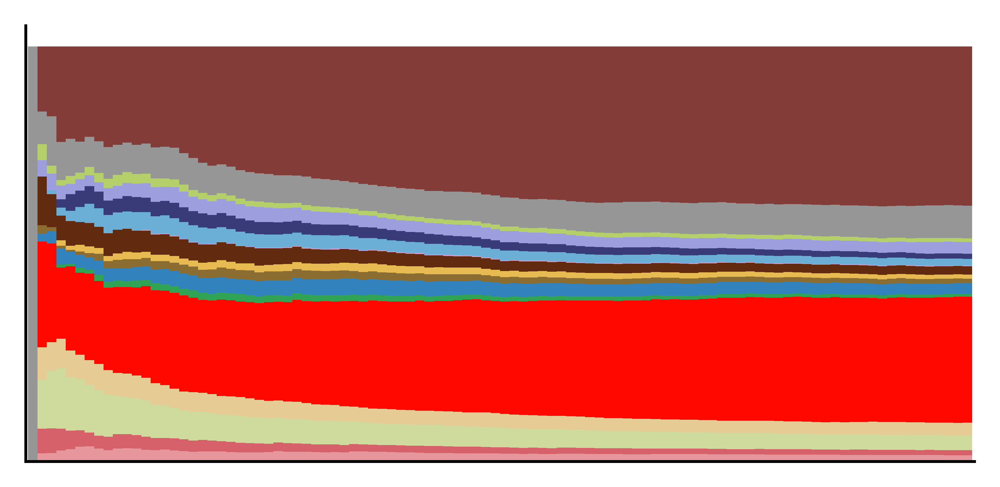

In [97]:
# Plot stacked bar plot
fig, ax = plt.subplots(figsize=(4,2), dpi=800)
plot_data.transpose().plot(kind='bar', width=1,color=[tissue_colors[keys] for keys in tissue_colors.keys()],
                                                          ax=ax,stacked=True)

# Customize the plot with labels, title, etc
ax.set_xlabel('Tissue Number')
plt.ylabel('Gene type')
plt.xticks(rotation=0)  # Rotates X-axis labels to show them horizontally
# Move the legend outside of the plot
# Remove the legend
ax.legend([], frameon=False)

#ax.legend(title='Gene type', bbox_to_anchor=(1.05, 1), loc='upper left')
# Add a horizontal dashed line at y=0.5

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
# Display the plot
plt.yticks([])
plt.xticks([])
plt.xlabel('')
plt.ylabel('')
plt.tight_layout()
plt.show()

### Heart

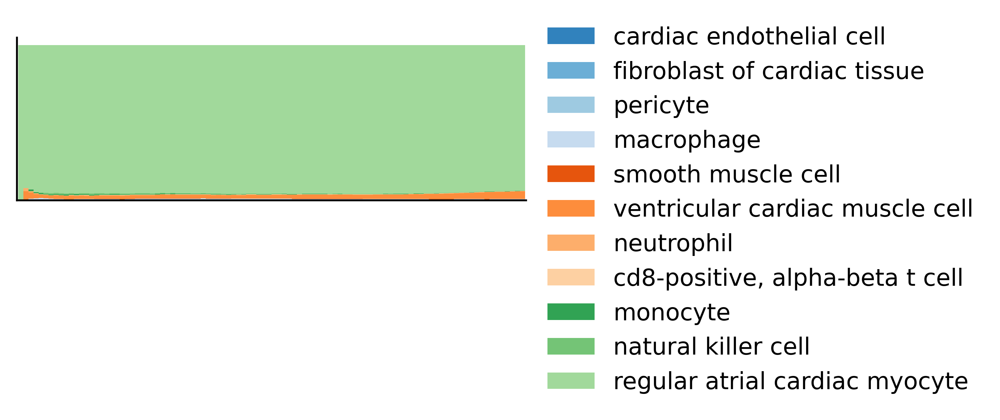

In [98]:
edgeR_cut = edgeR_LRT_all_coding[edgeR_LRT_all_coding['tissue']=='Heart']
ct_list = edgeR_cut['cell_type'].unique()
colors = sns.color_palette("tab20c", len(ct_list))

# List of Top N values to plot
top_n_list = np.linspace(1, 5e3, 100, dtype=int)
# Initialize a dictionary to hold data
plot_data = pd.DataFrame(index=ct_list)
# Sort the DataFrame once to optimize
sorted_df = edgeR_cut.sort_values(by='logFC', ascending=True)

# Aggregate data for each top_N
for top_n in top_n_list:
    top_entries = sorted_df.head(top_n)
    tissue_counts = top_entries['cell_type'].value_counts(normalize=True)
    plot_data[top_n] = tissue_counts
# Plot stacked bar plot

fig, ax = plt.subplots(figsize=(6,2), dpi=500)
plot_data.transpose().plot(kind='bar', width=1,color=colors,
                                                          ax=ax,stacked=True)

# Customize the plot with labels, title, etc
ax.set_xlabel('Tissue Number')
plt.ylabel('Gene type')
plt.xticks(rotation=0)  # Rotates X-axis labels to show them horizontally
# Move the legend outside of the plot
# Remove the legend
ax.legend(plot_data.index, frameon=False, bbox_to_anchor=(1,1.2))

#ax.legend(title='Gene type', bbox_to_anchor=(1.05, 1), loc='upper left')
# Add a horizontal dashed line at y=0.5

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
# Display the plot
plt.yticks([])
plt.xticks([])
plt.xlabel('')
plt.ylabel('')
plt.tight_layout()
plt.show()

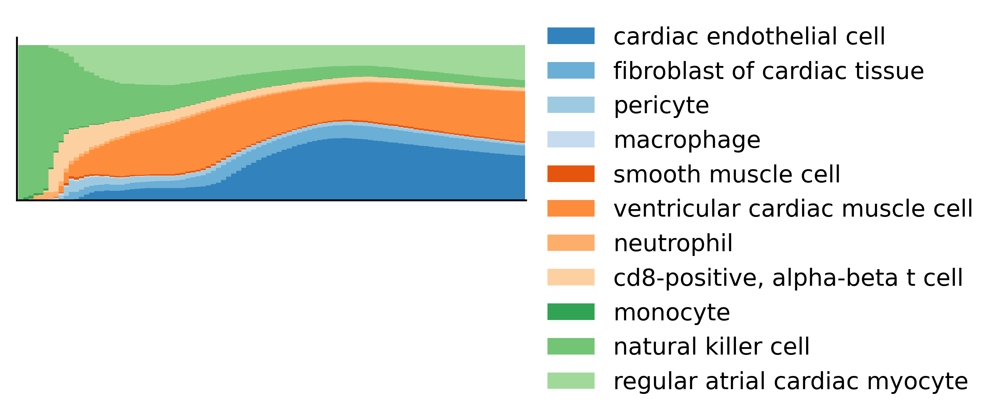

In [99]:
edgeR_cut = edgeR_LRT_all_coding[edgeR_LRT_all_coding['tissue']=='Heart']
ct_list = edgeR_cut['cell_type'].unique()
colors = sns.color_palette("tab20c", len(ct_list))

# List of Top N values to plot
top_n_list = np.linspace(1, 5e3, 100, dtype=int)
# Initialize a dictionary to hold data
plot_data = pd.DataFrame(index=ct_list)
# Sort the DataFrame once to optimize
sorted_df = edgeR_cut.sort_values(by='logFC', ascending=False)

# Aggregate data for each top_N
for top_n in top_n_list:
    top_entries = sorted_df.head(top_n)
    tissue_counts = top_entries['cell_type'].value_counts(normalize=True)
    plot_data[top_n] = tissue_counts
# Plot stacked bar plot

fig, ax = plt.subplots(figsize=(6,2), dpi=500)
plot_data.transpose().plot(kind='bar', width=1,color=colors,
                                                          ax=ax,stacked=True)

# Customize the plot with labels, title, etc
ax.set_xlabel('Tissue Number')
plt.ylabel('Gene type')
plt.xticks(rotation=0)  # Rotates X-axis labels to show them horizontally
# Move the legend outside of the plot
# Remove the legend
ax.legend(plot_data.index, frameon=False, bbox_to_anchor=(1,1.2))

#ax.legend(title='Gene type', bbox_to_anchor=(1.05, 1), loc='upper left')
# Add a horizontal dashed line at y=0.5

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
# Display the plot
plt.yticks([])
plt.xticks([])
plt.xlabel('')
plt.ylabel('')
plt.tight_layout()
plt.show()

### Lymph Node

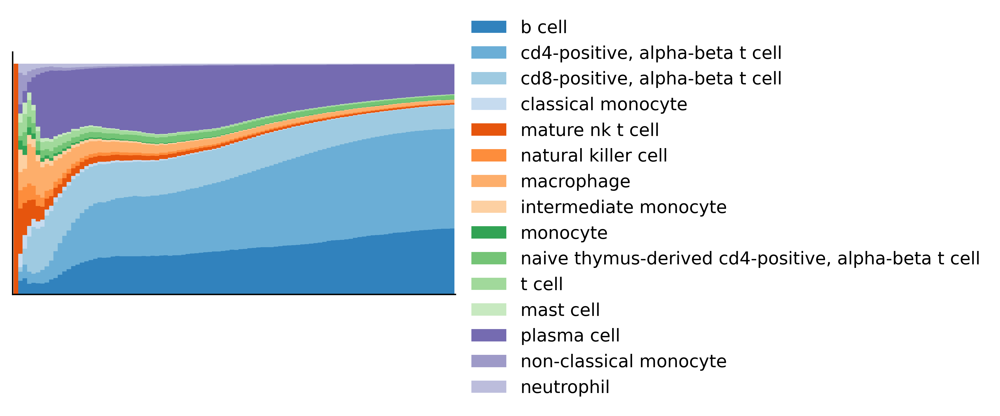

In [100]:
edgeR_cut = edgeR_LRT_all_coding[edgeR_LRT_all_coding['tissue']=='Lymph_Node']
ct_list = edgeR_cut['cell_type'].unique()
colors = sns.color_palette("tab20c", len(ct_list))

# List of Top N values to plot
top_n_list = np.linspace(1, 5e3, 100, dtype=int)
# Initialize a dictionary to hold data
plot_data = pd.DataFrame(index=ct_list)
# Sort the DataFrame once to optimize
sorted_df = edgeR_cut.sort_values(by='logFC', ascending=True)

# Aggregate data for each top_N
for top_n in top_n_list:
    top_entries = sorted_df.head(top_n)
    tissue_counts = top_entries['cell_type'].value_counts(normalize=True)
    plot_data[top_n] = tissue_counts
# Plot stacked bar plot

fig, ax = plt.subplots(figsize=(8,3), dpi=500)
plot_data.transpose().plot(kind='bar', width=1,color=colors,
                                                          ax=ax,stacked=True)

# Customize the plot with labels, title, etc
ax.set_xlabel('Tissue Number')
plt.ylabel('Gene type')
plt.xticks(rotation=0)  # Rotates X-axis labels to show them horizontally
# Move the legend outside of the plot
# Remove the legend
ax.legend(plot_data.index, frameon=False, bbox_to_anchor=(1,1.2))

#ax.legend(title='Gene type', bbox_to_anchor=(1.05, 1), loc='upper left')
# Add a horizontal dashed line at y=0.5

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
# Display the plot
plt.yticks([])
plt.xticks([])
plt.xlabel('')
plt.ylabel('')
plt.tight_layout()
plt.show()

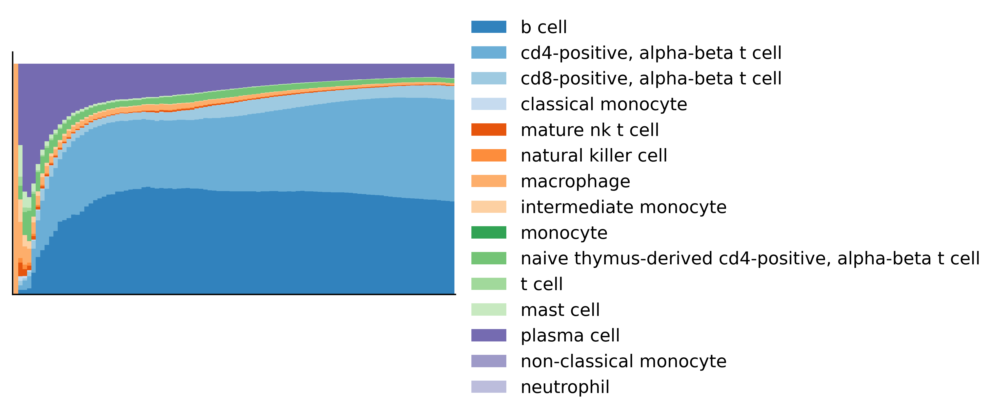

In [101]:
edgeR_cut = edgeR_LRT_all_coding[edgeR_LRT_all_coding['tissue']=='Lymph_Node']
ct_list = edgeR_cut['cell_type'].unique()
colors = sns.color_palette("tab20c", len(ct_list))

# List of Top N values to plot
top_n_list = np.linspace(1, 5e3, 100, dtype=int)
# Initialize a dictionary to hold data
plot_data = pd.DataFrame(index=ct_list)
# Sort the DataFrame once to optimize
sorted_df = edgeR_cut.sort_values(by='logFC', ascending=False)

# Aggregate data for each top_N
for top_n in top_n_list:
    top_entries = sorted_df.head(top_n)
    tissue_counts = top_entries['cell_type'].value_counts(normalize=True)
    plot_data[top_n] = tissue_counts
# Plot stacked bar plot

fig, ax = plt.subplots(figsize=(8,3), dpi=500)
plot_data.transpose().plot(kind='bar', width=1,color=colors,
                                                          ax=ax,stacked=True)

# Customize the plot with labels, title, etc
ax.set_xlabel('Tissue Number')
plt.ylabel('Gene type')
plt.xticks(rotation=0)  # Rotates X-axis labels to show them horizontally
# Move the legend outside of the plot
# Remove the legend
ax.legend(plot_data.index, frameon=False, bbox_to_anchor=(1,1.2))

#ax.legend(title='Gene type', bbox_to_anchor=(1.05, 1), loc='upper left')
# Add a horizontal dashed line at y=0.5

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
# Display the plot
plt.yticks([])
plt.xticks([])
plt.xlabel('')
plt.ylabel('')
plt.tight_layout()
plt.show()

### Fat

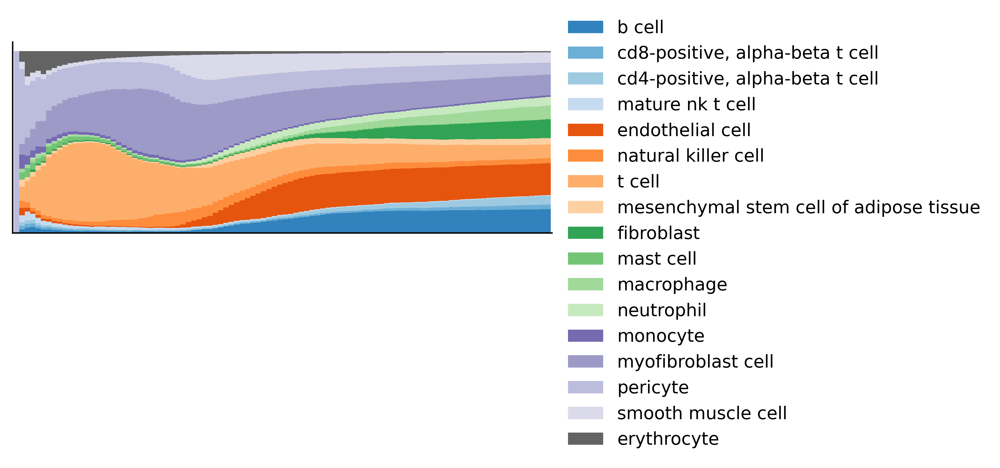

In [102]:
edgeR_cut = edgeR_LRT_all_coding[edgeR_LRT_all_coding['tissue']=='Fat']
ct_list = edgeR_cut['cell_type'].unique()
colors = sns.color_palette("tab20c", len(ct_list))

# List of Top N values to plot
top_n_list = np.linspace(1, 5e3, 100, dtype=int)
# Initialize a dictionary to hold data
plot_data = pd.DataFrame(index=ct_list)
# Sort the DataFrame once to optimize
sorted_df = edgeR_cut.sort_values(by='logFC', ascending=True)

# Aggregate data for each top_N
for top_n in top_n_list:
    top_entries = sorted_df.head(top_n)
    tissue_counts = top_entries['cell_type'].value_counts(normalize=True)
    plot_data[top_n] = tissue_counts
# Plot stacked bar plot

fig, ax = plt.subplots(figsize=(8,3), dpi=500)
plot_data.transpose().plot(kind='bar', width=1,color=colors,
                                                          ax=ax,stacked=True)

# Customize the plot with labels, title, etc
ax.set_xlabel('Tissue Number')
plt.ylabel('Gene type')
plt.xticks(rotation=0)  # Rotates X-axis labels to show them horizontally
# Move the legend outside of the plot
# Remove the legend
ax.legend(plot_data.index, frameon=False, bbox_to_anchor=(1,1.2))

#ax.legend(title='Gene type', bbox_to_anchor=(1.05, 1), loc='upper left')
# Add a horizontal dashed line at y=0.5

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
# Display the plot
plt.yticks([])
plt.xticks([])
plt.xlabel('')
plt.ylabel('')
plt.tight_layout()
plt.show()

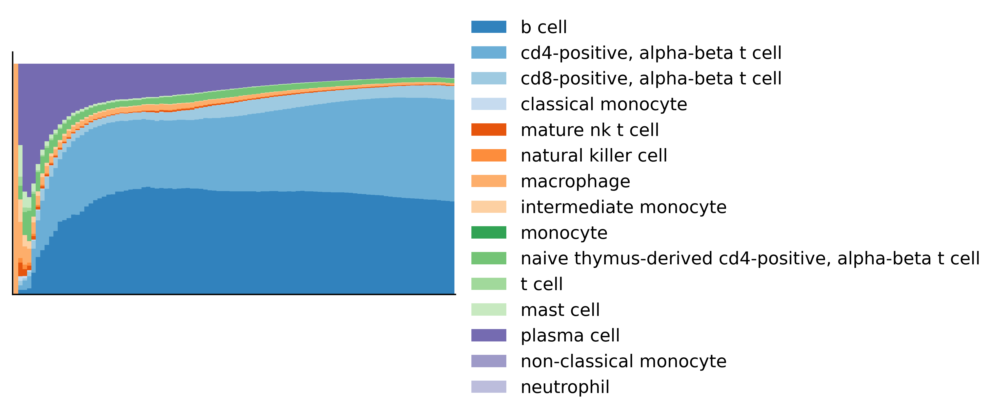

In [101]:
edgeR_cut = edgeR_LRT_all_coding[edgeR_LRT_all_coding['tissue']=='Lymph_Node']
ct_list = edgeR_cut['cell_type'].unique()
colors = sns.color_palette("tab20c", len(ct_list))

# List of Top N values to plot
top_n_list = np.linspace(1, 5e3, 100, dtype=int)
# Initialize a dictionary to hold data
plot_data = pd.DataFrame(index=ct_list)
# Sort the DataFrame once to optimize
sorted_df = edgeR_cut.sort_values(by='logFC', ascending=False)

# Aggregate data for each top_N
for top_n in top_n_list:
    top_entries = sorted_df.head(top_n)
    tissue_counts = top_entries['cell_type'].value_counts(normalize=True)
    plot_data[top_n] = tissue_counts
# Plot stacked bar plot

fig, ax = plt.subplots(figsize=(8,3), dpi=500)
plot_data.transpose().plot(kind='bar', width=1,color=colors,
                                                          ax=ax,stacked=True)

# Customize the plot with labels, title, etc
ax.set_xlabel('Tissue Number')
plt.ylabel('Gene type')
plt.xticks(rotation=0)  # Rotates X-axis labels to show them horizontally
# Move the legend outside of the plot
# Remove the legend
ax.legend(plot_data.index, frameon=False, bbox_to_anchor=(1,1.2))

#ax.legend(title='Gene type', bbox_to_anchor=(1.05, 1), loc='upper left')
# Add a horizontal dashed line at y=0.5

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
# Display the plot
plt.yticks([])
plt.xticks([])
plt.xlabel('')
plt.ylabel('')
plt.tight_layout()
plt.show()

In [201]:
edgeR_LRT_all_coding['cell_type'].unique().shape

(84,)

In [ ]:
edgeR_LRT_all_coding

In [205]:
library='GO_Biological_Process_2023'
enr_df_all = pd.DataFrame()
for tissue in edgeR_LRT_all_coding['cell_type'].unique():
        print(tissue,'...')
        TS_data_df_coding_tissue = edgeR_LRT_all_coding[(edgeR_LRT_all_coding['cell_type']==tissue)  & (edgeR_LRT_all_coding['logFC']>0)]
        if TS_data_df_coding_tissue.shape[0]>0:
            try: 
                enr1 = gp.enrichr(gene_list=list(TS_data_df_coding_tissue['gene_symbol'].unique()),
                        organism='Human',
                        gene_sets=library,  
                        outdir=None,  
                 )
                enr1_df = enr1.results
                enr1_df = enr1_df[enr1_df['Adjusted P-value']<0.05]
                enr1_df['tissue']=tissue
                
                enr1_df['F_M']='F'
            except Exception as e:
                print(f"An error occurred during enrichment: {e}")
                enr1_df = pd.DataFrame()
        else:
            enr1_df = pd.DataFrame()
            ""
        TS_data_df_coding_tissue = edgeR_LRT_all_coding[(edgeR_LRT_all_coding['cell_type']==tissue) & (edgeR_LRT_all_coding['logFC']<0)]
        if TS_data_df_coding_tissue.shape[0]>0:
            try: 
                enr2 = gp.enrichr(gene_list=list(TS_data_df_coding_tissue['gene_symbol'].unique()),
                        organism='Human',
                        gene_sets=library,  # Currently selected library
                        outdir=None,  # If you want to save the results, provide a directory path
                 )
                enr2_df = enr2.results
                enr2_df = enr2_df[enr2_df['Adjusted P-value']<0.05]
                enr2_df['tissue']=tissue
                
                enr2_df['F_M']='M'
            except Exception as e:
                print(f"An error occurred during enrichment: {e}")
                enr2_df = pd.DataFrame()
        else:
            enr2_df = pd.DataFrame()
        enr_df =pd.concat([enr1_df,enr2_df],axis=0)
        enr_df_all = pd.concat([enr_df_all,enr_df],axis=0)
        break

fibroblast ...


/tmp/ipykernel_2469207/3268410138.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_2469207/3268410138.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykernel_2469207/3268410138.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/tmp/ipykerne

In [206]:
enr_df_all

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes,tissue,F_M
0,GO_Biological_Process_2023,Positive Regulation Of MAPK Cascade (GO:0043410),67/310,9.442690e-09,0.000042,0,0,2.369957,43.792129,CD81;WWC1;ETFA;PTPN22;TNF;CX3CL1;PIK3CG;GHR;MY...,fibroblast,F
1,GO_Biological_Process_2023,Antigen Receptor-Mediated Signaling Pathway (G...,37/134,3.042443e-08,0.000067,0,0,3.258207,56.393117,BLK;ITK;TXK;CD3G;PTPN22;THY1;CD3E;CD3D;CD79B;C...,fibroblast,F
2,GO_Biological_Process_2023,Granulocyte Chemotaxis (GO:0071621),25/73,5.381243e-08,0.000079,0,0,4.435540,74.241010,CCL14;CXCL9;CXCL8;CCL3L1;ITGB2;CXCL13;CX3CL1;P...,fibroblast,F
3,GO_Biological_Process_2023,Neutrophil Chemotaxis (GO:0030593),24/70,9.651448e-08,0.000098,0,0,4.441631,71.748213,CCL14;CXCL9;EDN1;TGFB2;CXCL8;CXADR;FCER1G;CCL3...,fibroblast,F
4,GO_Biological_Process_2023,Positive Regulation Of T Cell Activation (GO:0...,31/107,1.194545e-07,0.000098,0,0,3.478240,55.444298,TFRC;CD81;SIRPG;THY1;TNFRSF13C;CD3E;ACTB;SIRPB...,fibroblast,F
...,...,...,...,...,...,...,...,...,...,...,...,...
230,GO_Biological_Process_2023,Negative Regulation Of Cysteine-Type Endopepti...,19/53,2.225043e-03,0.048315,0,0,2.457100,15.007915,IGBP1;USP47;ARL6IP1;SIAH2;DHCR24;KLF4;THBS1;CS...,fibroblast,M
231,GO_Biological_Process_2023,Positive Regulation Of Blood Coagulation (GO:0...,10/21,2.288791e-03,0.049397,0,0,3.993130,24.277156,PLAU;F12;F2R;SERPINE1;ST3GAL4;EMILIN2;PLAT;EMI...,fibroblast,M
232,GO_Biological_Process_2023,Positive Regulation Of MAPK Cascade (GO:0043410),78/310,2.294565e-03,0.049397,0,0,1.483951,9.018284,APP;CD40;CD81;LRRK2;HTR2C;PTPRJ;ETFA;FGF2;CRKL...,fibroblast,M
233,GO_Biological_Process_2023,Chemokine-Mediated Signaling Pathway (GO:0070098),20/57,2.316917e-03,0.049454,0,0,2.376915,14.421978,CXCL6;CCL13;CCL24;FOXC1;CCL23;CXCL8;CCL11;CCL3...,fibroblast,M


In [ ]:
enr_df_all.to_csv('/hpc/mydata/siyu.he/TS_project/enr_df_all_BP.csv')

## correlation map

In [ ]:
# cell & tissue
all_chrX_exp = pd.DataFrame()
chrX_genes_list = edgeR_LRT_all['gene_symbol'].unique() 

for tissue_ in sorted(edgeR_LRT_all['tissue'].unique()):
    for type_ in sorted(edgeR_LRT_all['cell_type'].unique()):
        adata_tissue_ct_path = '/hpc/mydata/siyu.he/data/TSP1_30_decontx_scvi_donorassay_april252023_'+tissue_.replace(' ', '_')+'_'+type_.replace(' ', '_')+'.h5ad'
        if os.path.exists(adata_tissue_ct_path):
            adata_tissue_ct = sc.read_h5ad('/hpc/mydata/siyu.he/data/TSP1_30_decontx_scvi_donorassay_april252023_'+tissue_.replace(' ', '_')+'_'+type_.replace(' ', '_')+'.h5ad')
            adata_tissue_ct = adata_tissue_ct[:,np.intersect1d(chrX_genes_list,adata_tissue_ct.var_names)].copy().X.toarray().mean(axis=0)
            all_chrX_exp[tissue_+'_'+type_] = adata_tissue_ct